## 1. Set GPU & Import

In [1]:
import torch
print(torch.cuda.is_available())
print(torch.cuda.get_device_name(0))
print(torch.cuda.device_count())

True
NVIDIA GeForce RTX 3090
1


In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2
from sklearn.metrics import accuracy_score, make_scorer, roc_curve, roc_auc_score
from tqdm.notebook import tqdm
from PIL import Image, ImageFont, ImageDraw

import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision.utils as utils
import torchvision.datasets as dsets
import torchvision.transforms as transforms
from torchvision import datasets, models
from torchvision.datasets import ImageFolder
from torchvision.utils import make_grid,save_image
from torch.utils.data import DataLoader, ConcatDataset
from torchvision.transforms.functional import to_pil_image

%matplotlib inline

In [3]:
use_cuda = torch.cuda.is_available()
#use_cuda = False
device = torch.device("cuda" if use_cuda else "cpu")
device

device(type='cuda')

## 2. Data load & pre-processing

In [4]:
dataset_path = 'C:/Users/232STG21/Documents/EEG/raw data'
print('> Label Informations < ')
print(os.listdir(dataset_path))

> Label Informations < 
['0.Healthy controls', '1.Bipolar disorder', '2.Major depressive disorder', '3.Schizophrenia']


In [5]:
# tensorflow, 28*28로 resize, normalization
from torchvision.transforms import transforms

transformer = transforms.Compose([
                        transforms.ToTensor(),
                        transforms.Resize((28,28)),
                        transforms.Normalize([0.5],[0.5])

])

target_dataset = ImageFolder(dataset_path, transform=transformer)

In [6]:
# data loader
from torch.utils.data.sampler import SubsetRandomSampler

batch_size = 64 # => gan에서 사용되는 batch size로 64로 지정함
validation_split = .2  # 비율을 얼마로 줄것인지?
shuffle_dataset = True
random_seed= 42

# training, test 분할을 위한 인덱스 생성
dataset_size = len(target_dataset)
indices = list(range(dataset_size))
split = int(np.floor(validation_split * dataset_size))


if shuffle_dataset :
    np.random.seed(random_seed)
    np.random.shuffle(indices)

train_indices, val_indices = indices[split:], indices[:split]

train_sampler = SubsetRandomSampler(train_indices)
valid_sampler = SubsetRandomSampler(val_indices)

train_loader = torch.utils.data.DataLoader(target_dataset, batch_size=64, sampler=train_sampler) #train/test split 후 => train loader 데이터 셋만 이미지 생성 train loader에서 batchsize 설정
test_loader = torch.utils.data.DataLoader(target_dataset, batch_size=1,sampler=valid_sampler)

In [7]:
for idx, (img, label) in enumerate(train_loader):

    print(idx)
    print(img.shape)
    print(label)

    #break

C:\Users\232STG21\AppData\Local\anaconda3\envs\EEG\lib\site-packages\torchvision\transforms\functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


0
torch.Size([64, 3, 28, 28])
tensor([2, 2, 3, 3, 1, 2, 2, 2, 2, 1, 3, 2, 2, 0, 3, 2, 3, 0, 1, 2, 2, 2, 2, 2,
        1, 0, 3, 0, 2, 2, 1, 2, 2, 1, 2, 1, 3, 2, 1, 2, 0, 2, 2, 0, 0, 2, 3, 2,
        2, 3, 3, 3, 3, 3, 0, 2, 2, 1, 0, 3, 2, 2, 3, 2])
1
torch.Size([64, 3, 28, 28])
tensor([1, 2, 0, 1, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 0, 1, 3, 2, 3, 3, 0, 0, 3, 0,
        2, 3, 3, 2, 2, 0, 0, 0, 2, 1, 3, 2, 2, 2, 2, 0, 3, 2, 3, 3, 3, 1, 1, 2,
        3, 0, 2, 1, 2, 3, 0, 0, 3, 2, 0, 0, 2, 0, 2, 2])
2
torch.Size([64, 3, 28, 28])
tensor([2, 1, 3, 1, 2, 3, 3, 0, 3, 2, 1, 1, 2, 2, 2, 3, 2, 2, 2, 1, 1, 2, 2, 1,
        2, 2, 1, 3, 2, 0, 0, 3, 2, 2, 3, 2, 0, 0, 3, 2, 2, 1, 1, 3, 2, 2, 1, 2,
        2, 2, 1, 0, 2, 3, 2, 3, 0, 2, 2, 0, 2, 3, 3, 3])
3
torch.Size([64, 3, 28, 28])
tensor([2, 2, 2, 1, 0, 2, 1, 2, 3, 3, 2, 3, 2, 3, 3, 2, 2, 0, 0, 3, 2, 2, 3, 0,
        1, 0, 3, 2, 3, 3, 3, 2, 0, 2, 0, 1, 2, 2, 3, 1, 2, 3, 3, 2, 2, 2, 2, 2,
        3, 0, 1, 2, 0, 2, 0, 2, 3, 2, 1, 2, 2, 2, 2, 3])
4
torch.Size

## 3. Modeling

In [8]:
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

torch.manual_seed(random_seed)

In [9]:
def custom_imshow(img):
    img = img.numpy()
    plt.imshow(np.transpose(img, (1, 2, 0)))
    plt.show()

In [10]:
def process():
    for batch_idx, (img, label) in enumerate(train_loader):
        custom_imshow(img[1])
        print(label)

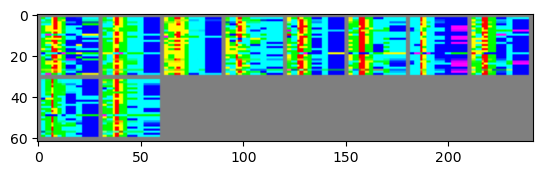

In [11]:
def imshow(img):
    img = (img+1)/2
    img = img.squeeze()
    np_img = img.numpy()
    plt.imshow(np_img)
    plt.show()

def imshow_grid(img):
    img = utils.make_grid(img.cpu().detach())
    img = (img+1)/2
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)))
    plt.grid(False)
    plt.show()

example_mini_batch_img, example_mini_batch_label  = next(iter(train_loader))
imshow_grid(example_mini_batch_img[0:10,:,:])

In [12]:
class Generator(nn.Module):

    def __init__(self, z_dim=2, im_chan=3, hidden_dim=64):
        super(Generator, self).__init__()

        self.z_dim = z_dim

        self.gen = nn.Sequential(

            self.get_generator_block(z_dim,
                                     hidden_dim * 4,
                                     kernel_size=3,
                                     stride=2),

            self.get_generator_block(hidden_dim * 4,
                                     hidden_dim * 2,
                                     kernel_size=4,
                                     stride = 1),

            self.get_generator_block(hidden_dim * 2,
                                     hidden_dim ,
                                     kernel_size=3,
                                     stride = 2,
                                    ),

            self.get_generator_final_block(hidden_dim,
                                           im_chan,
                                           kernel_size=4,
                                           stride=2)


        )
    def get_generator_block(self, input_channel, output_channel, kernel_size, stride = 1, padding = 0):
        return nn.Sequential(
                nn.ConvTranspose2d(input_channel, output_channel, kernel_size, stride, padding),
                nn.BatchNorm2d(output_channel),
                nn.ReLU(inplace=True),
        )


    def get_generator_final_block(self, input_channel, output_channel, kernel_size, stride = 1, padding = 0):
        return  nn.Sequential(
                nn.ConvTranspose2d(input_channel, output_channel, kernel_size, stride, padding),
                nn.Tanh()
            )

    def forward(self, noise):
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

In [13]:
class Discriminator(nn.Module):

    def __init__(self, im_chan=3, hidden_dim=16):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.get_critic_block(im_chan,
                                         hidden_dim * 4,
                                         kernel_size=4,
                                         stride=2),

            self.get_critic_block(hidden_dim * 4,
                                         hidden_dim * 8,
                                         kernel_size=4,
                                         stride=2,),
            self.get_critic_final_block(hidden_dim * 8,
                                               1,
                                               kernel_size=4,
                                               stride=2,),

        )


    def get_critic_block(self, input_channel, output_channel, kernel_size, stride = 1, padding = 0):
        return nn.Sequential(
                nn.Conv2d(input_channel, output_channel, kernel_size, stride, padding),
                nn.BatchNorm2d(output_channel),
                nn.LeakyReLU(0.2, inplace=True)
        )


    def get_critic_final_block(self, input_channel, output_channel, kernel_size, stride = 1, padding = 0):
        return  nn.Sequential(
                nn.Conv2d(input_channel, output_channel, kernel_size, stride, padding),
            )

    def forward(self, image):
        return self.disc(image)

In [14]:
mnist_shape = (3, 28,28)
n_classes = 4
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan =  mnist_shape[0] + n_classes
    return generator_input_dim, discriminator_im_chan

In [15]:
z_dim = 4 #class

In [16]:
lr = 3e-4
beta_1 = 0.5
beta_2 = 0.999

generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

criterion = nn.BCEWithLogitsLoss()

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

In [17]:
gen = Generator(z_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2), weight_decay=0.1)
gen = gen.apply(weights_init)

disc  = Discriminator(im_chan = discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr, betas=(beta_1, beta_2))
disc = disc.apply(weights_init)

In [18]:
# 가중치 저장
path2models = 'C:/Users/232STG21/Documents/EEG/cDCGAN_50/models'
os.makedirs(path2models, exist_ok=True)
path2weights_gen = os.path.join(path2models, 'weights_gen64.pt')
path2weights_dis = os.path.join(path2models, 'weights_dis64.pt')

torch.save(gen.state_dict(), path2weights_gen)
torch.save(disc.state_dict(), path2weights_dis)

In [19]:
def get_one_hot_labels(labels, n_classes):
    return F.one_hot(labels,n_classes)

def combine_vectors(x, y):
    combined = torch.cat((x.float(),y.float()) , 1)
    return combined

In [20]:
def show_tensor_images(image_tensor, num_images=25, size=(1, 28,28), nrow=5, show_fig=False, epoch=0):
    image_unflat = image_tensor.detach().cpu().view(-1, *size)
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.axis('off')

    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.imshow(image_grid, vmin=0, vmax=255)
    if show_fig:
        plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))

    plt.show()

In [21]:
def imshow_grid(img, num_images=25, size=(3, 28,28), nrow=5, show_fig=False, epoch=0):
    img = utils.make_grid(img.cpu().detach())
    img = (img+1)/2
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)))
    plt.show()

In [22]:
n_epochs = 1000
cur_step =10
total_steps = 0
cur_step = 10

D_mean_losses = []
G_mean_losses = []

generator_losses = []
discriminator_losses = []

noise_and_labels = False
fake = False
display_step = 5
fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

In [23]:
def get_noise(n_samples, z_dim, device='cpu'):
    return torch.randn(n_samples,z_dim,device=device)

In [24]:
fixed_one_hot_labels = get_one_hot_labels(torch.tensor([0,1,2,3]).to(device), n_classes)
fixed_noise = get_noise(4, z_dim, device=device)
fixed_noise_and_labels = combine_vectors(fixed_noise, fixed_one_hot_labels)

In [25]:
# For checking CGAN's validity in final step
def check_condition(_generator):
    test_image = torch.empty(0).to(device)

    for i in range(4):
        test_label = torch.tensor([0,1,2,3])
        test_label_encoded = F.one_hot(test_label, num_classes=2).to(device)

        # create noise(latent vector) 'z'
        _z = torch.randn(4, noise_size).to(device)
        _z_concat = torch.cat((_z, test_label_encoded), 1)

        test_image = torch.cat((test_image, _generator(_z_concat)), 0)

    _result = test_image.reshape(100, 3, 28, 28)
    save_image(_result, os.path.join(dir_name, 'CGAN_test_result.png'), nrow=2)

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 0/1000 Total Steps:5	Loss_D : 0.669472	Loss_G : 0.696098	Loss_D_Mean : 0.680718	Loss_G_Mean : 0.693742	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1/1000 Total Steps:10	Loss_D : 0.642507	Loss_G : 0.700879	Loss_D_Mean : 0.653382	Loss_G_Mean : 0.699137	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 2/1000 Total Steps:15	Loss_D : 0.615054	Loss_G : 0.709201	Loss_D_Mean : 0.625643	Loss_G_Mean : 0.705983	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 3/1000 Total Steps:20	Loss_D : 0.583551	Loss_G : 0.719664	Loss_D_Mean : 0.596323	Loss_G_Mean : 0.714964	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 4/1000 Total Steps:25	Loss_D : 0.551886	Loss_G : 0.735067	Loss_D_Mean : 0.564800	Loss_G_Mean : 0.728553	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 5/1000 Total Steps:30	Loss_D : 0.520782	Loss_G : 0.756116	Loss_D_Mean : 0.532272	Loss_G_Mean : 0.747160	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 6/1000 Total Steps:35	Loss_D : 0.483971	Loss_G : 0.784287	Loss_D_Mean : 0.499719	Loss_G_Mean : 0.771768	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 7/1000 Total Steps:40	Loss_D : 0.460939	Loss_G : 0.818600	Loss_D_Mean : 0.467799	Loss_G_Mean : 0.804202	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 8/1000 Total Steps:45	Loss_D : 0.421700	Loss_G : 0.861547	Loss_D_Mean : 0.435317	Loss_G_Mean : 0.844945	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 9/1000 Total Steps:50	Loss_D : 0.388742	Loss_G : 0.914850	Loss_D_Mean : 0.404598	Loss_G_Mean : 0.892716	
Epoch: 10


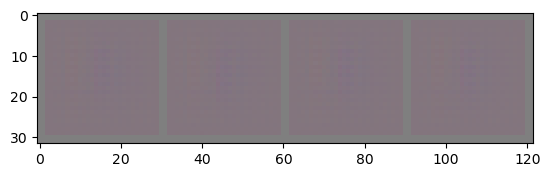

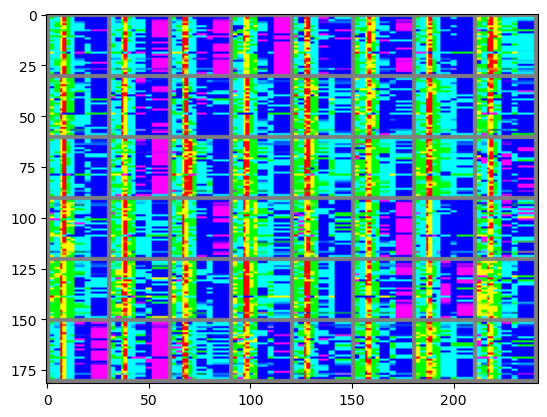

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 10/1000 Total Steps:55	Loss_D : 0.361002	Loss_G : 0.979102	Loss_D_Mean : 0.373862	Loss_G_Mean : 0.951731	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 11/1000 Total Steps:60	Loss_D : 0.328923	Loss_G : 1.054146	Loss_D_Mean : 0.342601	Loss_G_Mean : 1.024327	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 12/1000 Total Steps:65	Loss_D : 0.299977	Loss_G : 1.137491	Loss_D_Mean : 0.310153	Loss_G_Mean : 1.105228	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 13/1000 Total Steps:70	Loss_D : 0.284525	Loss_G : 1.213346	Loss_D_Mean : 0.282880	Loss_G_Mean : 1.186436	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 14/1000 Total Steps:75	Loss_D : 0.245687	Loss_G : 1.315930	Loss_D_Mean : 0.254465	Loss_G_Mean : 1.278440	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 15/1000 Total Steps:80	Loss_D : 0.216801	Loss_G : 1.409504	Loss_D_Mean : 0.228790	Loss_G_Mean : 1.367548	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 16/1000 Total Steps:85	Loss_D : 0.197717	Loss_G : 1.498458	Loss_D_Mean : 0.207239	Loss_G_Mean : 1.457217	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 17/1000 Total Steps:90	Loss_D : 0.187679	Loss_G : 1.552975	Loss_D_Mean : 0.188673	Loss_G_Mean : 1.549358	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 18/1000 Total Steps:95	Loss_D : 0.162489	Loss_G : 1.688863	Loss_D_Mean : 0.169907	Loss_G_Mean : 1.657828	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 19/1000 Total Steps:100	Loss_D : 0.146702	Loss_G : 1.785167	Loss_D_Mean : 0.154792	Loss_G_Mean : 1.748240	
Epoch: 20


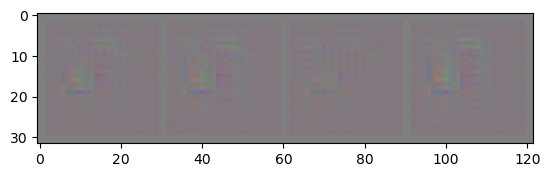

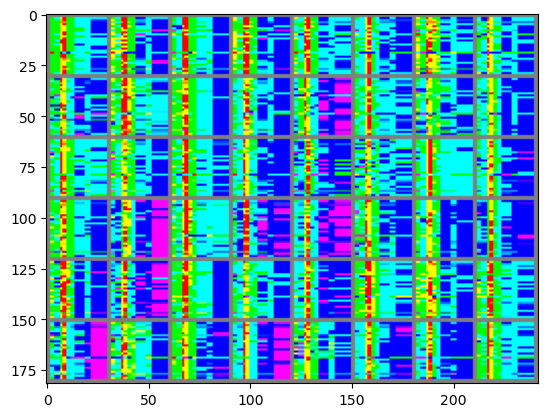

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 20/1000 Total Steps:105	Loss_D : 0.135068	Loss_G : 1.896241	Loss_D_Mean : 0.139074	Loss_G_Mean : 1.851984	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 21/1000 Total Steps:110	Loss_D : 0.123928	Loss_G : 1.980722	Loss_D_Mean : 0.125237	Loss_G_Mean : 1.949590	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 22/1000 Total Steps:115	Loss_D : 0.117041	Loss_G : 2.014554	Loss_D_Mean : 0.115161	Loss_G_Mean : 2.037219	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 23/1000 Total Steps:120	Loss_D : 0.095477	Loss_G : 2.209406	Loss_D_Mean : 0.102928	Loss_G_Mean : 2.159178	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 24/1000 Total Steps:125	Loss_D : 0.091931	Loss_G : 2.244905	Loss_D_Mean : 0.094438	Loss_G_Mean : 2.243127	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 25/1000 Total Steps:130	Loss_D : 0.083860	Loss_G : 2.425210	Loss_D_Mean : 0.086605	Loss_G_Mean : 2.337672	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 26/1000 Total Steps:135	Loss_D : 0.080939	Loss_G : 2.486519	Loss_D_Mean : 0.080230	Loss_G_Mean : 2.467120	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 27/1000 Total Steps:140	Loss_D : 0.066692	Loss_G : 2.537131	Loss_D_Mean : 0.071876	Loss_G_Mean : 2.505855	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 28/1000 Total Steps:145	Loss_D : 0.063830	Loss_G : 2.597019	Loss_D_Mean : 0.066144	Loss_G_Mean : 2.571929	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 29/1000 Total Steps:150	Loss_D : 0.061460	Loss_G : 2.658727	Loss_D_Mean : 0.061156	Loss_G_Mean : 2.644920	
Epoch: 30


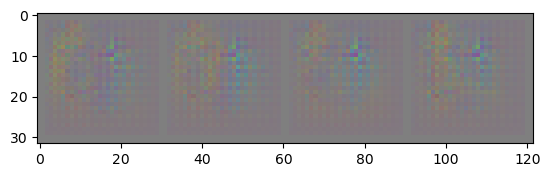

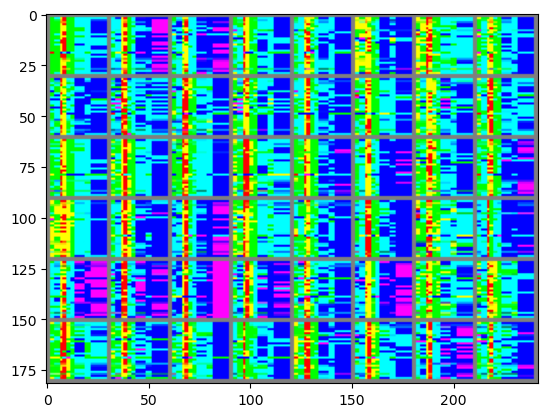

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 30/1000 Total Steps:155	Loss_D : 0.055597	Loss_G : 2.815729	Loss_D_Mean : 0.058307	Loss_G_Mean : 2.759468	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 31/1000 Total Steps:160	Loss_D : 0.055244	Loss_G : 2.797665	Loss_D_Mean : 0.055894	Loss_G_Mean : 2.814291	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 32/1000 Total Steps:165	Loss_D : 0.045220	Loss_G : 2.943360	Loss_D_Mean : 0.049950	Loss_G_Mean : 2.906176	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 33/1000 Total Steps:170	Loss_D : 0.054173	Loss_G : 2.915299	Loss_D_Mean : 0.049567	Loss_G_Mean : 2.923690	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 34/1000 Total Steps:175	Loss_D : 0.051979	Loss_G : 2.939226	Loss_D_Mean : 0.050661	Loss_G_Mean : 2.942124	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 35/1000 Total Steps:180	Loss_D : 0.043322	Loss_G : 3.123854	Loss_D_Mean : 0.047958	Loss_G_Mean : 3.063701	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 36/1000 Total Steps:185	Loss_D : 0.045876	Loss_G : 3.234040	Loss_D_Mean : 0.044476	Loss_G_Mean : 3.187441	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 37/1000 Total Steps:190	Loss_D : 0.042687	Loss_G : 3.187588	Loss_D_Mean : 0.040337	Loss_G_Mean : 3.256115	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 38/1000 Total Steps:195	Loss_D : 0.037762	Loss_G : 3.215776	Loss_D_Mean : 0.042232	Loss_G_Mean : 3.196644	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 39/1000 Total Steps:200	Loss_D : 0.037269	Loss_G : 3.392673	Loss_D_Mean : 0.038847	Loss_G_Mean : 3.270864	
Epoch: 40


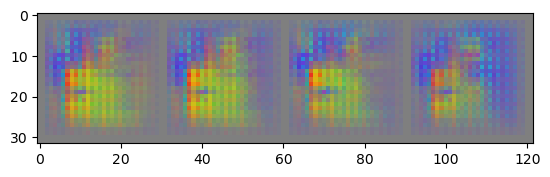

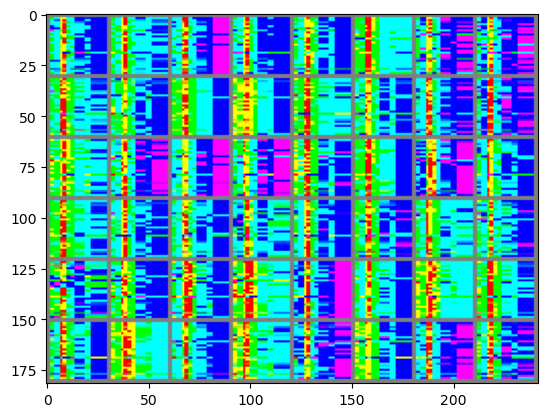

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 40/1000 Total Steps:205	Loss_D : 0.042754	Loss_G : 3.400677	Loss_D_Mean : 0.037921	Loss_G_Mean : 3.377414	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 41/1000 Total Steps:210	Loss_D : 0.035005	Loss_G : 3.524982	Loss_D_Mean : 0.034637	Loss_G_Mean : 3.482345	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 42/1000 Total Steps:215	Loss_D : 0.035740	Loss_G : 3.636087	Loss_D_Mean : 0.033513	Loss_G_Mean : 3.606472	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 43/1000 Total Steps:220	Loss_D : 0.043352	Loss_G : 3.631760	Loss_D_Mean : 0.053605	Loss_G_Mean : 3.548873	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 44/1000 Total Steps:225	Loss_D : 0.041174	Loss_G : 3.484343	Loss_D_Mean : 0.041657	Loss_G_Mean : 3.501147	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 45/1000 Total Steps:230	Loss_D : 0.494808	Loss_G : 4.243919	Loss_D_Mean : 0.149731	Loss_G_Mean : 3.508387	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 46/1000 Total Steps:235	Loss_D : 0.239800	Loss_G : 1.849054	Loss_D_Mean : 0.322914	Loss_G_Mean : 2.243925	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 47/1000 Total Steps:240	Loss_D : 0.110225	Loss_G : 2.776462	Loss_D_Mean : 0.172538	Loss_G_Mean : 2.552024	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 48/1000 Total Steps:245	Loss_D : 0.055448	Loss_G : 3.550994	Loss_D_Mean : 0.079853	Loss_G_Mean : 3.210298	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 49/1000 Total Steps:250	Loss_D : 0.370480	Loss_G : 2.780307	Loss_D_Mean : 0.362609	Loss_G_Mean : 2.440090	
Epoch: 50


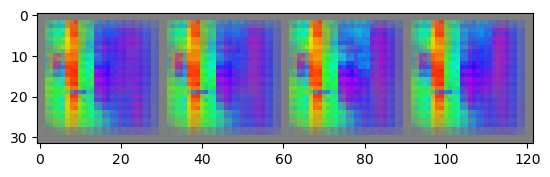

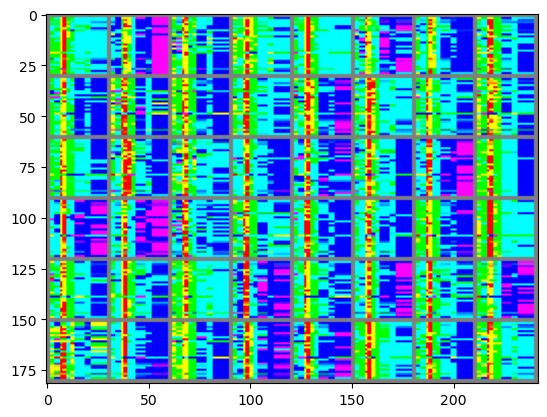

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 50/1000 Total Steps:255	Loss_D : 0.166883	Loss_G : 2.562920	Loss_D_Mean : 0.229872	Loss_G_Mean : 2.335256	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 51/1000 Total Steps:260	Loss_D : 0.155235	Loss_G : 2.815219	Loss_D_Mean : 0.133468	Loss_G_Mean : 2.839868	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 52/1000 Total Steps:265	Loss_D : 0.082286	Loss_G : 3.298264	Loss_D_Mean : 0.106076	Loss_G_Mean : 3.151855	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 53/1000 Total Steps:270	Loss_D : 0.123247	Loss_G : 4.325813	Loss_D_Mean : 0.136086	Loss_G_Mean : 3.324372	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 54/1000 Total Steps:275	Loss_D : 0.096709	Loss_G : 3.011128	Loss_D_Mean : 0.099317	Loss_G_Mean : 3.235271	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 55/1000 Total Steps:280	Loss_D : 0.093775	Loss_G : 3.071947	Loss_D_Mean : 0.084924	Loss_G_Mean : 3.256845	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 56/1000 Total Steps:285	Loss_D : 0.065436	Loss_G : 3.099666	Loss_D_Mean : 0.070465	Loss_G_Mean : 3.001101	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 57/1000 Total Steps:290	Loss_D : 0.060137	Loss_G : 3.048985	Loss_D_Mean : 0.055620	Loss_G_Mean : 3.216380	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 58/1000 Total Steps:295	Loss_D : 0.065636	Loss_G : 2.881603	Loss_D_Mean : 0.066385	Loss_G_Mean : 2.999439	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 59/1000 Total Steps:300	Loss_D : 0.087538	Loss_G : 2.825649	Loss_D_Mean : 0.076808	Loss_G_Mean : 2.822722	
Epoch: 60


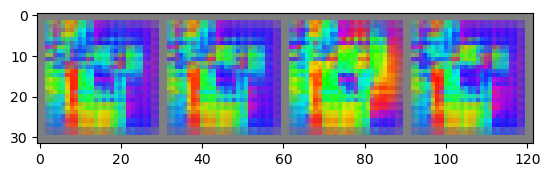

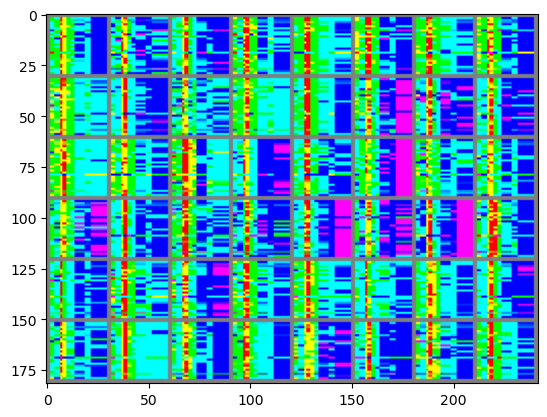

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 60/1000 Total Steps:305	Loss_D : 0.054373	Loss_G : 3.143900	Loss_D_Mean : 0.064942	Loss_G_Mean : 2.997261	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 61/1000 Total Steps:310	Loss_D : 0.061045	Loss_G : 2.892753	Loss_D_Mean : 0.055484	Loss_G_Mean : 3.013959	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 62/1000 Total Steps:315	Loss_D : 0.050227	Loss_G : 3.012962	Loss_D_Mean : 0.056125	Loss_G_Mean : 3.044962	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 63/1000 Total Steps:320	Loss_D : 0.086332	Loss_G : 3.631536	Loss_D_Mean : 0.081129	Loss_G_Mean : 3.204416	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 64/1000 Total Steps:325	Loss_D : 0.804898	Loss_G : 2.975831	Loss_D_Mean : 0.306567	Loss_G_Mean : 3.525864	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 65/1000 Total Steps:330	Loss_D : 0.280511	Loss_G : 1.736757	Loss_D_Mean : 0.282118	Loss_G_Mean : 2.319230	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 66/1000 Total Steps:335	Loss_D : 0.328393	Loss_G : 4.631509	Loss_D_Mean : 0.317992	Loss_G_Mean : 3.051998	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 67/1000 Total Steps:340	Loss_D : 0.214315	Loss_G : 3.669162	Loss_D_Mean : 0.240904	Loss_G_Mean : 2.639047	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 68/1000 Total Steps:345	Loss_D : 0.564933	Loss_G : 4.771854	Loss_D_Mean : 0.245702	Loss_G_Mean : 3.301896	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 69/1000 Total Steps:350	Loss_D : 0.282163	Loss_G : 1.814962	Loss_D_Mean : 0.514552	Loss_G_Mean : 2.127220	
Epoch: 70


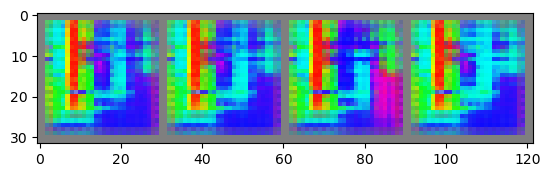

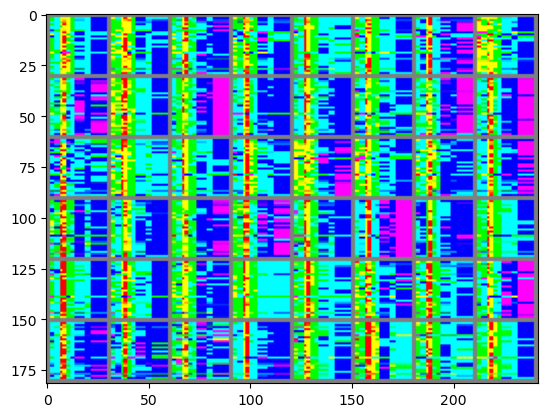

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 70/1000 Total Steps:355	Loss_D : 0.189608	Loss_G : 3.718670	Loss_D_Mean : 0.186859	Loss_G_Mean : 2.925912	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 71/1000 Total Steps:360	Loss_D : 0.623334	Loss_G : 3.072999	Loss_D_Mean : 0.425032	Loss_G_Mean : 2.754525	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 72/1000 Total Steps:365	Loss_D : 0.245913	Loss_G : 2.583979	Loss_D_Mean : 0.249057	Loss_G_Mean : 2.561661	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 73/1000 Total Steps:370	Loss_D : 0.105160	Loss_G : 3.337685	Loss_D_Mean : 0.166795	Loss_G_Mean : 2.981057	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 74/1000 Total Steps:375	Loss_D : 0.256808	Loss_G : 1.025708	Loss_D_Mean : 0.182651	Loss_G_Mean : 2.689161	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 75/1000 Total Steps:380	Loss_D : 0.160772	Loss_G : 2.947672	Loss_D_Mean : 0.312489	Loss_G_Mean : 2.970294	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 76/1000 Total Steps:385	Loss_D : 0.224061	Loss_G : 1.076485	Loss_D_Mean : 0.295533	Loss_G_Mean : 2.199005	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 77/1000 Total Steps:390	Loss_D : 0.255906	Loss_G : 1.140262	Loss_D_Mean : 0.251655	Loss_G_Mean : 2.360930	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 78/1000 Total Steps:395	Loss_D : 0.293342	Loss_G : 1.354502	Loss_D_Mean : 0.561212	Loss_G_Mean : 2.340625	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 79/1000 Total Steps:400	Loss_D : 0.450660	Loss_G : 1.509998	Loss_D_Mean : 0.349129	Loss_G_Mean : 2.030577	
Epoch: 80


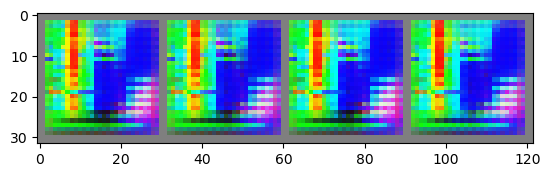

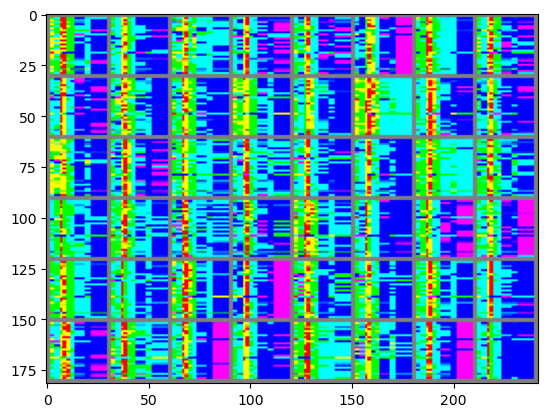

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 80/1000 Total Steps:405	Loss_D : 0.356651	Loss_G : 2.057568	Loss_D_Mean : 0.312268	Loss_G_Mean : 2.362655	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 81/1000 Total Steps:410	Loss_D : 0.387914	Loss_G : 3.653405	Loss_D_Mean : 0.348881	Loss_G_Mean : 2.483304	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 82/1000 Total Steps:415	Loss_D : 0.324205	Loss_G : 1.597884	Loss_D_Mean : 0.474648	Loss_G_Mean : 1.943890	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 83/1000 Total Steps:420	Loss_D : 0.279702	Loss_G : 2.465262	Loss_D_Mean : 0.257007	Loss_G_Mean : 2.250520	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 84/1000 Total Steps:425	Loss_D : 0.223791	Loss_G : 2.355254	Loss_D_Mean : 0.221506	Loss_G_Mean : 2.483558	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 85/1000 Total Steps:430	Loss_D : 0.159771	Loss_G : 1.266229	Loss_D_Mean : 0.332836	Loss_G_Mean : 2.550880	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 86/1000 Total Steps:435	Loss_D : 0.385371	Loss_G : 1.909723	Loss_D_Mean : 0.459092	Loss_G_Mean : 2.287994	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 87/1000 Total Steps:440	Loss_D : 0.223786	Loss_G : 2.016174	Loss_D_Mean : 0.298120	Loss_G_Mean : 1.809194	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 88/1000 Total Steps:445	Loss_D : 0.254944	Loss_G : 0.825225	Loss_D_Mean : 0.235980	Loss_G_Mean : 2.119509	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 89/1000 Total Steps:450	Loss_D : 0.224723	Loss_G : 2.862779	Loss_D_Mean : 0.486071	Loss_G_Mean : 2.698041	
Epoch: 90


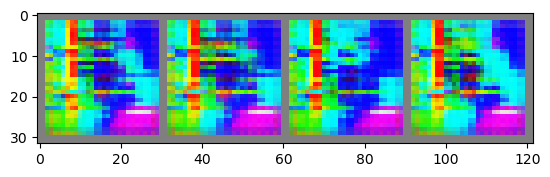

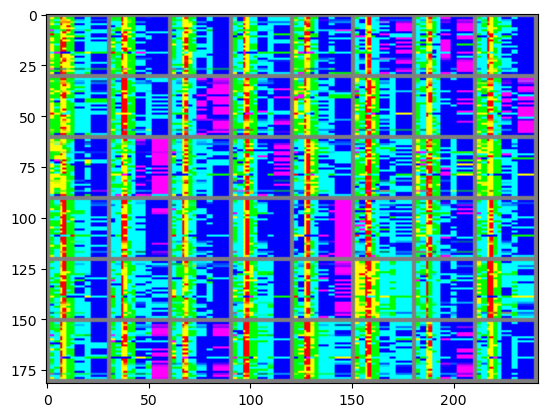

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 90/1000 Total Steps:455	Loss_D : 0.284837	Loss_G : 2.024310	Loss_D_Mean : 0.290818	Loss_G_Mean : 2.026081	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 91/1000 Total Steps:460	Loss_D : 0.571065	Loss_G : 4.181154	Loss_D_Mean : 0.388281	Loss_G_Mean : 2.219767	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 92/1000 Total Steps:465	Loss_D : 0.438503	Loss_G : 1.940370	Loss_D_Mean : 0.570930	Loss_G_Mean : 1.813208	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 93/1000 Total Steps:470	Loss_D : 0.374652	Loss_G : 2.184889	Loss_D_Mean : 0.398241	Loss_G_Mean : 1.886633	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 94/1000 Total Steps:475	Loss_D : 0.317185	Loss_G : 2.144626	Loss_D_Mean : 0.437447	Loss_G_Mean : 1.965976	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 95/1000 Total Steps:480	Loss_D : 0.261528	Loss_G : 0.675011	Loss_D_Mean : 0.447525	Loss_G_Mean : 1.740397	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 96/1000 Total Steps:485	Loss_D : 0.278092	Loss_G : 1.680902	Loss_D_Mean : 0.339113	Loss_G_Mean : 2.240729	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 97/1000 Total Steps:490	Loss_D : 0.325034	Loss_G : 1.454570	Loss_D_Mean : 0.302597	Loss_G_Mean : 2.018132	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 98/1000 Total Steps:495	Loss_D : 0.550836	Loss_G : 2.635473	Loss_D_Mean : 0.478623	Loss_G_Mean : 2.060299	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 99/1000 Total Steps:500	Loss_D : 0.350938	Loss_G : 1.240118	Loss_D_Mean : 0.350799	Loss_G_Mean : 1.750302	
Epoch: 100


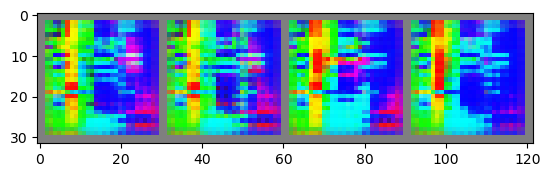

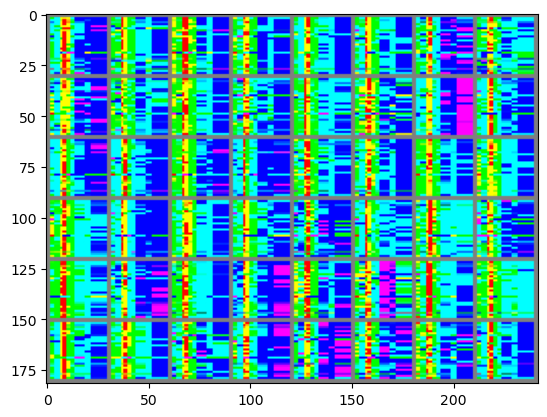

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 100/1000 Total Steps:505	Loss_D : 0.338459	Loss_G : 1.190504	Loss_D_Mean : 0.346839	Loss_G_Mean : 1.745996	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 101/1000 Total Steps:510	Loss_D : 0.297238	Loss_G : 1.452850	Loss_D_Mean : 0.462634	Loss_G_Mean : 2.077795	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 102/1000 Total Steps:515	Loss_D : 0.386014	Loss_G : 1.161402	Loss_D_Mean : 0.339335	Loss_G_Mean : 1.793818	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 103/1000 Total Steps:520	Loss_D : 0.294296	Loss_G : 2.231158	Loss_D_Mean : 0.312292	Loss_G_Mean : 1.936125	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 104/1000 Total Steps:525	Loss_D : 0.337988	Loss_G : 2.092496	Loss_D_Mean : 0.363224	Loss_G_Mean : 1.793881	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 105/1000 Total Steps:530	Loss_D : 0.300545	Loss_G : 2.173168	Loss_D_Mean : 0.334843	Loss_G_Mean : 1.819141	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 106/1000 Total Steps:535	Loss_D : 0.426981	Loss_G : 1.005812	Loss_D_Mean : 0.390173	Loss_G_Mean : 1.641870	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 107/1000 Total Steps:540	Loss_D : 0.391141	Loss_G : 2.511249	Loss_D_Mean : 0.341755	Loss_G_Mean : 1.833118	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 108/1000 Total Steps:545	Loss_D : 0.396522	Loss_G : 2.834412	Loss_D_Mean : 0.348832	Loss_G_Mean : 1.848733	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 109/1000 Total Steps:550	Loss_D : 0.508181	Loss_G : 2.520918	Loss_D_Mean : 0.626870	Loss_G_Mean : 1.678417	
Epoch: 110


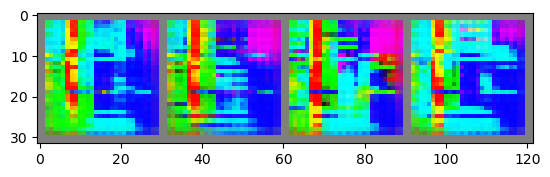

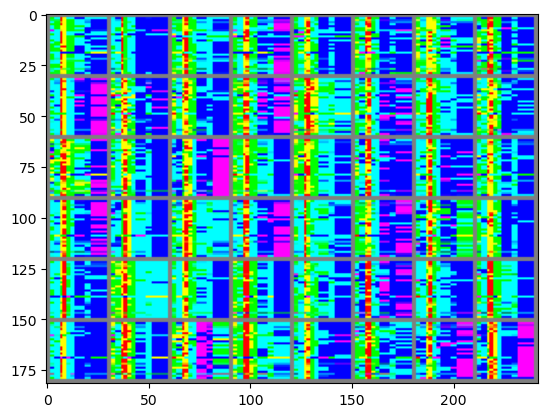

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 110/1000 Total Steps:555	Loss_D : 0.412596	Loss_G : 2.121475	Loss_D_Mean : 0.394278	Loss_G_Mean : 1.670538	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 111/1000 Total Steps:560	Loss_D : 0.351921	Loss_G : 1.620472	Loss_D_Mean : 0.432627	Loss_G_Mean : 1.564272	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 112/1000 Total Steps:565	Loss_D : 0.379101	Loss_G : 2.443991	Loss_D_Mean : 0.432866	Loss_G_Mean : 1.823670	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 113/1000 Total Steps:570	Loss_D : 0.396458	Loss_G : 1.895094	Loss_D_Mean : 0.412047	Loss_G_Mean : 1.486945	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 114/1000 Total Steps:575	Loss_D : 0.343257	Loss_G : 0.869411	Loss_D_Mean : 0.309803	Loss_G_Mean : 1.560047	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 115/1000 Total Steps:580	Loss_D : 0.386456	Loss_G : 2.276325	Loss_D_Mean : 0.413482	Loss_G_Mean : 2.000432	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 116/1000 Total Steps:585	Loss_D : 0.405164	Loss_G : 2.322508	Loss_D_Mean : 0.340241	Loss_G_Mean : 1.768003	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 117/1000 Total Steps:590	Loss_D : 0.663596	Loss_G : 2.651927	Loss_D_Mean : 0.458461	Loss_G_Mean : 1.890294	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 118/1000 Total Steps:595	Loss_D : 0.349848	Loss_G : 1.656392	Loss_D_Mean : 0.456062	Loss_G_Mean : 1.497327	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 119/1000 Total Steps:600	Loss_D : 0.345694	Loss_G : 1.463799	Loss_D_Mean : 0.402753	Loss_G_Mean : 1.508413	
Epoch: 120


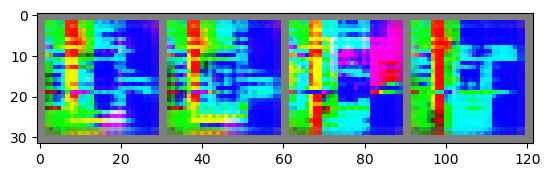

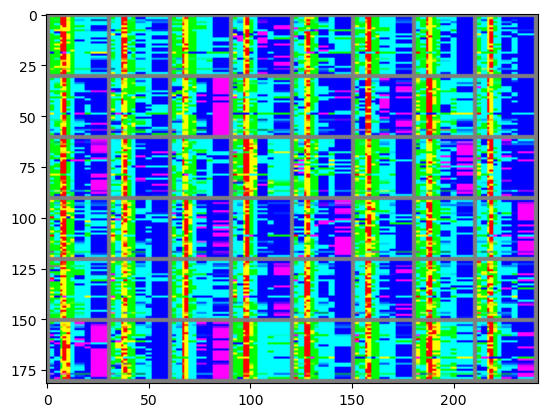

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 120/1000 Total Steps:605	Loss_D : 0.384441	Loss_G : 1.758539	Loss_D_Mean : 0.399207	Loss_G_Mean : 1.612862	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 121/1000 Total Steps:610	Loss_D : 0.720055	Loss_G : 2.712990	Loss_D_Mean : 0.450064	Loss_G_Mean : 1.680361	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 122/1000 Total Steps:615	Loss_D : 0.388768	Loss_G : 1.131881	Loss_D_Mean : 0.376045	Loss_G_Mean : 1.615595	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 123/1000 Total Steps:620	Loss_D : 0.271770	Loss_G : 1.418816	Loss_D_Mean : 0.343624	Loss_G_Mean : 1.779365	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 124/1000 Total Steps:625	Loss_D : 0.319239	Loss_G : 0.802906	Loss_D_Mean : 0.318997	Loss_G_Mean : 1.579797	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 125/1000 Total Steps:630	Loss_D : 0.583194	Loss_G : 2.741291	Loss_D_Mean : 0.421840	Loss_G_Mean : 2.015395	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 126/1000 Total Steps:635	Loss_D : 0.296983	Loss_G : 1.681335	Loss_D_Mean : 0.334710	Loss_G_Mean : 1.740569	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 127/1000 Total Steps:640	Loss_D : 0.328128	Loss_G : 2.055262	Loss_D_Mean : 0.461483	Loss_G_Mean : 1.919593	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 128/1000 Total Steps:645	Loss_D : 0.316059	Loss_G : 0.849362	Loss_D_Mean : 0.368208	Loss_G_Mean : 1.525872	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 129/1000 Total Steps:650	Loss_D : 1.016998	Loss_G : 0.438603	Loss_D_Mean : 0.553982	Loss_G_Mean : 1.875499	
Epoch: 130


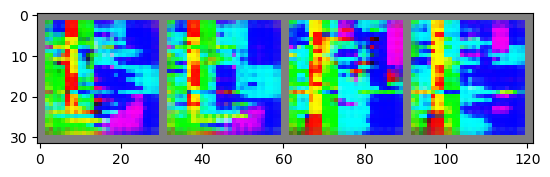

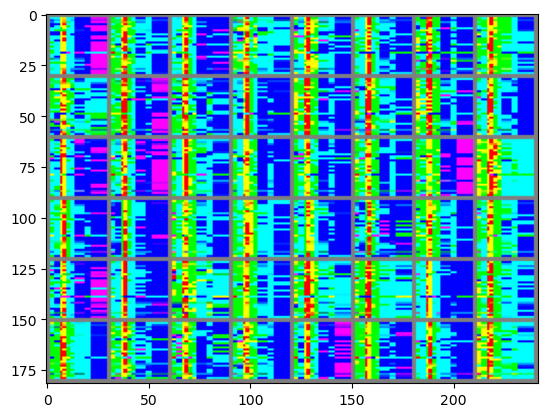

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 130/1000 Total Steps:655	Loss_D : 0.338459	Loss_G : 1.788021	Loss_D_Mean : 0.522803	Loss_G_Mean : 1.442857	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 131/1000 Total Steps:660	Loss_D : 0.369054	Loss_G : 1.574910	Loss_D_Mean : 0.370634	Loss_G_Mean : 1.450700	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 132/1000 Total Steps:665	Loss_D : 0.322281	Loss_G : 1.521383	Loss_D_Mean : 0.345205	Loss_G_Mean : 1.641453	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 133/1000 Total Steps:670	Loss_D : 0.477140	Loss_G : 1.244760	Loss_D_Mean : 0.413387	Loss_G_Mean : 1.746447	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 134/1000 Total Steps:675	Loss_D : 0.379574	Loss_G : 2.735702	Loss_D_Mean : 0.340135	Loss_G_Mean : 1.905594	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 135/1000 Total Steps:680	Loss_D : 0.329199	Loss_G : 0.674538	Loss_D_Mean : 0.460586	Loss_G_Mean : 1.466683	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 136/1000 Total Steps:685	Loss_D : 0.485330	Loss_G : 3.236314	Loss_D_Mean : 0.380086	Loss_G_Mean : 2.139156	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 137/1000 Total Steps:690	Loss_D : 0.332902	Loss_G : 1.156508	Loss_D_Mean : 0.507779	Loss_G_Mean : 1.462163	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 138/1000 Total Steps:695	Loss_D : 0.336688	Loss_G : 2.315128	Loss_D_Mean : 0.310281	Loss_G_Mean : 1.743819	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 139/1000 Total Steps:700	Loss_D : 0.324349	Loss_G : 1.694079	Loss_D_Mean : 0.328908	Loss_G_Mean : 1.608982	
Epoch: 140


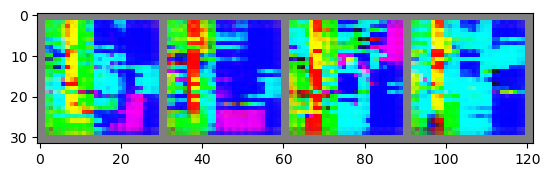

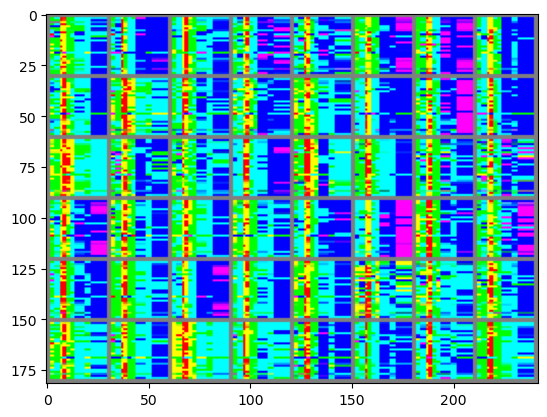

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 140/1000 Total Steps:705	Loss_D : 0.405677	Loss_G : 1.440256	Loss_D_Mean : 0.501459	Loss_G_Mean : 1.609611	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 141/1000 Total Steps:710	Loss_D : 0.332641	Loss_G : 1.312090	Loss_D_Mean : 0.416772	Loss_G_Mean : 1.726177	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 142/1000 Total Steps:715	Loss_D : 0.350198	Loss_G : 1.516524	Loss_D_Mean : 0.402264	Loss_G_Mean : 1.716835	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 143/1000 Total Steps:720	Loss_D : 0.583828	Loss_G : 1.323275	Loss_D_Mean : 0.495541	Loss_G_Mean : 1.762880	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 144/1000 Total Steps:725	Loss_D : 0.396772	Loss_G : 1.986052	Loss_D_Mean : 0.510479	Loss_G_Mean : 1.534220	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 145/1000 Total Steps:730	Loss_D : 0.341527	Loss_G : 1.813744	Loss_D_Mean : 0.394221	Loss_G_Mean : 1.548376	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 146/1000 Total Steps:735	Loss_D : 0.365650	Loss_G : 1.580433	Loss_D_Mean : 0.323319	Loss_G_Mean : 1.774448	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 147/1000 Total Steps:740	Loss_D : 0.307624	Loss_G : 1.452361	Loss_D_Mean : 0.303888	Loss_G_Mean : 1.669323	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 148/1000 Total Steps:745	Loss_D : 0.355013	Loss_G : 1.261860	Loss_D_Mean : 0.417858	Loss_G_Mean : 1.711653	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 149/1000 Total Steps:750	Loss_D : 0.367729	Loss_G : 1.894617	Loss_D_Mean : 0.491808	Loss_G_Mean : 1.945987	
Epoch: 150


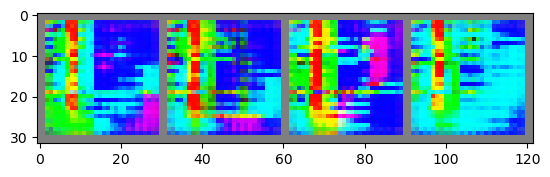

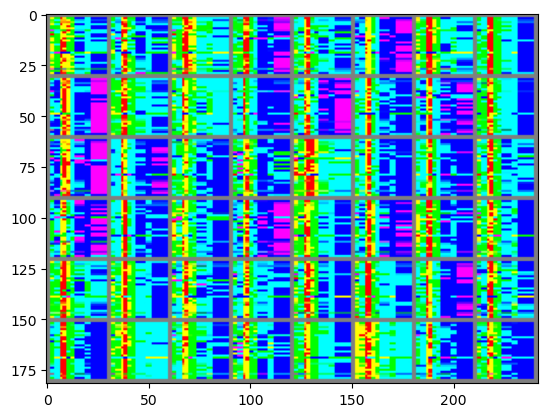

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 150/1000 Total Steps:755	Loss_D : 0.313733	Loss_G : 1.938537	Loss_D_Mean : 0.385717	Loss_G_Mean : 1.785237	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 151/1000 Total Steps:760	Loss_D : 0.285286	Loss_G : 2.360595	Loss_D_Mean : 0.397764	Loss_G_Mean : 1.793065	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 152/1000 Total Steps:765	Loss_D : 0.347460	Loss_G : 2.348629	Loss_D_Mean : 0.337450	Loss_G_Mean : 1.915875	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 153/1000 Total Steps:770	Loss_D : 0.518131	Loss_G : 1.955127	Loss_D_Mean : 0.444107	Loss_G_Mean : 1.663927	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 154/1000 Total Steps:775	Loss_D : 0.348192	Loss_G : 1.459463	Loss_D_Mean : 0.357569	Loss_G_Mean : 1.674793	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 155/1000 Total Steps:780	Loss_D : 0.506759	Loss_G : 0.851244	Loss_D_Mean : 0.322969	Loss_G_Mean : 1.851156	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 156/1000 Total Steps:785	Loss_D : 0.339817	Loss_G : 2.318766	Loss_D_Mean : 0.371583	Loss_G_Mean : 2.011442	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 157/1000 Total Steps:790	Loss_D : 0.369816	Loss_G : 1.471345	Loss_D_Mean : 0.347070	Loss_G_Mean : 1.712308	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 158/1000 Total Steps:795	Loss_D : 0.630444	Loss_G : 1.324167	Loss_D_Mean : 0.493843	Loss_G_Mean : 1.743897	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 159/1000 Total Steps:800	Loss_D : 0.446361	Loss_G : 2.246128	Loss_D_Mean : 0.392037	Loss_G_Mean : 1.839234	
Epoch: 160


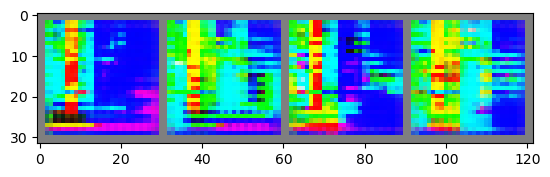

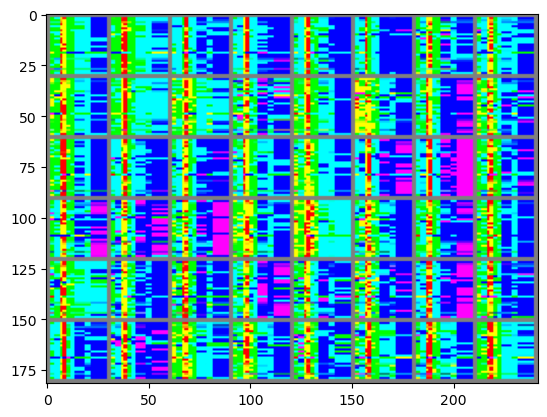

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 160/1000 Total Steps:805	Loss_D : 0.347289	Loss_G : 1.395590	Loss_D_Mean : 0.356320	Loss_G_Mean : 1.655213	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 161/1000 Total Steps:810	Loss_D : 0.323657	Loss_G : 1.858812	Loss_D_Mean : 0.313721	Loss_G_Mean : 1.837958	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 162/1000 Total Steps:815	Loss_D : 0.453101	Loss_G : 1.321272	Loss_D_Mean : 0.360703	Loss_G_Mean : 1.851366	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 163/1000 Total Steps:820	Loss_D : 0.469182	Loss_G : 2.869740	Loss_D_Mean : 0.416827	Loss_G_Mean : 1.951559	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 164/1000 Total Steps:825	Loss_D : 0.342176	Loss_G : 1.438236	Loss_D_Mean : 0.395700	Loss_G_Mean : 1.616057	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 165/1000 Total Steps:830	Loss_D : 0.701790	Loss_G : 2.786285	Loss_D_Mean : 0.473705	Loss_G_Mean : 1.868492	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 166/1000 Total Steps:835	Loss_D : 0.364993	Loss_G : 1.892297	Loss_D_Mean : 0.455844	Loss_G_Mean : 1.615672	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 167/1000 Total Steps:840	Loss_D : 0.318083	Loss_G : 1.901225	Loss_D_Mean : 0.341026	Loss_G_Mean : 1.697551	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 168/1000 Total Steps:845	Loss_D : 0.636554	Loss_G : 1.787835	Loss_D_Mean : 0.486744	Loss_G_Mean : 1.504810	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 169/1000 Total Steps:850	Loss_D : 0.394527	Loss_G : 1.461388	Loss_D_Mean : 0.387946	Loss_G_Mean : 1.699727	
Epoch: 170


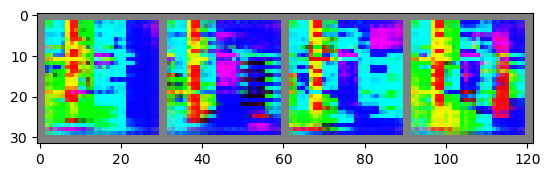

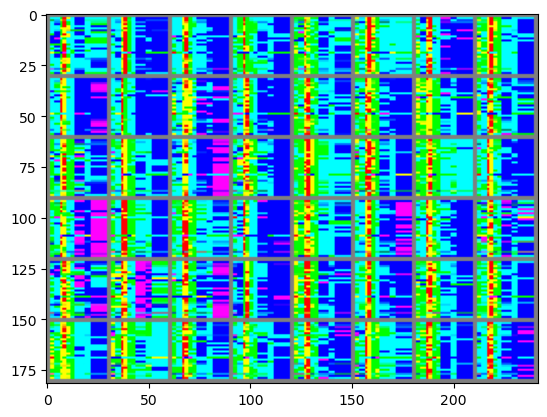

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 170/1000 Total Steps:855	Loss_D : 0.309781	Loss_G : 1.798558	Loss_D_Mean : 0.338143	Loss_G_Mean : 1.682690	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 171/1000 Total Steps:860	Loss_D : 0.318346	Loss_G : 2.498113	Loss_D_Mean : 0.300835	Loss_G_Mean : 1.815370	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 172/1000 Total Steps:865	Loss_D : 0.342172	Loss_G : 2.417397	Loss_D_Mean : 0.298444	Loss_G_Mean : 1.765114	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 173/1000 Total Steps:870	Loss_D : 0.355304	Loss_G : 2.514690	Loss_D_Mean : 0.310664	Loss_G_Mean : 1.859438	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 174/1000 Total Steps:875	Loss_D : 0.460746	Loss_G : 1.049298	Loss_D_Mean : 0.446777	Loss_G_Mean : 1.680118	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 175/1000 Total Steps:880	Loss_D : 0.348804	Loss_G : 1.444284	Loss_D_Mean : 0.397885	Loss_G_Mean : 1.813466	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 176/1000 Total Steps:885	Loss_D : 0.362929	Loss_G : 1.032141	Loss_D_Mean : 0.346783	Loss_G_Mean : 1.592962	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 177/1000 Total Steps:890	Loss_D : 0.612885	Loss_G : 3.266881	Loss_D_Mean : 0.429413	Loss_G_Mean : 1.936347	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 178/1000 Total Steps:895	Loss_D : 0.328438	Loss_G : 1.486611	Loss_D_Mean : 0.426741	Loss_G_Mean : 1.521870	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 179/1000 Total Steps:900	Loss_D : 0.355768	Loss_G : 1.793149	Loss_D_Mean : 0.365630	Loss_G_Mean : 1.800372	
Epoch: 180


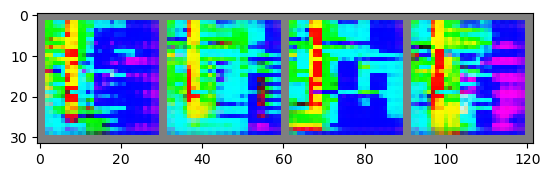

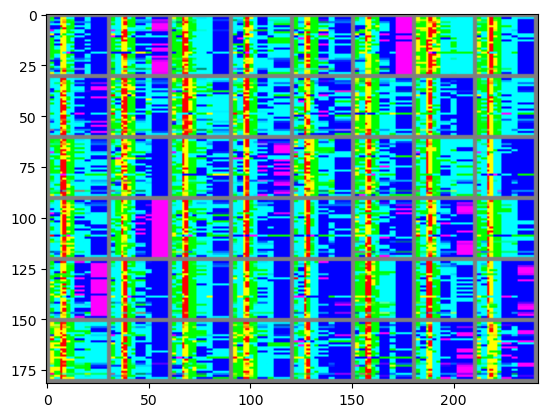

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 180/1000 Total Steps:905	Loss_D : 0.358985	Loss_G : 2.087903	Loss_D_Mean : 0.509677	Loss_G_Mean : 1.642277	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 181/1000 Total Steps:910	Loss_D : 0.693610	Loss_G : 3.072926	Loss_D_Mean : 0.412673	Loss_G_Mean : 1.917588	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 182/1000 Total Steps:915	Loss_D : 0.297560	Loss_G : 1.507370	Loss_D_Mean : 0.482801	Loss_G_Mean : 1.563368	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 183/1000 Total Steps:920	Loss_D : 0.297149	Loss_G : 1.976201	Loss_D_Mean : 0.325073	Loss_G_Mean : 1.701925	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 184/1000 Total Steps:925	Loss_D : 0.379583	Loss_G : 0.922967	Loss_D_Mean : 0.336327	Loss_G_Mean : 1.516266	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 185/1000 Total Steps:930	Loss_D : 0.298932	Loss_G : 1.734135	Loss_D_Mean : 0.321520	Loss_G_Mean : 1.751511	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 186/1000 Total Steps:935	Loss_D : 0.364449	Loss_G : 2.318099	Loss_D_Mean : 0.336231	Loss_G_Mean : 1.655924	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 187/1000 Total Steps:940	Loss_D : 0.349840	Loss_G : 2.726351	Loss_D_Mean : 0.303032	Loss_G_Mean : 1.861448	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 188/1000 Total Steps:945	Loss_D : 0.358298	Loss_G : 1.182231	Loss_D_Mean : 0.507162	Loss_G_Mean : 1.508542	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 189/1000 Total Steps:950	Loss_D : 0.604966	Loss_G : 1.422945	Loss_D_Mean : 0.535291	Loss_G_Mean : 1.855016	
Epoch: 190


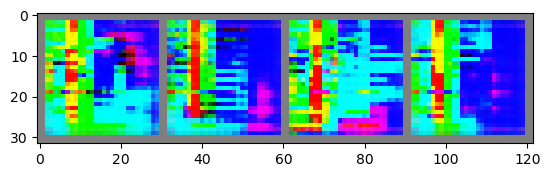

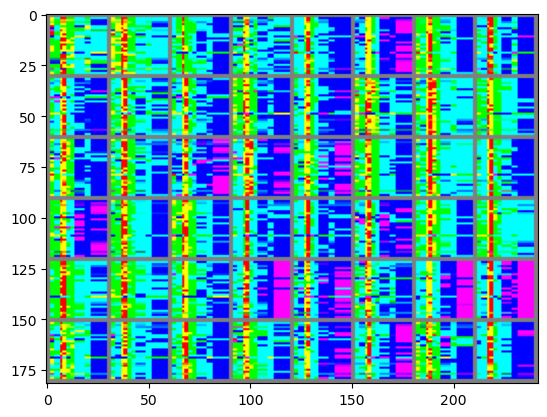

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 190/1000 Total Steps:955	Loss_D : 0.412540	Loss_G : 1.447126	Loss_D_Mean : 0.372956	Loss_G_Mean : 1.629309	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 191/1000 Total Steps:960	Loss_D : 0.382483	Loss_G : 1.684975	Loss_D_Mean : 0.352970	Loss_G_Mean : 1.640518	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 192/1000 Total Steps:965	Loss_D : 0.549692	Loss_G : 2.329852	Loss_D_Mean : 0.454177	Loss_G_Mean : 1.738474	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 193/1000 Total Steps:970	Loss_D : 0.427320	Loss_G : 2.025285	Loss_D_Mean : 0.395577	Loss_G_Mean : 1.682347	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 194/1000 Total Steps:975	Loss_D : 0.444591	Loss_G : 1.072323	Loss_D_Mean : 0.365488	Loss_G_Mean : 1.678805	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 195/1000 Total Steps:980	Loss_D : 0.279283	Loss_G : 2.157505	Loss_D_Mean : 0.308615	Loss_G_Mean : 2.014338	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 196/1000 Total Steps:985	Loss_D : 0.856136	Loss_G : 2.658515	Loss_D_Mean : 0.514377	Loss_G_Mean : 1.901329	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 197/1000 Total Steps:990	Loss_D : 0.363975	Loss_G : 1.519460	Loss_D_Mean : 0.330510	Loss_G_Mean : 1.892085	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 198/1000 Total Steps:995	Loss_D : 0.346042	Loss_G : 1.907872	Loss_D_Mean : 0.337527	Loss_G_Mean : 1.831699	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 199/1000 Total Steps:1000	Loss_D : 0.362450	Loss_G : 1.681105	Loss_D_Mean : 0.353000	Loss_G_Mean : 1.948104	
Epoch: 200


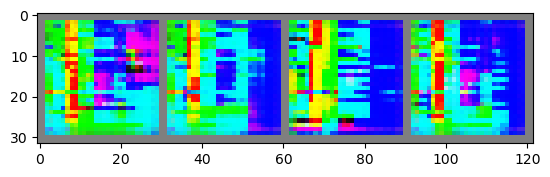

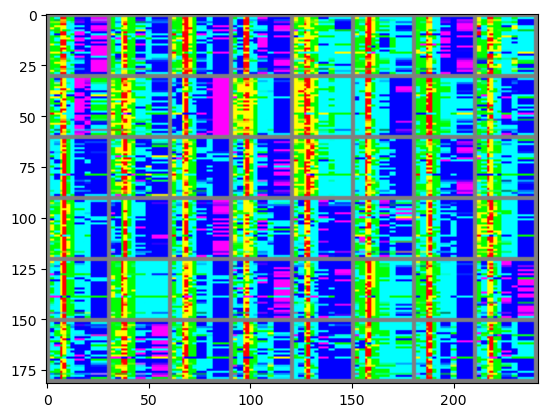

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 200/1000 Total Steps:1005	Loss_D : 0.310699	Loss_G : 1.876380	Loss_D_Mean : 0.338117	Loss_G_Mean : 1.900537	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 201/1000 Total Steps:1010	Loss_D : 0.356486	Loss_G : 2.475402	Loss_D_Mean : 0.350857	Loss_G_Mean : 1.830094	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 202/1000 Total Steps:1015	Loss_D : 0.366366	Loss_G : 2.680909	Loss_D_Mean : 0.386498	Loss_G_Mean : 1.955452	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 203/1000 Total Steps:1020	Loss_D : 0.305378	Loss_G : 1.408536	Loss_D_Mean : 0.393605	Loss_G_Mean : 1.625529	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 204/1000 Total Steps:1025	Loss_D : 0.401389	Loss_G : 1.148726	Loss_D_Mean : 0.323030	Loss_G_Mean : 1.759715	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 205/1000 Total Steps:1030	Loss_D : 0.259442	Loss_G : 1.948335	Loss_D_Mean : 0.309107	Loss_G_Mean : 1.984906	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 206/1000 Total Steps:1035	Loss_D : 0.805995	Loss_G : 3.473246	Loss_D_Mean : 0.415744	Loss_G_Mean : 2.058199	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 207/1000 Total Steps:1040	Loss_D : 0.350932	Loss_G : 1.722627	Loss_D_Mean : 0.610654	Loss_G_Mean : 1.825459	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 208/1000 Total Steps:1045	Loss_D : 0.490713	Loss_G : 2.763575	Loss_D_Mean : 0.358665	Loss_G_Mean : 1.831131	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 209/1000 Total Steps:1050	Loss_D : 0.377865	Loss_G : 1.104483	Loss_D_Mean : 0.413589	Loss_G_Mean : 1.658566	
Epoch: 210


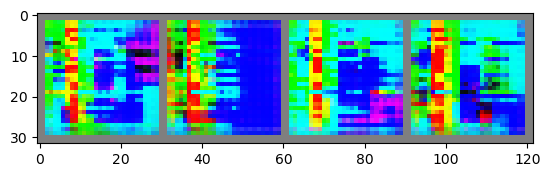

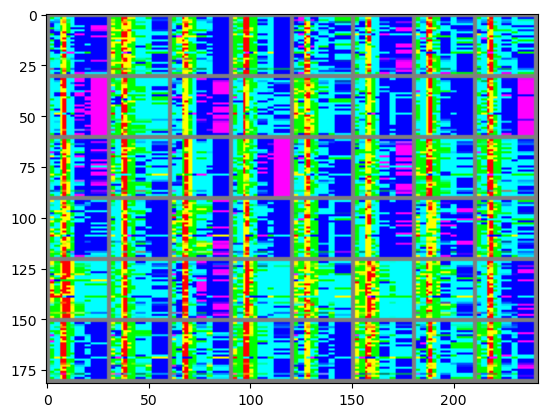

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 210/1000 Total Steps:1055	Loss_D : 0.369301	Loss_G : 1.052961	Loss_D_Mean : 0.335183	Loss_G_Mean : 1.673870	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 211/1000 Total Steps:1060	Loss_D : 0.480255	Loss_G : 1.196664	Loss_D_Mean : 0.468194	Loss_G_Mean : 1.813907	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 212/1000 Total Steps:1065	Loss_D : 0.322722	Loss_G : 1.419207	Loss_D_Mean : 0.394427	Loss_G_Mean : 1.580873	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 213/1000 Total Steps:1070	Loss_D : 0.281109	Loss_G : 1.498516	Loss_D_Mean : 0.330602	Loss_G_Mean : 1.657805	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 214/1000 Total Steps:1075	Loss_D : 0.291049	Loss_G : 2.028934	Loss_D_Mean : 0.265104	Loss_G_Mean : 1.895514	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 215/1000 Total Steps:1080	Loss_D : 0.599228	Loss_G : 2.664630	Loss_D_Mean : 0.389181	Loss_G_Mean : 1.780241	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 216/1000 Total Steps:1085	Loss_D : 0.389065	Loss_G : 1.306410	Loss_D_Mean : 0.513499	Loss_G_Mean : 1.675689	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 217/1000 Total Steps:1090	Loss_D : 0.471751	Loss_G : 1.876189	Loss_D_Mean : 0.427779	Loss_G_Mean : 1.760692	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 218/1000 Total Steps:1095	Loss_D : 0.455783	Loss_G : 0.989014	Loss_D_Mean : 0.496450	Loss_G_Mean : 1.476941	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 219/1000 Total Steps:1100	Loss_D : 0.397081	Loss_G : 1.874256	Loss_D_Mean : 0.397753	Loss_G_Mean : 1.734730	
Epoch: 220


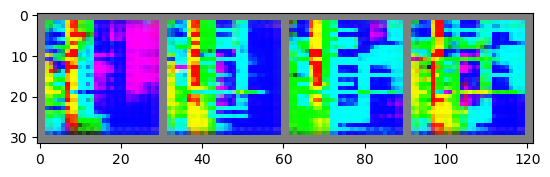

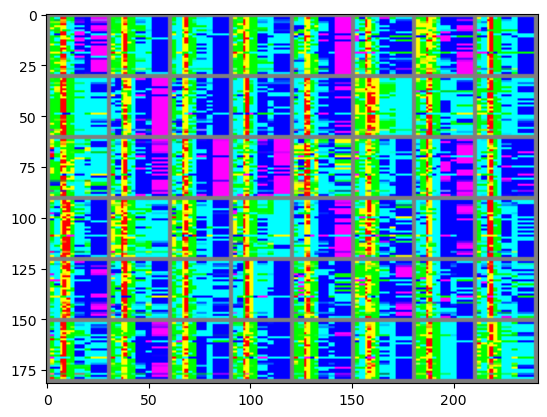

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 220/1000 Total Steps:1105	Loss_D : 0.469765	Loss_G : 1.105904	Loss_D_Mean : 0.415483	Loss_G_Mean : 1.532299	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 221/1000 Total Steps:1110	Loss_D : 0.344327	Loss_G : 2.190487	Loss_D_Mean : 0.352254	Loss_G_Mean : 1.782344	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 222/1000 Total Steps:1115	Loss_D : 0.264472	Loss_G : 2.740545	Loss_D_Mean : 0.324497	Loss_G_Mean : 2.034786	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 223/1000 Total Steps:1120	Loss_D : 0.414777	Loss_G : 1.405378	Loss_D_Mean : 0.358989	Loss_G_Mean : 1.671160	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 224/1000 Total Steps:1125	Loss_D : 0.356320	Loss_G : 2.393619	Loss_D_Mean : 0.414573	Loss_G_Mean : 1.886261	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 225/1000 Total Steps:1130	Loss_D : 0.444171	Loss_G : 4.252985	Loss_D_Mean : 0.416124	Loss_G_Mean : 2.391745	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 226/1000 Total Steps:1135	Loss_D : 0.307805	Loss_G : 1.591480	Loss_D_Mean : 0.509423	Loss_G_Mean : 2.011789	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 227/1000 Total Steps:1140	Loss_D : 0.217806	Loss_G : 2.423387	Loss_D_Mean : 0.265035	Loss_G_Mean : 2.131357	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 228/1000 Total Steps:1145	Loss_D : 0.394067	Loss_G : 2.071401	Loss_D_Mean : 0.298991	Loss_G_Mean : 2.045529	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 229/1000 Total Steps:1150	Loss_D : 0.365481	Loss_G : 2.223828	Loss_D_Mean : 0.452215	Loss_G_Mean : 2.180406	
Epoch: 230


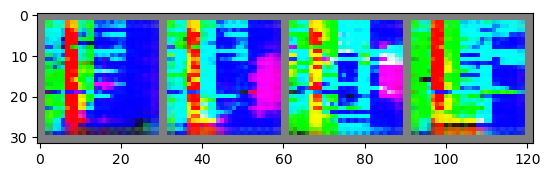

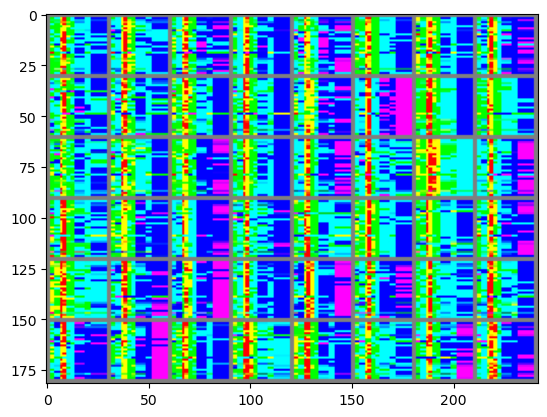

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 230/1000 Total Steps:1155	Loss_D : 0.373518	Loss_G : 1.480989	Loss_D_Mean : 0.406449	Loss_G_Mean : 1.818808	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 231/1000 Total Steps:1160	Loss_D : 0.217913	Loss_G : 1.965856	Loss_D_Mean : 0.314595	Loss_G_Mean : 2.004618	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 232/1000 Total Steps:1165	Loss_D : 0.255966	Loss_G : 1.992477	Loss_D_Mean : 0.219874	Loss_G_Mean : 2.189649	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 233/1000 Total Steps:1170	Loss_D : 0.235098	Loss_G : 1.911403	Loss_D_Mean : 0.343847	Loss_G_Mean : 2.202364	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 234/1000 Total Steps:1175	Loss_D : 0.545793	Loss_G : 2.460713	Loss_D_Mean : 0.384298	Loss_G_Mean : 2.058968	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 235/1000 Total Steps:1180	Loss_D : 0.430484	Loss_G : 1.099317	Loss_D_Mean : 0.319923	Loss_G_Mean : 1.815743	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 236/1000 Total Steps:1185	Loss_D : 0.452675	Loss_G : 1.198216	Loss_D_Mean : 0.375321	Loss_G_Mean : 1.882357	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 237/1000 Total Steps:1190	Loss_D : 0.397349	Loss_G : 0.956551	Loss_D_Mean : 0.363385	Loss_G_Mean : 1.785465	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 238/1000 Total Steps:1195	Loss_D : 0.243876	Loss_G : 2.538061	Loss_D_Mean : 0.397543	Loss_G_Mean : 2.155559	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 239/1000 Total Steps:1200	Loss_D : 0.321315	Loss_G : 2.994819	Loss_D_Mean : 0.281446	Loss_G_Mean : 2.078875	
Epoch: 240


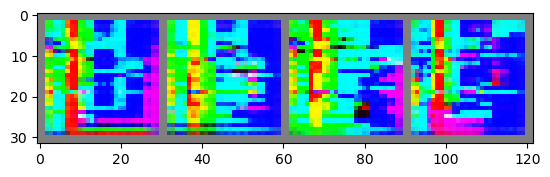

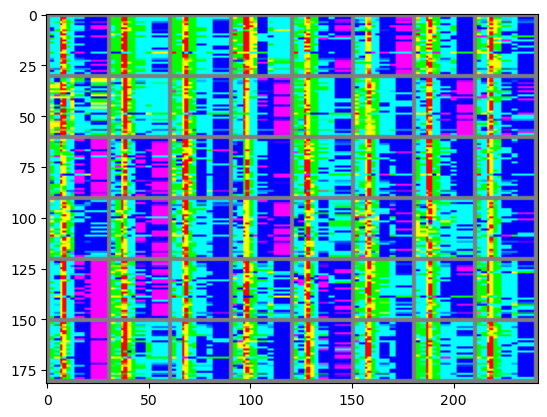

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 240/1000 Total Steps:1205	Loss_D : 0.318458	Loss_G : 1.403621	Loss_D_Mean : 0.312109	Loss_G_Mean : 1.883180	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 241/1000 Total Steps:1210	Loss_D : 0.280010	Loss_G : 1.577370	Loss_D_Mean : 0.319777	Loss_G_Mean : 2.074008	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 242/1000 Total Steps:1215	Loss_D : 0.287705	Loss_G : 1.274870	Loss_D_Mean : 0.324093	Loss_G_Mean : 1.887441	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 243/1000 Total Steps:1220	Loss_D : 0.318688	Loss_G : 1.369494	Loss_D_Mean : 0.317369	Loss_G_Mean : 2.042911	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 244/1000 Total Steps:1225	Loss_D : 0.430052	Loss_G : 1.767945	Loss_D_Mean : 0.396445	Loss_G_Mean : 1.931637	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 245/1000 Total Steps:1230	Loss_D : 0.631493	Loss_G : 2.366222	Loss_D_Mean : 0.549489	Loss_G_Mean : 2.050088	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 246/1000 Total Steps:1235	Loss_D : 0.566044	Loss_G : 1.288701	Loss_D_Mean : 0.437592	Loss_G_Mean : 1.864699	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 247/1000 Total Steps:1240	Loss_D : 0.378154	Loss_G : 2.449925	Loss_D_Mean : 0.395585	Loss_G_Mean : 1.865394	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 248/1000 Total Steps:1245	Loss_D : 0.329896	Loss_G : 2.245448	Loss_D_Mean : 0.390778	Loss_G_Mean : 1.729940	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 249/1000 Total Steps:1250	Loss_D : 0.282783	Loss_G : 1.293290	Loss_D_Mean : 0.310697	Loss_G_Mean : 1.799825	
Epoch: 250


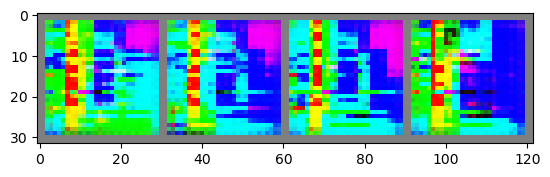

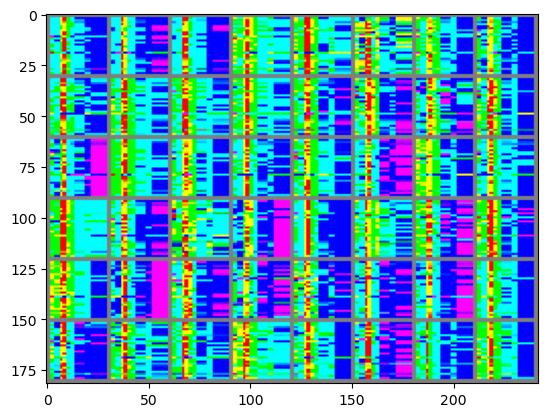

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 250/1000 Total Steps:1255	Loss_D : 0.634664	Loss_G : 1.997762	Loss_D_Mean : 0.374587	Loss_G_Mean : 2.349505	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 251/1000 Total Steps:1260	Loss_D : 0.290337	Loss_G : 2.099164	Loss_D_Mean : 0.317612	Loss_G_Mean : 1.791113	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 252/1000 Total Steps:1265	Loss_D : 0.281571	Loss_G : 2.289677	Loss_D_Mean : 0.246455	Loss_G_Mean : 2.117738	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 253/1000 Total Steps:1270	Loss_D : 0.242418	Loss_G : 2.048461	Loss_D_Mean : 0.291846	Loss_G_Mean : 1.880328	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 254/1000 Total Steps:1275	Loss_D : 0.360205	Loss_G : 3.166967	Loss_D_Mean : 0.278784	Loss_G_Mean : 2.045948	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 255/1000 Total Steps:1280	Loss_D : 0.287359	Loss_G : 2.110420	Loss_D_Mean : 0.324970	Loss_G_Mean : 1.915826	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 256/1000 Total Steps:1285	Loss_D : 0.635355	Loss_G : 3.689345	Loss_D_Mean : 0.370843	Loss_G_Mean : 2.124221	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 257/1000 Total Steps:1290	Loss_D : 0.274370	Loss_G : 1.764781	Loss_D_Mean : 0.399404	Loss_G_Mean : 1.828440	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 258/1000 Total Steps:1295	Loss_D : 0.271654	Loss_G : 2.438176	Loss_D_Mean : 0.332674	Loss_G_Mean : 2.042048	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 259/1000 Total Steps:1300	Loss_D : 0.290865	Loss_G : 1.967128	Loss_D_Mean : 0.279196	Loss_G_Mean : 1.835874	
Epoch: 260


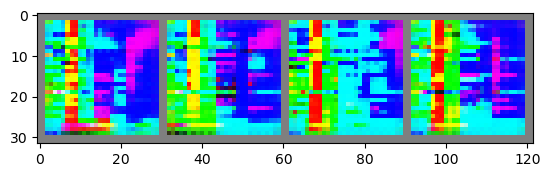

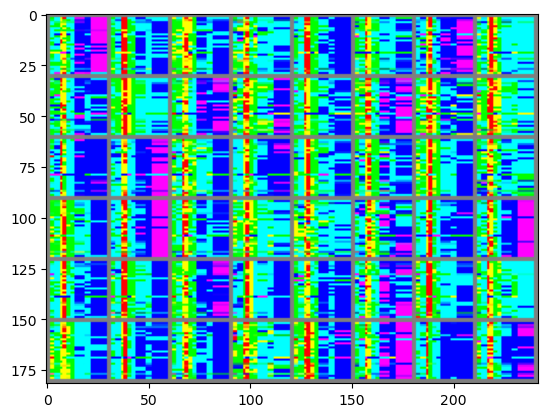

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 260/1000 Total Steps:1305	Loss_D : 0.229750	Loss_G : 1.971688	Loss_D_Mean : 0.239120	Loss_G_Mean : 2.022919	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 261/1000 Total Steps:1310	Loss_D : 0.581016	Loss_G : 4.657051	Loss_D_Mean : 0.356534	Loss_G_Mean : 2.390204	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 262/1000 Total Steps:1315	Loss_D : 0.285925	Loss_G : 1.915404	Loss_D_Mean : 0.412229	Loss_G_Mean : 1.775973	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 263/1000 Total Steps:1320	Loss_D : 0.301046	Loss_G : 0.904559	Loss_D_Mean : 0.403159	Loss_G_Mean : 1.813612	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 264/1000 Total Steps:1325	Loss_D : 0.677860	Loss_G : 0.949681	Loss_D_Mean : 0.456386	Loss_G_Mean : 2.094213	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 265/1000 Total Steps:1330	Loss_D : 0.281948	Loss_G : 2.639559	Loss_D_Mean : 0.559785	Loss_G_Mean : 2.180674	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 266/1000 Total Steps:1335	Loss_D : 0.370578	Loss_G : 1.626021	Loss_D_Mean : 0.368335	Loss_G_Mean : 1.797240	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 267/1000 Total Steps:1340	Loss_D : 0.343417	Loss_G : 1.912028	Loss_D_Mean : 0.348639	Loss_G_Mean : 2.123513	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 268/1000 Total Steps:1345	Loss_D : 0.501525	Loss_G : 3.225788	Loss_D_Mean : 0.408722	Loss_G_Mean : 2.385543	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 269/1000 Total Steps:1350	Loss_D : 0.440616	Loss_G : 2.267699	Loss_D_Mean : 0.548492	Loss_G_Mean : 1.919813	
Epoch: 270


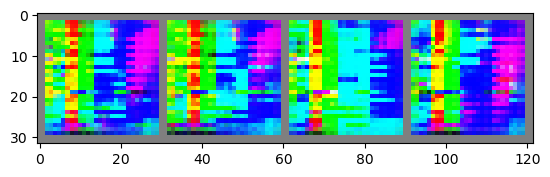

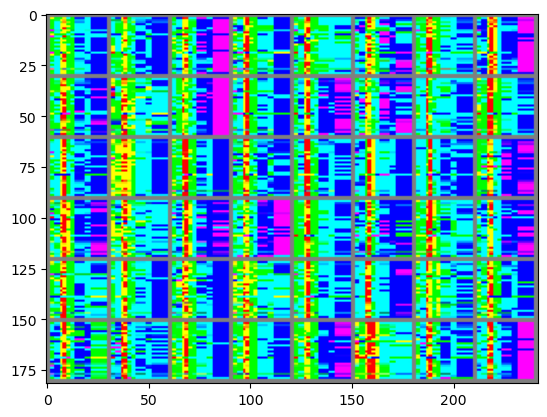

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 270/1000 Total Steps:1355	Loss_D : 0.545086	Loss_G : 2.983143	Loss_D_Mean : 0.545260	Loss_G_Mean : 1.839441	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 271/1000 Total Steps:1360	Loss_D : 0.331204	Loss_G : 1.551677	Loss_D_Mean : 0.365604	Loss_G_Mean : 1.855757	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 272/1000 Total Steps:1365	Loss_D : 0.381746	Loss_G : 1.856845	Loss_D_Mean : 0.340524	Loss_G_Mean : 1.805965	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 273/1000 Total Steps:1370	Loss_D : 0.300827	Loss_G : 1.682504	Loss_D_Mean : 0.306056	Loss_G_Mean : 1.886262	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 274/1000 Total Steps:1375	Loss_D : 0.271819	Loss_G : 1.547725	Loss_D_Mean : 0.256436	Loss_G_Mean : 2.074928	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 275/1000 Total Steps:1380	Loss_D : 0.503285	Loss_G : 3.500954	Loss_D_Mean : 0.361388	Loss_G_Mean : 2.286981	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 276/1000 Total Steps:1385	Loss_D : 1.066225	Loss_G : 5.014220	Loss_D_Mean : 0.496462	Loss_G_Mean : 2.441146	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 277/1000 Total Steps:1390	Loss_D : 0.290926	Loss_G : 2.497152	Loss_D_Mean : 0.632346	Loss_G_Mean : 2.377273	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 278/1000 Total Steps:1395	Loss_D : 0.415820	Loss_G : 2.319185	Loss_D_Mean : 0.448449	Loss_G_Mean : 1.872716	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 279/1000 Total Steps:1400	Loss_D : 0.529246	Loss_G : 1.995350	Loss_D_Mean : 0.434351	Loss_G_Mean : 1.834102	
Epoch: 280


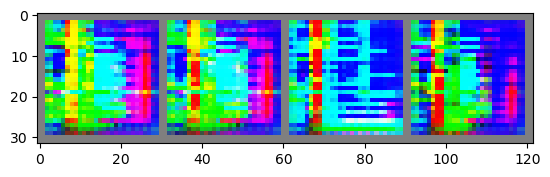

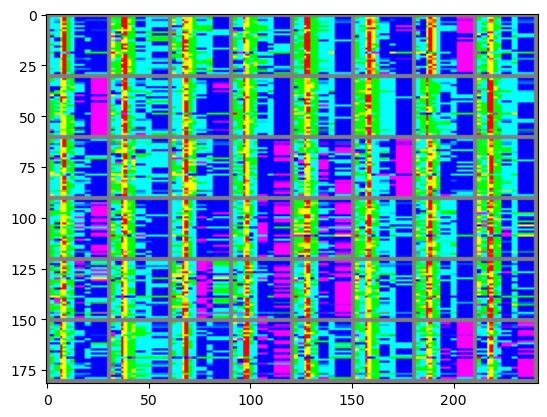

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 280/1000 Total Steps:1405	Loss_D : 0.570940	Loss_G : 1.356493	Loss_D_Mean : 0.434569	Loss_G_Mean : 1.877865	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 281/1000 Total Steps:1410	Loss_D : 0.371078	Loss_G : 2.254220	Loss_D_Mean : 0.315647	Loss_G_Mean : 2.034724	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 282/1000 Total Steps:1415	Loss_D : 0.403258	Loss_G : 2.330358	Loss_D_Mean : 0.380062	Loss_G_Mean : 1.794154	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 283/1000 Total Steps:1420	Loss_D : 0.344042	Loss_G : 2.632310	Loss_D_Mean : 0.371773	Loss_G_Mean : 1.981407	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 284/1000 Total Steps:1425	Loss_D : 0.265942	Loss_G : 1.496437	Loss_D_Mean : 0.300401	Loss_G_Mean : 1.855055	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 285/1000 Total Steps:1430	Loss_D : 0.630451	Loss_G : 1.875649	Loss_D_Mean : 0.380212	Loss_G_Mean : 2.181238	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 286/1000 Total Steps:1435	Loss_D : 0.361238	Loss_G : 1.994066	Loss_D_Mean : 0.279787	Loss_G_Mean : 1.956031	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 287/1000 Total Steps:1440	Loss_D : 0.450352	Loss_G : 2.292612	Loss_D_Mean : 0.374422	Loss_G_Mean : 1.836679	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 288/1000 Total Steps:1445	Loss_D : 0.345993	Loss_G : 1.601947	Loss_D_Mean : 0.370851	Loss_G_Mean : 1.692362	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 289/1000 Total Steps:1450	Loss_D : 0.406513	Loss_G : 2.189959	Loss_D_Mean : 0.393903	Loss_G_Mean : 1.690495	
Epoch: 290


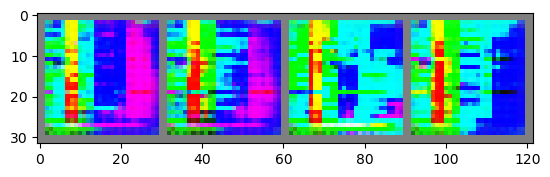

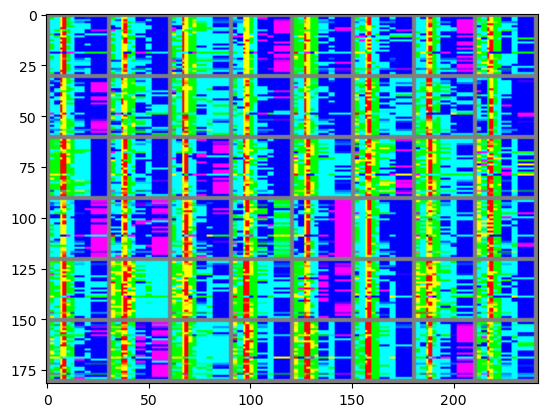

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 290/1000 Total Steps:1455	Loss_D : 0.743829	Loss_G : 1.028967	Loss_D_Mean : 0.492372	Loss_G_Mean : 1.901642	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 291/1000 Total Steps:1460	Loss_D : 0.317575	Loss_G : 1.916525	Loss_D_Mean : 0.382928	Loss_G_Mean : 1.679322	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 292/1000 Total Steps:1465	Loss_D : 0.446008	Loss_G : 2.144184	Loss_D_Mean : 0.375888	Loss_G_Mean : 1.917482	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 293/1000 Total Steps:1470	Loss_D : 0.360735	Loss_G : 2.360862	Loss_D_Mean : 0.389254	Loss_G_Mean : 1.835264	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 294/1000 Total Steps:1475	Loss_D : 0.231865	Loss_G : 2.476871	Loss_D_Mean : 0.264142	Loss_G_Mean : 2.115889	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 295/1000 Total Steps:1480	Loss_D : 0.472229	Loss_G : 2.345409	Loss_D_Mean : 0.469895	Loss_G_Mean : 1.958483	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 296/1000 Total Steps:1485	Loss_D : 0.241727	Loss_G : 1.790459	Loss_D_Mean : 0.278843	Loss_G_Mean : 2.079382	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 297/1000 Total Steps:1490	Loss_D : 0.315654	Loss_G : 2.530314	Loss_D_Mean : 0.256085	Loss_G_Mean : 2.096173	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 298/1000 Total Steps:1495	Loss_D : 0.293210	Loss_G : 2.492638	Loss_D_Mean : 0.274681	Loss_G_Mean : 2.024716	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 299/1000 Total Steps:1500	Loss_D : 0.346994	Loss_G : 1.518362	Loss_D_Mean : 0.314702	Loss_G_Mean : 1.780764	
Epoch: 300


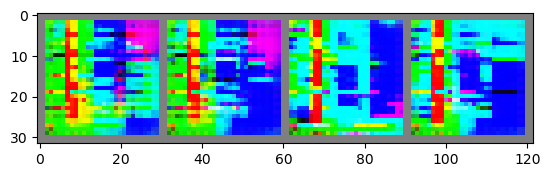

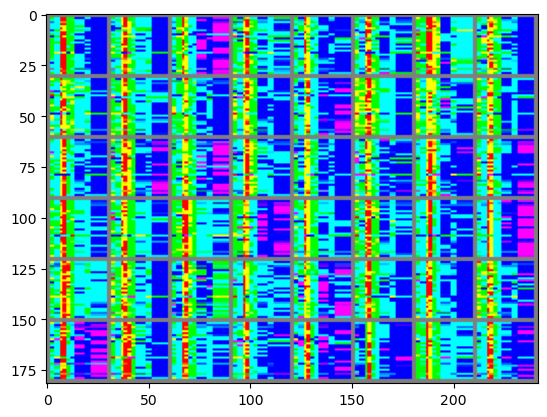

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 300/1000 Total Steps:1505	Loss_D : 0.272262	Loss_G : 1.710460	Loss_D_Mean : 0.332594	Loss_G_Mean : 1.815102	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 301/1000 Total Steps:1510	Loss_D : 0.273276	Loss_G : 1.204502	Loss_D_Mean : 0.263298	Loss_G_Mean : 2.055402	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 302/1000 Total Steps:1515	Loss_D : 0.226234	Loss_G : 1.721549	Loss_D_Mean : 0.274688	Loss_G_Mean : 2.153266	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 303/1000 Total Steps:1520	Loss_D : 0.404137	Loss_G : 1.002237	Loss_D_Mean : 0.303311	Loss_G_Mean : 1.926517	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 304/1000 Total Steps:1525	Loss_D : 0.590208	Loss_G : 0.846322	Loss_D_Mean : 0.620970	Loss_G_Mean : 2.278636	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 305/1000 Total Steps:1530	Loss_D : 0.453904	Loss_G : 2.613581	Loss_D_Mean : 0.407978	Loss_G_Mean : 1.974850	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 306/1000 Total Steps:1535	Loss_D : 0.446291	Loss_G : 1.373621	Loss_D_Mean : 0.460253	Loss_G_Mean : 1.715725	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 307/1000 Total Steps:1540	Loss_D : 0.447586	Loss_G : 1.524795	Loss_D_Mean : 0.454669	Loss_G_Mean : 2.017871	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 308/1000 Total Steps:1545	Loss_D : 0.464002	Loss_G : 2.241174	Loss_D_Mean : 0.412389	Loss_G_Mean : 1.756679	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 309/1000 Total Steps:1550	Loss_D : 0.380974	Loss_G : 2.795701	Loss_D_Mean : 0.378555	Loss_G_Mean : 1.970288	
Epoch: 310


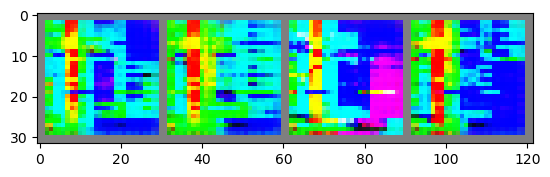

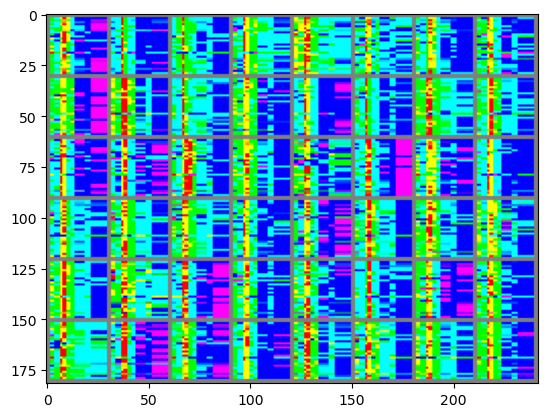

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 310/1000 Total Steps:1555	Loss_D : 0.386194	Loss_G : 2.064911	Loss_D_Mean : 0.401169	Loss_G_Mean : 1.732668	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 311/1000 Total Steps:1560	Loss_D : 0.289111	Loss_G : 1.371045	Loss_D_Mean : 0.334862	Loss_G_Mean : 1.847068	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 312/1000 Total Steps:1565	Loss_D : 0.248420	Loss_G : 2.066270	Loss_D_Mean : 0.284620	Loss_G_Mean : 2.041231	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 313/1000 Total Steps:1570	Loss_D : 0.283632	Loss_G : 2.335449	Loss_D_Mean : 0.288155	Loss_G_Mean : 1.850766	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 314/1000 Total Steps:1575	Loss_D : 0.241271	Loss_G : 2.945156	Loss_D_Mean : 0.289055	Loss_G_Mean : 2.121458	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 315/1000 Total Steps:1580	Loss_D : 0.362103	Loss_G : 0.893664	Loss_D_Mean : 0.372139	Loss_G_Mean : 1.857109	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 316/1000 Total Steps:1585	Loss_D : 0.330258	Loss_G : 2.095973	Loss_D_Mean : 0.390854	Loss_G_Mean : 1.995719	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 317/1000 Total Steps:1590	Loss_D : 0.320402	Loss_G : 2.123993	Loss_D_Mean : 0.423559	Loss_G_Mean : 1.827436	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 318/1000 Total Steps:1595	Loss_D : 0.406280	Loss_G : 1.209064	Loss_D_Mean : 0.429290	Loss_G_Mean : 1.788796	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 319/1000 Total Steps:1600	Loss_D : 0.315502	Loss_G : 1.432055	Loss_D_Mean : 0.359039	Loss_G_Mean : 1.957728	
Epoch: 320


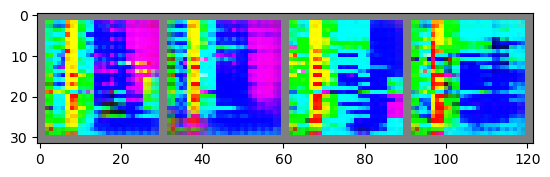

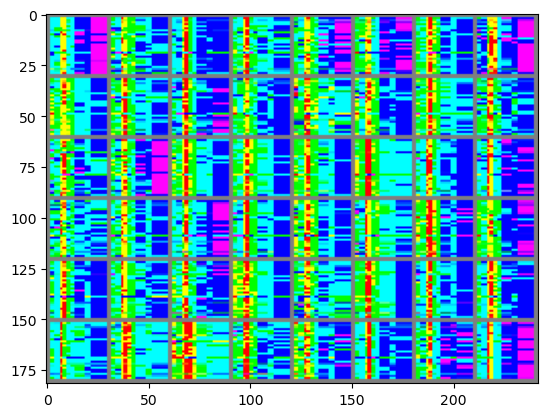

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 320/1000 Total Steps:1605	Loss_D : 0.328784	Loss_G : 2.042087	Loss_D_Mean : 0.354857	Loss_G_Mean : 2.064094	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 321/1000 Total Steps:1610	Loss_D : 0.404706	Loss_G : 1.490489	Loss_D_Mean : 0.382834	Loss_G_Mean : 1.837539	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 322/1000 Total Steps:1615	Loss_D : 0.791346	Loss_G : 4.394952	Loss_D_Mean : 0.420520	Loss_G_Mean : 2.277869	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 323/1000 Total Steps:1620	Loss_D : 0.319631	Loss_G : 2.072701	Loss_D_Mean : 0.497095	Loss_G_Mean : 2.073419	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 324/1000 Total Steps:1625	Loss_D : 0.462383	Loss_G : 2.777270	Loss_D_Mean : 0.406253	Loss_G_Mean : 1.940207	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 325/1000 Total Steps:1630	Loss_D : 0.389526	Loss_G : 1.214533	Loss_D_Mean : 0.393864	Loss_G_Mean : 1.604460	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 326/1000 Total Steps:1635	Loss_D : 0.322124	Loss_G : 3.014363	Loss_D_Mean : 0.383410	Loss_G_Mean : 2.161856	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 327/1000 Total Steps:1640	Loss_D : 0.410666	Loss_G : 1.229771	Loss_D_Mean : 0.431750	Loss_G_Mean : 1.807802	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 328/1000 Total Steps:1645	Loss_D : 0.369756	Loss_G : 1.556045	Loss_D_Mean : 0.351968	Loss_G_Mean : 1.917309	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 329/1000 Total Steps:1650	Loss_D : 0.407004	Loss_G : 2.711964	Loss_D_Mean : 0.311237	Loss_G_Mean : 2.054709	
Epoch: 330


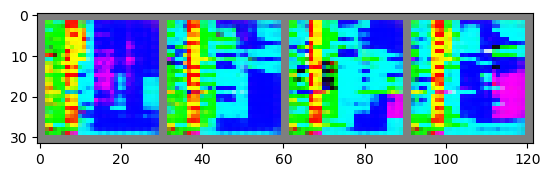

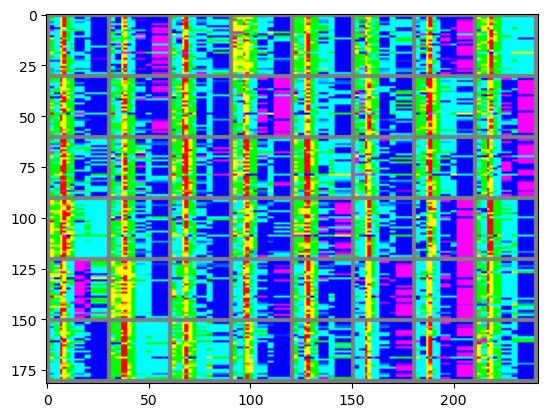

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 330/1000 Total Steps:1655	Loss_D : 0.277376	Loss_G : 1.400998	Loss_D_Mean : 0.290071	Loss_G_Mean : 1.880367	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 331/1000 Total Steps:1660	Loss_D : 0.579011	Loss_G : 3.263282	Loss_D_Mean : 0.342441	Loss_G_Mean : 2.192763	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 332/1000 Total Steps:1665	Loss_D : 0.296650	Loss_G : 1.513893	Loss_D_Mean : 0.334157	Loss_G_Mean : 1.839370	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 333/1000 Total Steps:1670	Loss_D : 0.620842	Loss_G : 3.523155	Loss_D_Mean : 0.411488	Loss_G_Mean : 2.039849	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 334/1000 Total Steps:1675	Loss_D : 0.260365	Loss_G : 1.823167	Loss_D_Mean : 0.464273	Loss_G_Mean : 1.777570	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 335/1000 Total Steps:1680	Loss_D : 0.322786	Loss_G : 1.687175	Loss_D_Mean : 0.351322	Loss_G_Mean : 1.735006	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 336/1000 Total Steps:1685	Loss_D : 0.444424	Loss_G : 2.761734	Loss_D_Mean : 0.352397	Loss_G_Mean : 2.021524	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 337/1000 Total Steps:1690	Loss_D : 0.265418	Loss_G : 1.614136	Loss_D_Mean : 0.279264	Loss_G_Mean : 1.852265	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 338/1000 Total Steps:1695	Loss_D : 0.300585	Loss_G : 1.206269	Loss_D_Mean : 0.277584	Loss_G_Mean : 1.910019	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 339/1000 Total Steps:1700	Loss_D : 0.308374	Loss_G : 1.591394	Loss_D_Mean : 0.318251	Loss_G_Mean : 2.096172	
Epoch: 340


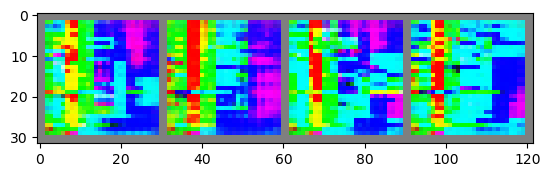

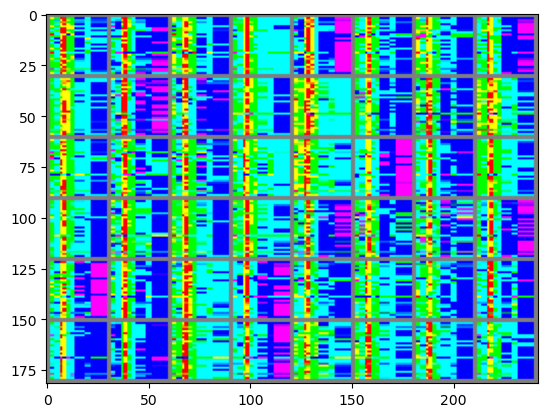

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 340/1000 Total Steps:1705	Loss_D : 0.477062	Loss_G : 0.825969	Loss_D_Mean : 0.347210	Loss_G_Mean : 1.773795	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 341/1000 Total Steps:1710	Loss_D : 0.301322	Loss_G : 1.791484	Loss_D_Mean : 0.352259	Loss_G_Mean : 2.002568	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 342/1000 Total Steps:1715	Loss_D : 0.280185	Loss_G : 2.095492	Loss_D_Mean : 0.294293	Loss_G_Mean : 1.929062	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 343/1000 Total Steps:1720	Loss_D : 0.378755	Loss_G : 1.223183	Loss_D_Mean : 0.318629	Loss_G_Mean : 1.685119	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 344/1000 Total Steps:1725	Loss_D : 0.391424	Loss_G : 1.451077	Loss_D_Mean : 0.462187	Loss_G_Mean : 2.026076	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 345/1000 Total Steps:1730	Loss_D : 0.771213	Loss_G : 1.536542	Loss_D_Mean : 0.447703	Loss_G_Mean : 2.009887	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 346/1000 Total Steps:1735	Loss_D : 0.344083	Loss_G : 1.816443	Loss_D_Mean : 0.309292	Loss_G_Mean : 1.809552	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 347/1000 Total Steps:1740	Loss_D : 0.223564	Loss_G : 2.117287	Loss_D_Mean : 0.244708	Loss_G_Mean : 1.975051	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 348/1000 Total Steps:1745	Loss_D : 0.207240	Loss_G : 2.119840	Loss_D_Mean : 0.224987	Loss_G_Mean : 2.019296	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 349/1000 Total Steps:1750	Loss_D : 0.428627	Loss_G : 2.757461	Loss_D_Mean : 0.311002	Loss_G_Mean : 2.128730	
Epoch: 350


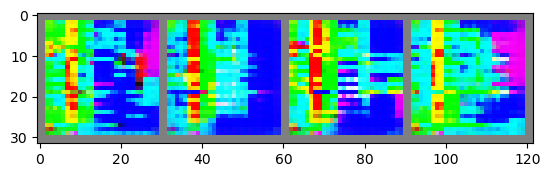

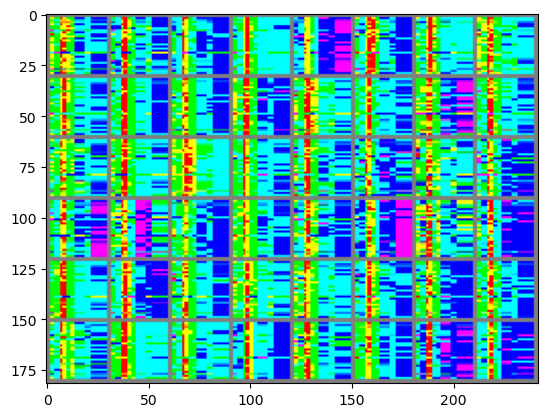

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 350/1000 Total Steps:1755	Loss_D : 0.521934	Loss_G : 1.677065	Loss_D_Mean : 0.469393	Loss_G_Mean : 1.594859	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 351/1000 Total Steps:1760	Loss_D : 0.495785	Loss_G : 1.792803	Loss_D_Mean : 0.602533	Loss_G_Mean : 1.890787	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 352/1000 Total Steps:1765	Loss_D : 0.461146	Loss_G : 1.078975	Loss_D_Mean : 0.346765	Loss_G_Mean : 1.867454	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 353/1000 Total Steps:1770	Loss_D : 0.320855	Loss_G : 1.701843	Loss_D_Mean : 0.343488	Loss_G_Mean : 1.863197	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 354/1000 Total Steps:1775	Loss_D : 0.296056	Loss_G : 2.039180	Loss_D_Mean : 0.317545	Loss_G_Mean : 1.890939	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 355/1000 Total Steps:1780	Loss_D : 0.438614	Loss_G : 1.028905	Loss_D_Mean : 0.382768	Loss_G_Mean : 1.704319	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 356/1000 Total Steps:1785	Loss_D : 0.305290	Loss_G : 1.444006	Loss_D_Mean : 0.462283	Loss_G_Mean : 1.946837	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 357/1000 Total Steps:1790	Loss_D : 0.358891	Loss_G : 3.526788	Loss_D_Mean : 0.282372	Loss_G_Mean : 2.359161	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 358/1000 Total Steps:1795	Loss_D : 0.460609	Loss_G : 2.101114	Loss_D_Mean : 0.412263	Loss_G_Mean : 1.856451	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 359/1000 Total Steps:1800	Loss_D : 0.367727	Loss_G : 1.188056	Loss_D_Mean : 0.368865	Loss_G_Mean : 1.937207	
Epoch: 360


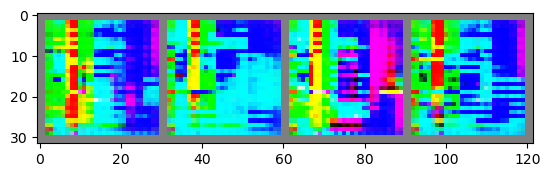

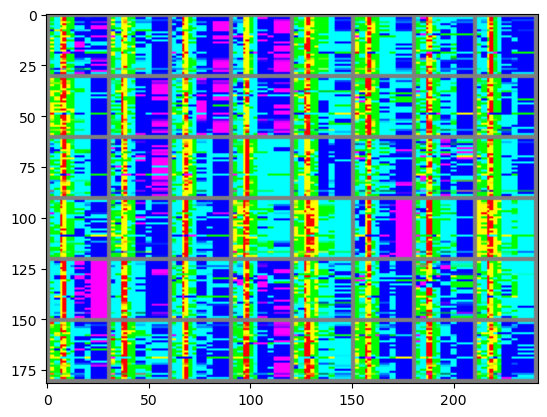

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 360/1000 Total Steps:1805	Loss_D : 0.651795	Loss_G : 2.641129	Loss_D_Mean : 0.412180	Loss_G_Mean : 1.977158	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 361/1000 Total Steps:1810	Loss_D : 0.408255	Loss_G : 1.683681	Loss_D_Mean : 0.448352	Loss_G_Mean : 1.987194	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 362/1000 Total Steps:1815	Loss_D : 0.366957	Loss_G : 1.964236	Loss_D_Mean : 0.374817	Loss_G_Mean : 2.274477	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 363/1000 Total Steps:1820	Loss_D : 0.244723	Loss_G : 1.799742	Loss_D_Mean : 0.329930	Loss_G_Mean : 1.830526	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 364/1000 Total Steps:1825	Loss_D : 0.231732	Loss_G : 1.701797	Loss_D_Mean : 0.315229	Loss_G_Mean : 2.225371	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 365/1000 Total Steps:1830	Loss_D : 0.334250	Loss_G : 3.174278	Loss_D_Mean : 0.309511	Loss_G_Mean : 2.209742	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 366/1000 Total Steps:1835	Loss_D : 0.298323	Loss_G : 1.964870	Loss_D_Mean : 0.287800	Loss_G_Mean : 2.082001	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 367/1000 Total Steps:1840	Loss_D : 0.303450	Loss_G : 1.869430	Loss_D_Mean : 0.343386	Loss_G_Mean : 2.104722	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 368/1000 Total Steps:1845	Loss_D : 0.329103	Loss_G : 2.341961	Loss_D_Mean : 0.407054	Loss_G_Mean : 1.950680	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 369/1000 Total Steps:1850	Loss_D : 0.354065	Loss_G : 2.238506	Loss_D_Mean : 0.321807	Loss_G_Mean : 1.836943	
Epoch: 370


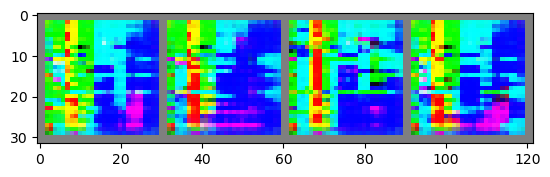

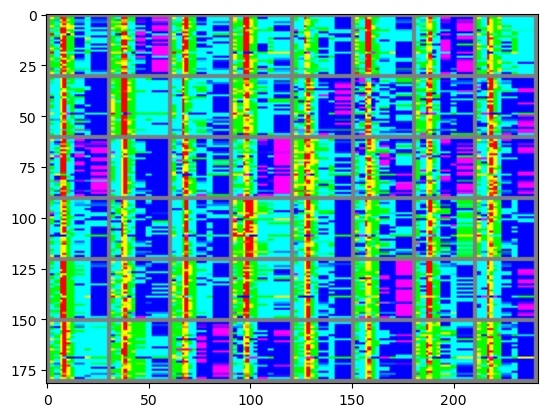

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 370/1000 Total Steps:1855	Loss_D : 0.316644	Loss_G : 2.179440	Loss_D_Mean : 0.330810	Loss_G_Mean : 1.927173	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 371/1000 Total Steps:1860	Loss_D : 0.450244	Loss_G : 3.209676	Loss_D_Mean : 0.339576	Loss_G_Mean : 1.952847	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 372/1000 Total Steps:1865	Loss_D : 0.276408	Loss_G : 1.560019	Loss_D_Mean : 0.295494	Loss_G_Mean : 1.888127	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 373/1000 Total Steps:1870	Loss_D : 0.253497	Loss_G : 2.332820	Loss_D_Mean : 0.290321	Loss_G_Mean : 2.105691	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 374/1000 Total Steps:1875	Loss_D : 0.329080	Loss_G : 2.179057	Loss_D_Mean : 0.316737	Loss_G_Mean : 2.000215	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 375/1000 Total Steps:1880	Loss_D : 0.252362	Loss_G : 1.709133	Loss_D_Mean : 0.305457	Loss_G_Mean : 1.962282	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 376/1000 Total Steps:1885	Loss_D : 0.248693	Loss_G : 2.554707	Loss_D_Mean : 0.247471	Loss_G_Mean : 2.129413	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 377/1000 Total Steps:1890	Loss_D : 0.183494	Loss_G : 1.951055	Loss_D_Mean : 0.210728	Loss_G_Mean : 2.191306	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 378/1000 Total Steps:1895	Loss_D : 0.285267	Loss_G : 2.628953	Loss_D_Mean : 0.267275	Loss_G_Mean : 2.201817	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 379/1000 Total Steps:1900	Loss_D : 0.236483	Loss_G : 2.212730	Loss_D_Mean : 0.243635	Loss_G_Mean : 2.262915	
Epoch: 380


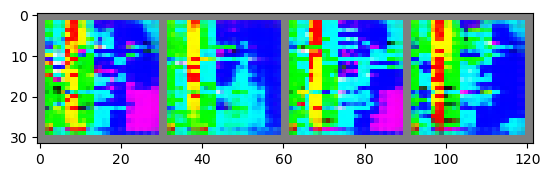

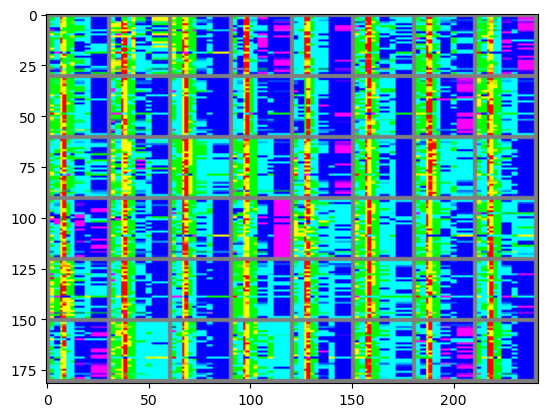

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 380/1000 Total Steps:1905	Loss_D : 0.926966	Loss_G : 0.634106	Loss_D_Mean : 0.444960	Loss_G_Mean : 1.982237	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 381/1000 Total Steps:1910	Loss_D : 0.372146	Loss_G : 2.340298	Loss_D_Mean : 0.620359	Loss_G_Mean : 2.511353	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 382/1000 Total Steps:1915	Loss_D : 0.371787	Loss_G : 1.573844	Loss_D_Mean : 0.346808	Loss_G_Mean : 2.128594	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 383/1000 Total Steps:1920	Loss_D : 0.346258	Loss_G : 2.212805	Loss_D_Mean : 0.309753	Loss_G_Mean : 1.958531	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 384/1000 Total Steps:1925	Loss_D : 0.299866	Loss_G : 2.859965	Loss_D_Mean : 0.398399	Loss_G_Mean : 2.050030	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 385/1000 Total Steps:1930	Loss_D : 0.215416	Loss_G : 1.733244	Loss_D_Mean : 0.262144	Loss_G_Mean : 1.900408	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 386/1000 Total Steps:1935	Loss_D : 0.404100	Loss_G : 3.295612	Loss_D_Mean : 0.318859	Loss_G_Mean : 2.219152	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 387/1000 Total Steps:1940	Loss_D : 0.309291	Loss_G : 1.828114	Loss_D_Mean : 0.354119	Loss_G_Mean : 1.815403	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 388/1000 Total Steps:1945	Loss_D : 0.416590	Loss_G : 1.228903	Loss_D_Mean : 0.337844	Loss_G_Mean : 1.950101	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 389/1000 Total Steps:1950	Loss_D : 0.349372	Loss_G : 2.982624	Loss_D_Mean : 0.355586	Loss_G_Mean : 2.203125	
Epoch: 390


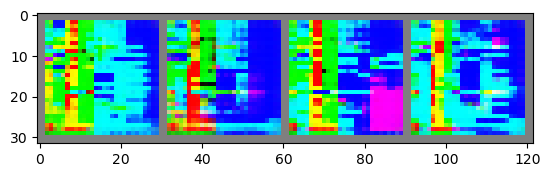

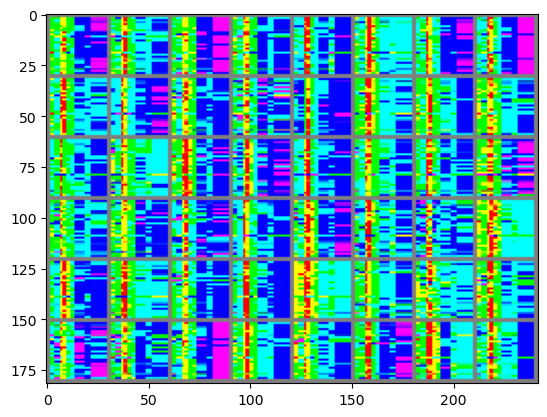

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 390/1000 Total Steps:1955	Loss_D : 0.252589	Loss_G : 1.591207	Loss_D_Mean : 0.307573	Loss_G_Mean : 1.825853	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 391/1000 Total Steps:1960	Loss_D : 0.398354	Loss_G : 1.427831	Loss_D_Mean : 0.342922	Loss_G_Mean : 1.990920	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 392/1000 Total Steps:1965	Loss_D : 0.202119	Loss_G : 1.763982	Loss_D_Mean : 0.261281	Loss_G_Mean : 2.024153	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 393/1000 Total Steps:1970	Loss_D : 0.343028	Loss_G : 1.776626	Loss_D_Mean : 0.270611	Loss_G_Mean : 2.119685	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 394/1000 Total Steps:1975	Loss_D : 0.339323	Loss_G : 1.514169	Loss_D_Mean : 0.320439	Loss_G_Mean : 1.897667	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 395/1000 Total Steps:1980	Loss_D : 0.394251	Loss_G : 1.537513	Loss_D_Mean : 0.297374	Loss_G_Mean : 2.214669	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 396/1000 Total Steps:1985	Loss_D : 0.415422	Loss_G : 3.911283	Loss_D_Mean : 0.359590	Loss_G_Mean : 2.430122	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 397/1000 Total Steps:1990	Loss_D : 0.403118	Loss_G : 1.997960	Loss_D_Mean : 0.507509	Loss_G_Mean : 1.939892	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 398/1000 Total Steps:1995	Loss_D : 0.415895	Loss_G : 2.106438	Loss_D_Mean : 0.480912	Loss_G_Mean : 2.031429	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 399/1000 Total Steps:2000	Loss_D : 0.450671	Loss_G : 2.595182	Loss_D_Mean : 0.377930	Loss_G_Mean : 2.009233	
Epoch: 400


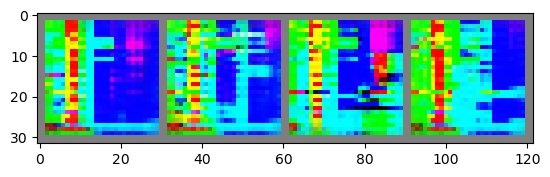

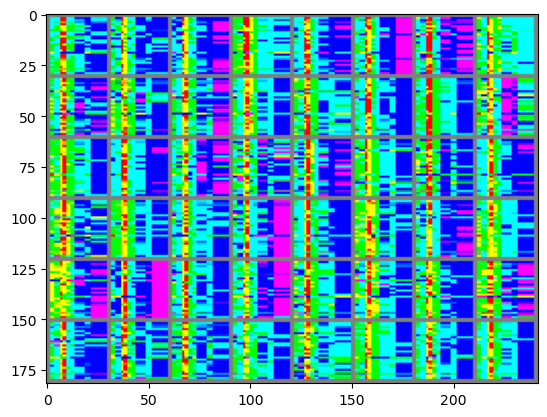

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 400/1000 Total Steps:2005	Loss_D : 0.300712	Loss_G : 1.483316	Loss_D_Mean : 0.430577	Loss_G_Mean : 2.013898	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 401/1000 Total Steps:2010	Loss_D : 0.493120	Loss_G : 1.204702	Loss_D_Mean : 0.440320	Loss_G_Mean : 2.035077	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 402/1000 Total Steps:2015	Loss_D : 0.400337	Loss_G : 3.186636	Loss_D_Mean : 0.425330	Loss_G_Mean : 2.147422	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 403/1000 Total Steps:2020	Loss_D : 0.366074	Loss_G : 1.138346	Loss_D_Mean : 0.370791	Loss_G_Mean : 1.897572	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 404/1000 Total Steps:2025	Loss_D : 0.341976	Loss_G : 3.168796	Loss_D_Mean : 0.343605	Loss_G_Mean : 2.381517	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 405/1000 Total Steps:2030	Loss_D : 0.308950	Loss_G : 1.978170	Loss_D_Mean : 0.374620	Loss_G_Mean : 1.817375	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 406/1000 Total Steps:2035	Loss_D : 0.226648	Loss_G : 2.163675	Loss_D_Mean : 0.284945	Loss_G_Mean : 2.049757	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 407/1000 Total Steps:2040	Loss_D : 0.183580	Loss_G : 2.599101	Loss_D_Mean : 0.212969	Loss_G_Mean : 2.245005	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 408/1000 Total Steps:2045	Loss_D : 0.367690	Loss_G : 2.817336	Loss_D_Mean : 0.252064	Loss_G_Mean : 2.309406	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 409/1000 Total Steps:2050	Loss_D : 0.225370	Loss_G : 2.207721	Loss_D_Mean : 0.287822	Loss_G_Mean : 1.948369	
Epoch: 410


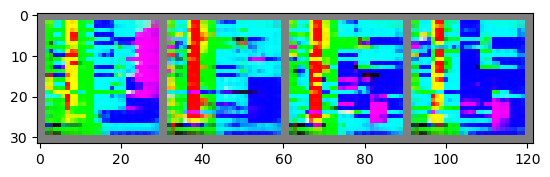

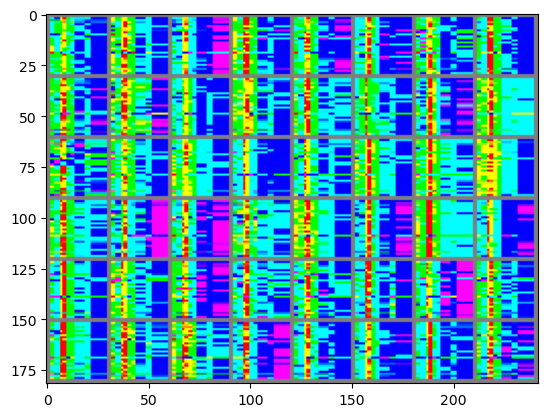

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 410/1000 Total Steps:2055	Loss_D : 0.229585	Loss_G : 1.831443	Loss_D_Mean : 0.211650	Loss_G_Mean : 2.043444	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 411/1000 Total Steps:2060	Loss_D : 0.236948	Loss_G : 1.823394	Loss_D_Mean : 0.256691	Loss_G_Mean : 2.439736	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 412/1000 Total Steps:2065	Loss_D : 0.222077	Loss_G : 2.191587	Loss_D_Mean : 0.232065	Loss_G_Mean : 2.253192	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 413/1000 Total Steps:2070	Loss_D : 0.289164	Loss_G : 1.744865	Loss_D_Mean : 0.268558	Loss_G_Mean : 1.957316	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 414/1000 Total Steps:2075	Loss_D : 0.364390	Loss_G : 1.100755	Loss_D_Mean : 0.272089	Loss_G_Mean : 1.944601	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 415/1000 Total Steps:2080	Loss_D : 0.609734	Loss_G : 3.013435	Loss_D_Mean : 0.414334	Loss_G_Mean : 2.186222	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 416/1000 Total Steps:2085	Loss_D : 0.278768	Loss_G : 1.698843	Loss_D_Mean : 0.308769	Loss_G_Mean : 1.878510	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 417/1000 Total Steps:2090	Loss_D : 0.214338	Loss_G : 2.209363	Loss_D_Mean : 0.253499	Loss_G_Mean : 2.091375	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 418/1000 Total Steps:2095	Loss_D : 0.338508	Loss_G : 1.609526	Loss_D_Mean : 0.269975	Loss_G_Mean : 2.065535	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 419/1000 Total Steps:2100	Loss_D : 0.374403	Loss_G : 3.874447	Loss_D_Mean : 0.267647	Loss_G_Mean : 2.574051	
Epoch: 420


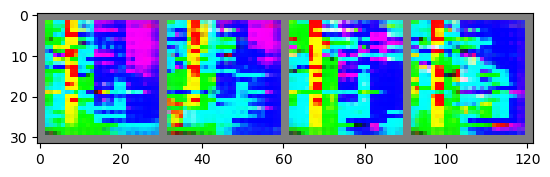

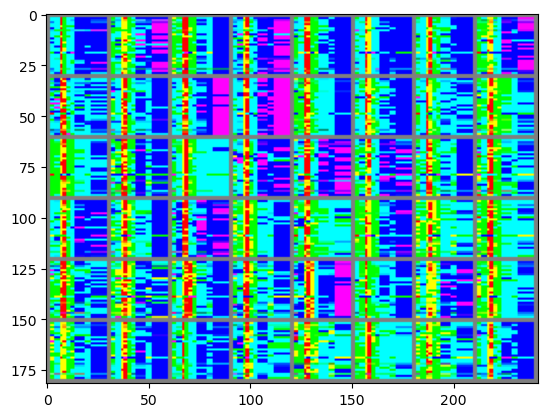

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 420/1000 Total Steps:2105	Loss_D : 0.235239	Loss_G : 1.789467	Loss_D_Mean : 0.413255	Loss_G_Mean : 2.001393	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 421/1000 Total Steps:2110	Loss_D : 0.253818	Loss_G : 3.484853	Loss_D_Mean : 0.254893	Loss_G_Mean : 2.357549	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 422/1000 Total Steps:2115	Loss_D : 0.268578	Loss_G : 1.407587	Loss_D_Mean : 0.269069	Loss_G_Mean : 2.113589	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 423/1000 Total Steps:2120	Loss_D : 0.190458	Loss_G : 1.838788	Loss_D_Mean : 0.304810	Loss_G_Mean : 2.302410	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 424/1000 Total Steps:2125	Loss_D : 0.393187	Loss_G : 1.406693	Loss_D_Mean : 0.410443	Loss_G_Mean : 2.279310	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 425/1000 Total Steps:2130	Loss_D : 0.373284	Loss_G : 4.107693	Loss_D_Mean : 0.355843	Loss_G_Mean : 2.836800	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 426/1000 Total Steps:2135	Loss_D : 0.270841	Loss_G : 1.500394	Loss_D_Mean : 0.624347	Loss_G_Mean : 1.896111	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 427/1000 Total Steps:2140	Loss_D : 0.399333	Loss_G : 3.078851	Loss_D_Mean : 0.293439	Loss_G_Mean : 2.236036	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 428/1000 Total Steps:2145	Loss_D : 0.274140	Loss_G : 2.150141	Loss_D_Mean : 0.331960	Loss_G_Mean : 1.937327	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 429/1000 Total Steps:2150	Loss_D : 0.293850	Loss_G : 2.003323	Loss_D_Mean : 0.280849	Loss_G_Mean : 2.051761	
Epoch: 430


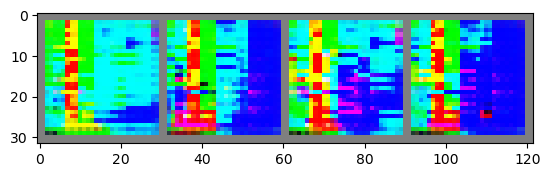

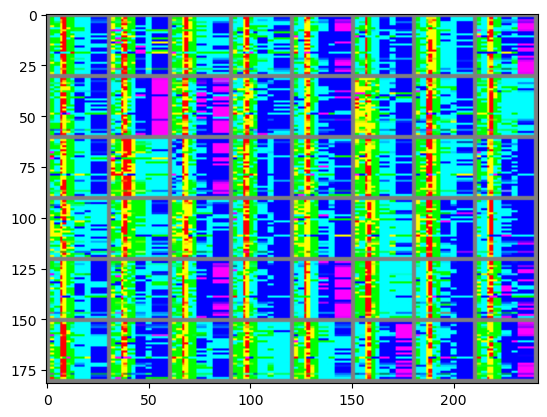

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 430/1000 Total Steps:2155	Loss_D : 0.237321	Loss_G : 1.496614	Loss_D_Mean : 0.263824	Loss_G_Mean : 1.972217	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 431/1000 Total Steps:2160	Loss_D : 0.178855	Loss_G : 2.556186	Loss_D_Mean : 0.267311	Loss_G_Mean : 2.370056	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 432/1000 Total Steps:2165	Loss_D : 0.264365	Loss_G : 2.290535	Loss_D_Mean : 0.216375	Loss_G_Mean : 2.194047	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 433/1000 Total Steps:2170	Loss_D : 0.225157	Loss_G : 3.032838	Loss_D_Mean : 0.233668	Loss_G_Mean : 2.211363	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 434/1000 Total Steps:2175	Loss_D : 0.344664	Loss_G : 3.113108	Loss_D_Mean : 0.313614	Loss_G_Mean : 2.254161	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 435/1000 Total Steps:2180	Loss_D : 0.302264	Loss_G : 1.714485	Loss_D_Mean : 0.255135	Loss_G_Mean : 2.258779	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 436/1000 Total Steps:2185	Loss_D : 0.310331	Loss_G : 2.657832	Loss_D_Mean : 0.266881	Loss_G_Mean : 2.364394	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 437/1000 Total Steps:2190	Loss_D : 0.477929	Loss_G : 3.670718	Loss_D_Mean : 0.360656	Loss_G_Mean : 2.284023	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 438/1000 Total Steps:2195	Loss_D : 0.302064	Loss_G : 2.196682	Loss_D_Mean : 0.360450	Loss_G_Mean : 2.068054	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 439/1000 Total Steps:2200	Loss_D : 0.308053	Loss_G : 2.203229	Loss_D_Mean : 0.306656	Loss_G_Mean : 2.315354	
Epoch: 440


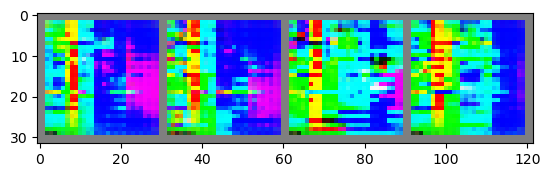

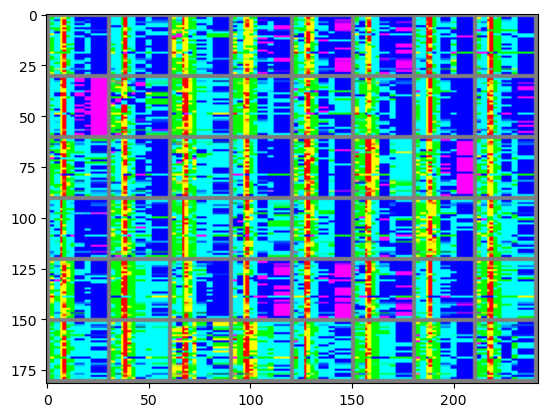

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 440/1000 Total Steps:2205	Loss_D : 0.278403	Loss_G : 2.356522	Loss_D_Mean : 0.292572	Loss_G_Mean : 2.078092	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 441/1000 Total Steps:2210	Loss_D : 0.296096	Loss_G : 2.192083	Loss_D_Mean : 0.361859	Loss_G_Mean : 1.901578	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 442/1000 Total Steps:2215	Loss_D : 0.221988	Loss_G : 2.410906	Loss_D_Mean : 0.266466	Loss_G_Mean : 2.210457	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 443/1000 Total Steps:2220	Loss_D : 0.408426	Loss_G : 3.132379	Loss_D_Mean : 0.292604	Loss_G_Mean : 2.264066	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 444/1000 Total Steps:2225	Loss_D : 0.350249	Loss_G : 2.469604	Loss_D_Mean : 0.329211	Loss_G_Mean : 2.169437	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 445/1000 Total Steps:2230	Loss_D : 0.212557	Loss_G : 2.570340	Loss_D_Mean : 0.220837	Loss_G_Mean : 2.295923	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 446/1000 Total Steps:2235	Loss_D : 0.378739	Loss_G : 3.095478	Loss_D_Mean : 0.333390	Loss_G_Mean : 2.653210	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 447/1000 Total Steps:2240	Loss_D : 0.260787	Loss_G : 2.284019	Loss_D_Mean : 0.198752	Loss_G_Mean : 2.287172	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 448/1000 Total Steps:2245	Loss_D : 0.237484	Loss_G : 2.987379	Loss_D_Mean : 0.259579	Loss_G_Mean : 2.418271	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 449/1000 Total Steps:2250	Loss_D : 0.244854	Loss_G : 2.084363	Loss_D_Mean : 0.303454	Loss_G_Mean : 2.118264	
Epoch: 450


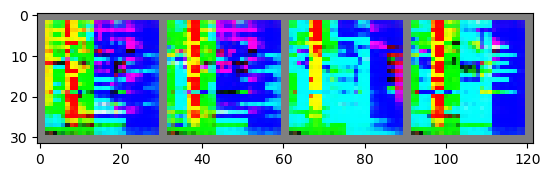

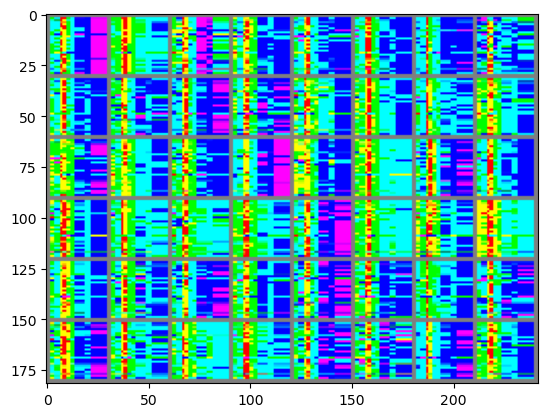

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 450/1000 Total Steps:2255	Loss_D : 0.344512	Loss_G : 1.814380	Loss_D_Mean : 0.310348	Loss_G_Mean : 2.472797	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 451/1000 Total Steps:2260	Loss_D : 0.691482	Loss_G : 4.754980	Loss_D_Mean : 0.336623	Loss_G_Mean : 2.793309	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 452/1000 Total Steps:2265	Loss_D : 0.361079	Loss_G : 1.656642	Loss_D_Mean : 0.390687	Loss_G_Mean : 2.459277	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 453/1000 Total Steps:2270	Loss_D : 0.405214	Loss_G : 3.061181	Loss_D_Mean : 0.362609	Loss_G_Mean : 2.175093	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 454/1000 Total Steps:2275	Loss_D : 0.785092	Loss_G : 3.996246	Loss_D_Mean : 0.436907	Loss_G_Mean : 2.419079	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 455/1000 Total Steps:2280	Loss_D : 0.271856	Loss_G : 2.811151	Loss_D_Mean : 0.291632	Loss_G_Mean : 2.370235	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 456/1000 Total Steps:2285	Loss_D : 0.234812	Loss_G : 2.305712	Loss_D_Mean : 0.241562	Loss_G_Mean : 2.199223	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 457/1000 Total Steps:2290	Loss_D : 0.203835	Loss_G : 2.299536	Loss_D_Mean : 0.262885	Loss_G_Mean : 2.154119	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 458/1000 Total Steps:2295	Loss_D : 0.339001	Loss_G : 4.224313	Loss_D_Mean : 0.275848	Loss_G_Mean : 2.504425	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 459/1000 Total Steps:2300	Loss_D : 0.205937	Loss_G : 2.121581	Loss_D_Mean : 0.314123	Loss_G_Mean : 2.132159	
Epoch: 460


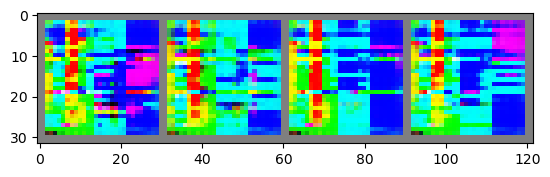

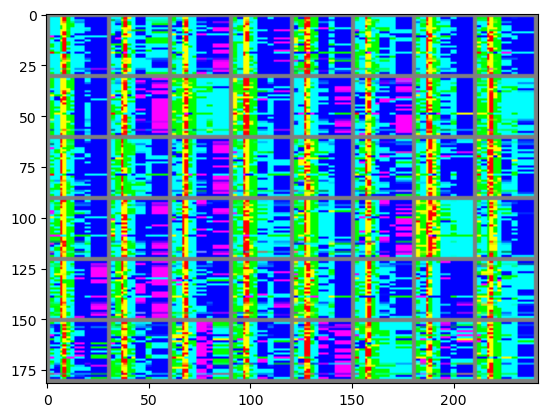

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 460/1000 Total Steps:2305	Loss_D : 0.213719	Loss_G : 2.618135	Loss_D_Mean : 0.256097	Loss_G_Mean : 2.682498	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 461/1000 Total Steps:2310	Loss_D : 0.287115	Loss_G : 2.600848	Loss_D_Mean : 0.215143	Loss_G_Mean : 2.517685	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 462/1000 Total Steps:2315	Loss_D : 0.234080	Loss_G : 1.783901	Loss_D_Mean : 0.253954	Loss_G_Mean : 2.238374	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 463/1000 Total Steps:2320	Loss_D : 0.267951	Loss_G : 2.552327	Loss_D_Mean : 0.304677	Loss_G_Mean : 2.698151	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 464/1000 Total Steps:2325	Loss_D : 0.272019	Loss_G : 3.425426	Loss_D_Mean : 0.247120	Loss_G_Mean : 2.537209	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 465/1000 Total Steps:2330	Loss_D : 0.262930	Loss_G : 1.529878	Loss_D_Mean : 0.288154	Loss_G_Mean : 2.197046	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 466/1000 Total Steps:2335	Loss_D : 1.616498	Loss_G : 2.285366	Loss_D_Mean : 0.638896	Loss_G_Mean : 2.953780	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 467/1000 Total Steps:2340	Loss_D : 0.281791	Loss_G : 1.451784	Loss_D_Mean : 0.307989	Loss_G_Mean : 1.996153	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 468/1000 Total Steps:2345	Loss_D : 0.215644	Loss_G : 2.781441	Loss_D_Mean : 0.242105	Loss_G_Mean : 2.362156	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 469/1000 Total Steps:2350	Loss_D : 0.332061	Loss_G : 2.270040	Loss_D_Mean : 0.282721	Loss_G_Mean : 2.053396	
Epoch: 470


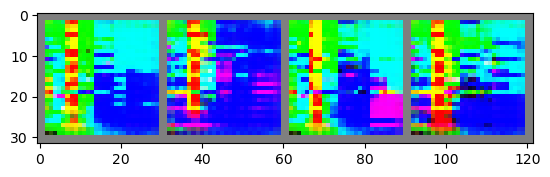

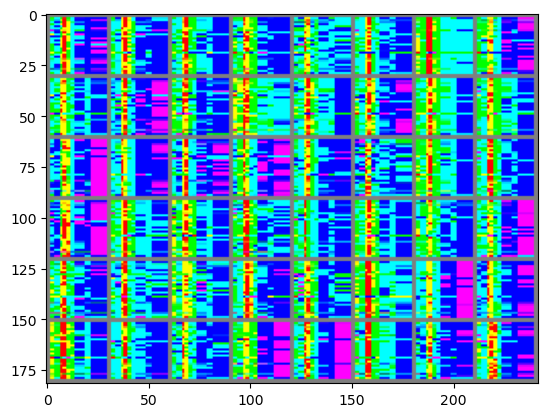

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 470/1000 Total Steps:2355	Loss_D : 0.305644	Loss_G : 1.490774	Loss_D_Mean : 0.356646	Loss_G_Mean : 2.008611	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 471/1000 Total Steps:2360	Loss_D : 0.281457	Loss_G : 1.995142	Loss_D_Mean : 0.274647	Loss_G_Mean : 2.167912	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 472/1000 Total Steps:2365	Loss_D : 0.441116	Loss_G : 3.220980	Loss_D_Mean : 0.412244	Loss_G_Mean : 2.085004	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 473/1000 Total Steps:2370	Loss_D : 0.209517	Loss_G : 1.888132	Loss_D_Mean : 0.354890	Loss_G_Mean : 1.832830	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 474/1000 Total Steps:2375	Loss_D : 0.383923	Loss_G : 1.233477	Loss_D_Mean : 0.284511	Loss_G_Mean : 1.853006	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 475/1000 Total Steps:2380	Loss_D : 0.260226	Loss_G : 3.239559	Loss_D_Mean : 0.318995	Loss_G_Mean : 2.516210	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 476/1000 Total Steps:2385	Loss_D : 0.371793	Loss_G : 1.729116	Loss_D_Mean : 0.332043	Loss_G_Mean : 2.125253	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 477/1000 Total Steps:2390	Loss_D : 0.362945	Loss_G : 3.552968	Loss_D_Mean : 0.252028	Loss_G_Mean : 2.361611	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 478/1000 Total Steps:2395	Loss_D : 0.214981	Loss_G : 1.853257	Loss_D_Mean : 0.319099	Loss_G_Mean : 1.918713	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 479/1000 Total Steps:2400	Loss_D : 0.278634	Loss_G : 2.351304	Loss_D_Mean : 0.215910	Loss_G_Mean : 2.147982	
Epoch: 480


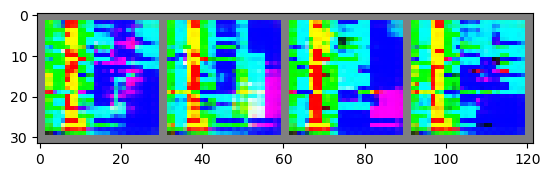

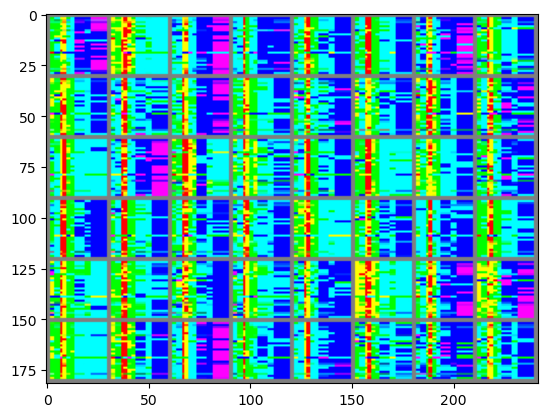

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 480/1000 Total Steps:2405	Loss_D : 0.245926	Loss_G : 2.214072	Loss_D_Mean : 0.226452	Loss_G_Mean : 2.127834	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 481/1000 Total Steps:2410	Loss_D : 0.374594	Loss_G : 2.548391	Loss_D_Mean : 0.365015	Loss_G_Mean : 2.101429	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 482/1000 Total Steps:2415	Loss_D : 0.248945	Loss_G : 2.137100	Loss_D_Mean : 0.318722	Loss_G_Mean : 2.087230	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 483/1000 Total Steps:2420	Loss_D : 0.231511	Loss_G : 2.092045	Loss_D_Mean : 0.285121	Loss_G_Mean : 2.033545	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 484/1000 Total Steps:2425	Loss_D : 0.413332	Loss_G : 2.087515	Loss_D_Mean : 0.392711	Loss_G_Mean : 1.956659	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 485/1000 Total Steps:2430	Loss_D : 0.371594	Loss_G : 1.630480	Loss_D_Mean : 0.476361	Loss_G_Mean : 2.227450	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 486/1000 Total Steps:2435	Loss_D : 0.257906	Loss_G : 2.492846	Loss_D_Mean : 0.329944	Loss_G_Mean : 2.251464	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 487/1000 Total Steps:2440	Loss_D : 0.411159	Loss_G : 2.352116	Loss_D_Mean : 0.404452	Loss_G_Mean : 2.318119	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 488/1000 Total Steps:2445	Loss_D : 0.330412	Loss_G : 1.392351	Loss_D_Mean : 0.390425	Loss_G_Mean : 2.099318	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 489/1000 Total Steps:2450	Loss_D : 0.158664	Loss_G : 2.620496	Loss_D_Mean : 0.269265	Loss_G_Mean : 2.427615	
Epoch: 490


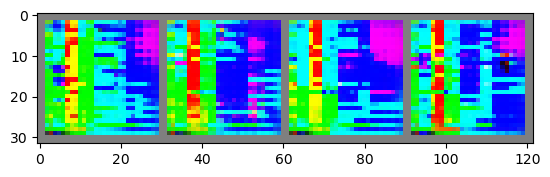

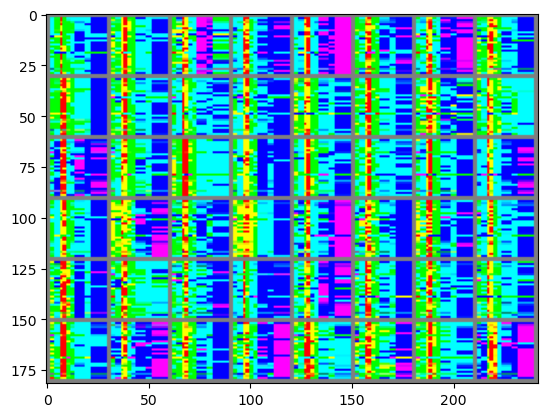

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 490/1000 Total Steps:2455	Loss_D : 0.299913	Loss_G : 2.585541	Loss_D_Mean : 0.251990	Loss_G_Mean : 2.298418	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 491/1000 Total Steps:2460	Loss_D : 0.228573	Loss_G : 1.967969	Loss_D_Mean : 0.314638	Loss_G_Mean : 2.303442	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 492/1000 Total Steps:2465	Loss_D : 0.252958	Loss_G : 2.084723	Loss_D_Mean : 0.203124	Loss_G_Mean : 2.339871	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 493/1000 Total Steps:2470	Loss_D : 0.226710	Loss_G : 1.774705	Loss_D_Mean : 0.226372	Loss_G_Mean : 2.166689	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 494/1000 Total Steps:2475	Loss_D : 0.251071	Loss_G : 2.484814	Loss_D_Mean : 0.231620	Loss_G_Mean : 2.280328	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 495/1000 Total Steps:2480	Loss_D : 0.177348	Loss_G : 1.593691	Loss_D_Mean : 0.202380	Loss_G_Mean : 2.229091	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 496/1000 Total Steps:2485	Loss_D : 0.373059	Loss_G : 1.527792	Loss_D_Mean : 0.274518	Loss_G_Mean : 2.281584	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 497/1000 Total Steps:2490	Loss_D : 0.267177	Loss_G : 1.683085	Loss_D_Mean : 0.223758	Loss_G_Mean : 2.212288	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 498/1000 Total Steps:2495	Loss_D : 0.129169	Loss_G : 2.736547	Loss_D_Mean : 0.167045	Loss_G_Mean : 2.479081	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 499/1000 Total Steps:2500	Loss_D : 0.207827	Loss_G : 2.349493	Loss_D_Mean : 0.191996	Loss_G_Mean : 2.328862	
Epoch: 500


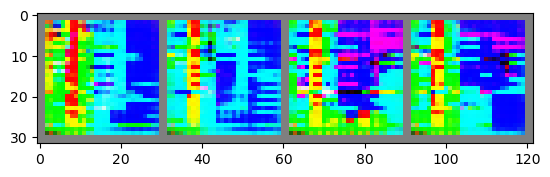

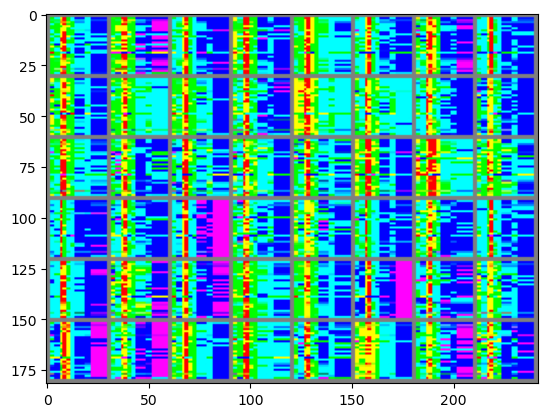

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 500/1000 Total Steps:2505	Loss_D : 0.214773	Loss_G : 3.032289	Loss_D_Mean : 0.198378	Loss_G_Mean : 2.402327	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 501/1000 Total Steps:2510	Loss_D : 0.176616	Loss_G : 2.074342	Loss_D_Mean : 0.174207	Loss_G_Mean : 2.210217	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 502/1000 Total Steps:2515	Loss_D : 0.235998	Loss_G : 1.811408	Loss_D_Mean : 0.194934	Loss_G_Mean : 2.318097	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 503/1000 Total Steps:2520	Loss_D : 0.177919	Loss_G : 2.165345	Loss_D_Mean : 0.198523	Loss_G_Mean : 2.333675	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 504/1000 Total Steps:2525	Loss_D : 0.456803	Loss_G : 3.602906	Loss_D_Mean : 0.345325	Loss_G_Mean : 2.291809	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 505/1000 Total Steps:2530	Loss_D : 0.459597	Loss_G : 3.207518	Loss_D_Mean : 0.466340	Loss_G_Mean : 2.168809	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 506/1000 Total Steps:2535	Loss_D : 0.336142	Loss_G : 1.254115	Loss_D_Mean : 0.277785	Loss_G_Mean : 2.021749	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 507/1000 Total Steps:2540	Loss_D : 0.403186	Loss_G : 1.086942	Loss_D_Mean : 0.324061	Loss_G_Mean : 2.159400	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 508/1000 Total Steps:2545	Loss_D : 0.273815	Loss_G : 2.475652	Loss_D_Mean : 0.335012	Loss_G_Mean : 2.299778	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 509/1000 Total Steps:2550	Loss_D : 0.266153	Loss_G : 2.506555	Loss_D_Mean : 0.270605	Loss_G_Mean : 2.172639	
Epoch: 510


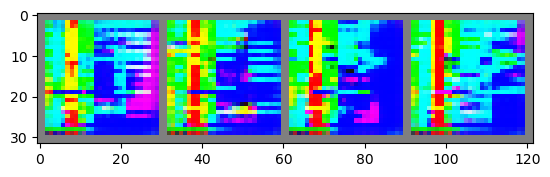

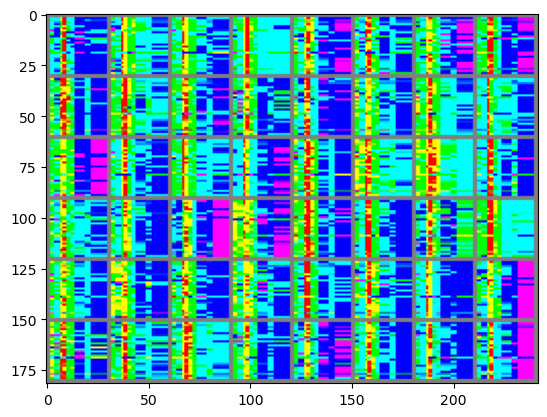

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 510/1000 Total Steps:2555	Loss_D : 0.270674	Loss_G : 2.559221	Loss_D_Mean : 0.269307	Loss_G_Mean : 2.154161	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 511/1000 Total Steps:2560	Loss_D : 0.300984	Loss_G : 2.501788	Loss_D_Mean : 0.254185	Loss_G_Mean : 2.227461	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 512/1000 Total Steps:2565	Loss_D : 0.259578	Loss_G : 2.453994	Loss_D_Mean : 0.225585	Loss_G_Mean : 2.300517	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 513/1000 Total Steps:2570	Loss_D : 0.375738	Loss_G : 3.595882	Loss_D_Mean : 0.491306	Loss_G_Mean : 2.386120	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 514/1000 Total Steps:2575	Loss_D : 0.282959	Loss_G : 1.128338	Loss_D_Mean : 0.240241	Loss_G_Mean : 2.163627	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 515/1000 Total Steps:2580	Loss_D : 0.265949	Loss_G : 2.235106	Loss_D_Mean : 0.319571	Loss_G_Mean : 2.501932	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 516/1000 Total Steps:2585	Loss_D : 0.294645	Loss_G : 1.734226	Loss_D_Mean : 0.243842	Loss_G_Mean : 2.182916	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 517/1000 Total Steps:2590	Loss_D : 0.264655	Loss_G : 2.036749	Loss_D_Mean : 0.260219	Loss_G_Mean : 2.099723	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 518/1000 Total Steps:2595	Loss_D : 0.283462	Loss_G : 2.324479	Loss_D_Mean : 0.289076	Loss_G_Mean : 2.004316	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 519/1000 Total Steps:2600	Loss_D : 0.174857	Loss_G : 2.785829	Loss_D_Mean : 0.408533	Loss_G_Mean : 2.584630	
Epoch: 520


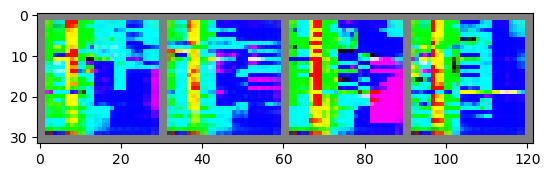

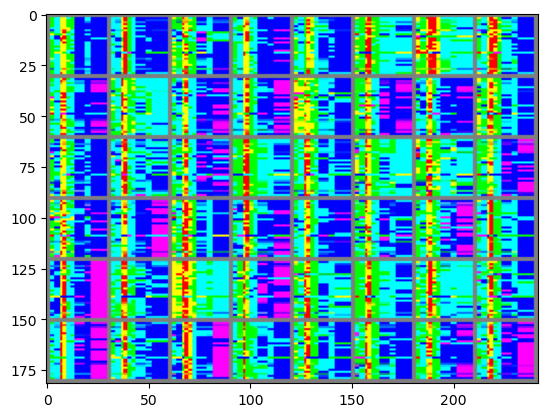

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 520/1000 Total Steps:2605	Loss_D : 0.240038	Loss_G : 2.910130	Loss_D_Mean : 0.211367	Loss_G_Mean : 2.320880	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 521/1000 Total Steps:2610	Loss_D : 0.239717	Loss_G : 1.906870	Loss_D_Mean : 0.225711	Loss_G_Mean : 2.140544	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 522/1000 Total Steps:2615	Loss_D : 0.229506	Loss_G : 2.467943	Loss_D_Mean : 0.250558	Loss_G_Mean : 2.383023	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 523/1000 Total Steps:2620	Loss_D : 0.345963	Loss_G : 1.360021	Loss_D_Mean : 0.261649	Loss_G_Mean : 2.162731	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 524/1000 Total Steps:2625	Loss_D : 0.215069	Loss_G : 1.915544	Loss_D_Mean : 0.217935	Loss_G_Mean : 2.338439	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 525/1000 Total Steps:2630	Loss_D : 0.296040	Loss_G : 3.325362	Loss_D_Mean : 0.244767	Loss_G_Mean : 2.240617	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 526/1000 Total Steps:2635	Loss_D : 0.323008	Loss_G : 1.368197	Loss_D_Mean : 0.293278	Loss_G_Mean : 1.860866	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 527/1000 Total Steps:2640	Loss_D : 0.236765	Loss_G : 1.837836	Loss_D_Mean : 0.248700	Loss_G_Mean : 2.176824	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 528/1000 Total Steps:2645	Loss_D : 0.268452	Loss_G : 2.754207	Loss_D_Mean : 0.248038	Loss_G_Mean : 2.213391	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 529/1000 Total Steps:2650	Loss_D : 0.189326	Loss_G : 2.118571	Loss_D_Mean : 0.180552	Loss_G_Mean : 2.316004	
Epoch: 530


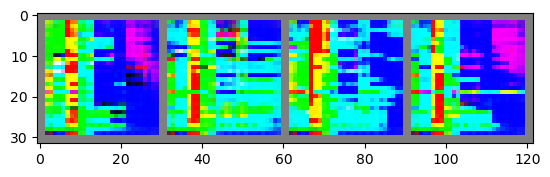

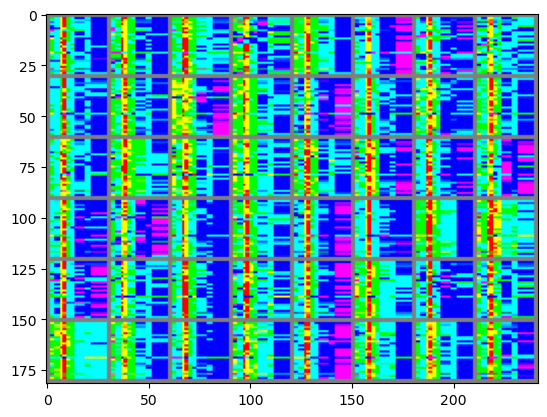

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 530/1000 Total Steps:2655	Loss_D : 0.515767	Loss_G : 4.641090	Loss_D_Mean : 0.286296	Loss_G_Mean : 2.526262	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 531/1000 Total Steps:2660	Loss_D : 0.201757	Loss_G : 2.067326	Loss_D_Mean : 0.221367	Loss_G_Mean : 2.305876	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 532/1000 Total Steps:2665	Loss_D : 0.212704	Loss_G : 2.894653	Loss_D_Mean : 0.188346	Loss_G_Mean : 2.415085	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 533/1000 Total Steps:2670	Loss_D : 0.325805	Loss_G : 2.333020	Loss_D_Mean : 0.244200	Loss_G_Mean : 2.177885	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 534/1000 Total Steps:2675	Loss_D : 0.429031	Loss_G : 0.881644	Loss_D_Mean : 0.305780	Loss_G_Mean : 2.143428	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 535/1000 Total Steps:2680	Loss_D : 0.204809	Loss_G : 3.488505	Loss_D_Mean : 0.210936	Loss_G_Mean : 2.531106	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 536/1000 Total Steps:2685	Loss_D : 0.234837	Loss_G : 1.054888	Loss_D_Mean : 0.251981	Loss_G_Mean : 2.157727	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 537/1000 Total Steps:2690	Loss_D : 0.211052	Loss_G : 2.400735	Loss_D_Mean : 0.373120	Loss_G_Mean : 2.602990	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 538/1000 Total Steps:2695	Loss_D : 0.327746	Loss_G : 1.923089	Loss_D_Mean : 0.263497	Loss_G_Mean : 2.102209	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 539/1000 Total Steps:2700	Loss_D : 0.281446	Loss_G : 1.690858	Loss_D_Mean : 0.273423	Loss_G_Mean : 1.871957	
Epoch: 540


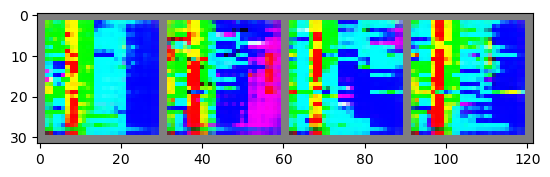

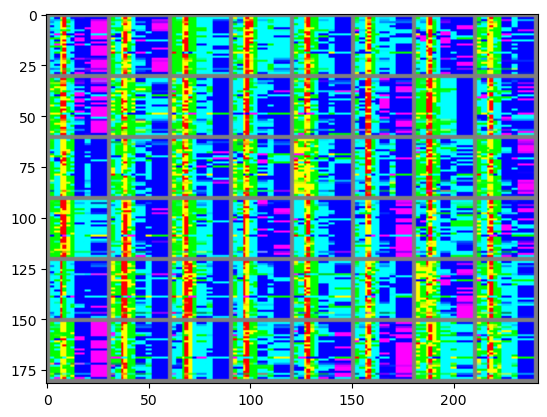

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 540/1000 Total Steps:2705	Loss_D : 0.210130	Loss_G : 2.095845	Loss_D_Mean : 0.229933	Loss_G_Mean : 2.294768	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 541/1000 Total Steps:2710	Loss_D : 0.167856	Loss_G : 2.739040	Loss_D_Mean : 0.239798	Loss_G_Mean : 2.324820	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 542/1000 Total Steps:2715	Loss_D : 0.275024	Loss_G : 1.637201	Loss_D_Mean : 0.190918	Loss_G_Mean : 2.231145	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 543/1000 Total Steps:2720	Loss_D : 0.205551	Loss_G : 3.158643	Loss_D_Mean : 0.267770	Loss_G_Mean : 2.588866	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 544/1000 Total Steps:2725	Loss_D : 0.211495	Loss_G : 2.019392	Loss_D_Mean : 0.221350	Loss_G_Mean : 2.222327	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 545/1000 Total Steps:2730	Loss_D : 0.161004	Loss_G : 2.422287	Loss_D_Mean : 0.172750	Loss_G_Mean : 2.377847	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 546/1000 Total Steps:2735	Loss_D : 0.279602	Loss_G : 1.899463	Loss_D_Mean : 0.191847	Loss_G_Mean : 2.283304	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 547/1000 Total Steps:2740	Loss_D : 0.380960	Loss_G : 1.553533	Loss_D_Mean : 0.300193	Loss_G_Mean : 2.294236	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 548/1000 Total Steps:2745	Loss_D : 0.393311	Loss_G : 3.238160	Loss_D_Mean : 0.250207	Loss_G_Mean : 2.559346	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 549/1000 Total Steps:2750	Loss_D : 0.122109	Loss_G : 2.405241	Loss_D_Mean : 0.291748	Loss_G_Mean : 2.325817	
Epoch: 550


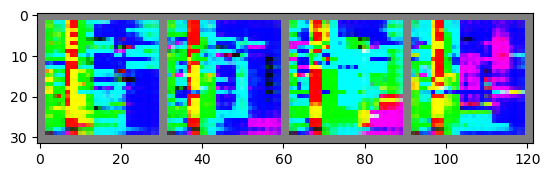

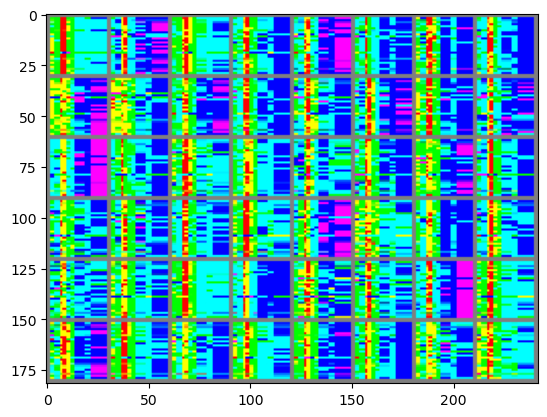

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 550/1000 Total Steps:2755	Loss_D : 0.213435	Loss_G : 2.683106	Loss_D_Mean : 0.160438	Loss_G_Mean : 2.528645	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 551/1000 Total Steps:2760	Loss_D : 0.144243	Loss_G : 2.781609	Loss_D_Mean : 0.206809	Loss_G_Mean : 2.502740	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 552/1000 Total Steps:2765	Loss_D : 0.363855	Loss_G : 2.762051	Loss_D_Mean : 0.309298	Loss_G_Mean : 2.300065	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 553/1000 Total Steps:2770	Loss_D : 0.291983	Loss_G : 2.324350	Loss_D_Mean : 0.239800	Loss_G_Mean : 2.089535	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 554/1000 Total Steps:2775	Loss_D : 0.337055	Loss_G : 3.315649	Loss_D_Mean : 0.301519	Loss_G_Mean : 2.669277	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 555/1000 Total Steps:2780	Loss_D : 0.777500	Loss_G : 3.749791	Loss_D_Mean : 0.481506	Loss_G_Mean : 2.430572	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 556/1000 Total Steps:2785	Loss_D : 0.306670	Loss_G : 1.602933	Loss_D_Mean : 0.287860	Loss_G_Mean : 2.314787	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 557/1000 Total Steps:2790	Loss_D : 0.173812	Loss_G : 2.444638	Loss_D_Mean : 0.357664	Loss_G_Mean : 2.586752	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 558/1000 Total Steps:2795	Loss_D : 0.493262	Loss_G : 4.740478	Loss_D_Mean : 0.334472	Loss_G_Mean : 2.793745	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 559/1000 Total Steps:2800	Loss_D : 0.187536	Loss_G : 2.241573	Loss_D_Mean : 0.355419	Loss_G_Mean : 2.425678	
Epoch: 560


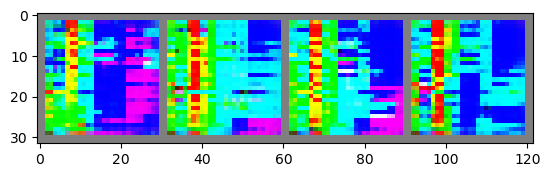

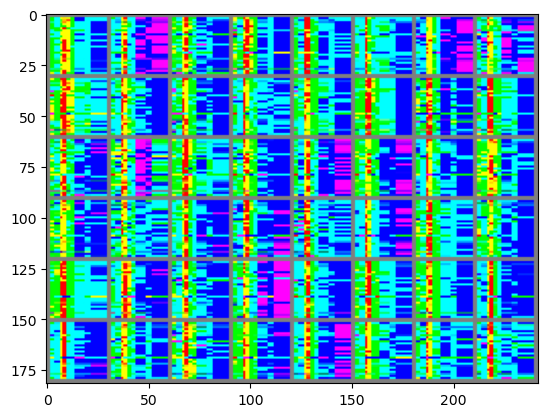

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 560/1000 Total Steps:2805	Loss_D : 0.243038	Loss_G : 2.920627	Loss_D_Mean : 0.240135	Loss_G_Mean : 2.397006	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 561/1000 Total Steps:2810	Loss_D : 0.275683	Loss_G : 3.034874	Loss_D_Mean : 0.263222	Loss_G_Mean : 2.254393	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 562/1000 Total Steps:2815	Loss_D : 0.247244	Loss_G : 3.728996	Loss_D_Mean : 0.229975	Loss_G_Mean : 2.569640	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 563/1000 Total Steps:2820	Loss_D : 0.179344	Loss_G : 2.696790	Loss_D_Mean : 0.375220	Loss_G_Mean : 2.393923	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 564/1000 Total Steps:2825	Loss_D : 0.348677	Loss_G : 1.788047	Loss_D_Mean : 0.276494	Loss_G_Mean : 2.214783	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 565/1000 Total Steps:2830	Loss_D : 0.162807	Loss_G : 2.590782	Loss_D_Mean : 0.200272	Loss_G_Mean : 2.379903	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 566/1000 Total Steps:2835	Loss_D : 0.366878	Loss_G : 3.039028	Loss_D_Mean : 0.253265	Loss_G_Mean : 2.344778	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 567/1000 Total Steps:2840	Loss_D : 0.259147	Loss_G : 1.546938	Loss_D_Mean : 0.230688	Loss_G_Mean : 2.177700	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 568/1000 Total Steps:2845	Loss_D : 0.256356	Loss_G : 1.505803	Loss_D_Mean : 0.255269	Loss_G_Mean : 2.312481	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 569/1000 Total Steps:2850	Loss_D : 0.264424	Loss_G : 1.904646	Loss_D_Mean : 0.248780	Loss_G_Mean : 2.177653	
Epoch: 570


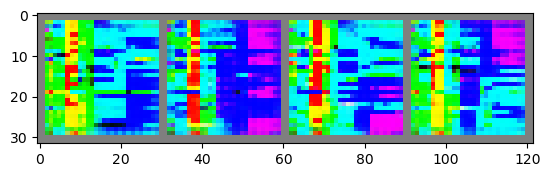

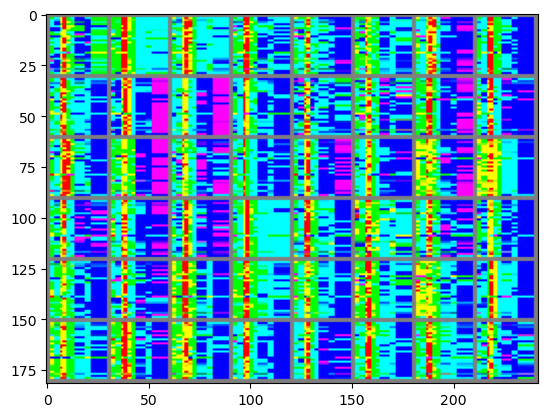

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 570/1000 Total Steps:2855	Loss_D : 0.407497	Loss_G : 1.940418	Loss_D_Mean : 0.258418	Loss_G_Mean : 2.473232	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 571/1000 Total Steps:2860	Loss_D : 0.248764	Loss_G : 2.683257	Loss_D_Mean : 0.283369	Loss_G_Mean : 2.188595	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 572/1000 Total Steps:2865	Loss_D : 0.241615	Loss_G : 1.710701	Loss_D_Mean : 0.219549	Loss_G_Mean : 2.150264	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 573/1000 Total Steps:2870	Loss_D : 0.255475	Loss_G : 1.971840	Loss_D_Mean : 0.242810	Loss_G_Mean : 2.248332	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 574/1000 Total Steps:2875	Loss_D : 0.262965	Loss_G : 1.695489	Loss_D_Mean : 0.257997	Loss_G_Mean : 2.177318	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 575/1000 Total Steps:2880	Loss_D : 0.564499	Loss_G : 4.590734	Loss_D_Mean : 0.320127	Loss_G_Mean : 2.808688	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 576/1000 Total Steps:2885	Loss_D : 0.213326	Loss_G : 2.361577	Loss_D_Mean : 0.276582	Loss_G_Mean : 2.499585	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 577/1000 Total Steps:2890	Loss_D : 0.286815	Loss_G : 2.490933	Loss_D_Mean : 0.248616	Loss_G_Mean : 2.311059	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 578/1000 Total Steps:2895	Loss_D : 0.281021	Loss_G : 1.996246	Loss_D_Mean : 0.259687	Loss_G_Mean : 2.145425	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 579/1000 Total Steps:2900	Loss_D : 0.332123	Loss_G : 2.883542	Loss_D_Mean : 0.319010	Loss_G_Mean : 2.424348	
Epoch: 580


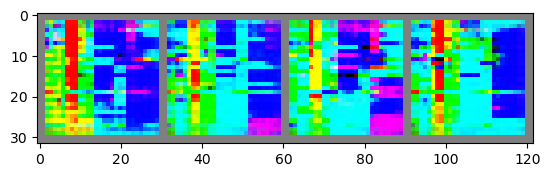

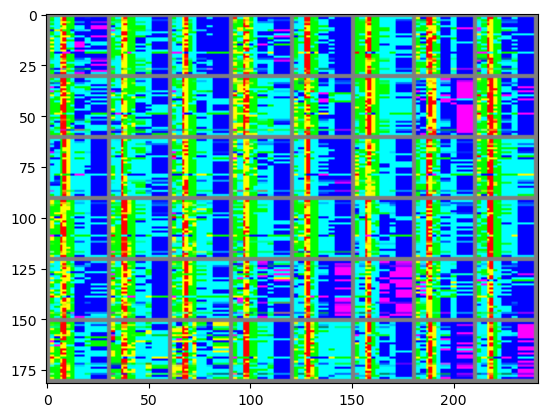

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 580/1000 Total Steps:2905	Loss_D : 0.239687	Loss_G : 1.752487	Loss_D_Mean : 0.294281	Loss_G_Mean : 2.396097	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 581/1000 Total Steps:2910	Loss_D : 0.200059	Loss_G : 3.606231	Loss_D_Mean : 0.350658	Loss_G_Mean : 2.688543	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 582/1000 Total Steps:2915	Loss_D : 0.234803	Loss_G : 1.719922	Loss_D_Mean : 0.282979	Loss_G_Mean : 2.233427	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 583/1000 Total Steps:2920	Loss_D : 0.616003	Loss_G : 3.700945	Loss_D_Mean : 0.506000	Loss_G_Mean : 2.699272	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 584/1000 Total Steps:2925	Loss_D : 0.310813	Loss_G : 1.645360	Loss_D_Mean : 0.341642	Loss_G_Mean : 2.036589	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 585/1000 Total Steps:2930	Loss_D : 0.457232	Loss_G : 1.403027	Loss_D_Mean : 0.356417	Loss_G_Mean : 2.082880	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 586/1000 Total Steps:2935	Loss_D : 0.211798	Loss_G : 1.889206	Loss_D_Mean : 0.260399	Loss_G_Mean : 2.065130	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 587/1000 Total Steps:2940	Loss_D : 0.239265	Loss_G : 2.451346	Loss_D_Mean : 0.221356	Loss_G_Mean : 2.399639	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 588/1000 Total Steps:2945	Loss_D : 0.141561	Loss_G : 3.374831	Loss_D_Mean : 0.180191	Loss_G_Mean : 2.443268	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 589/1000 Total Steps:2950	Loss_D : 0.179358	Loss_G : 1.726938	Loss_D_Mean : 0.154834	Loss_G_Mean : 2.369757	
Epoch: 590


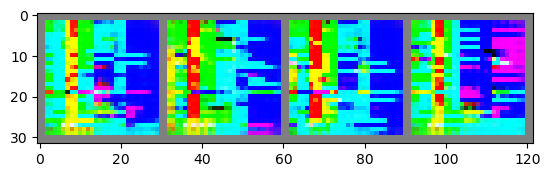

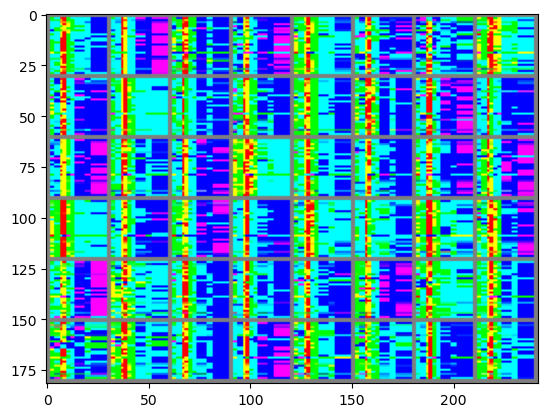

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 590/1000 Total Steps:2955	Loss_D : 0.166235	Loss_G : 2.551792	Loss_D_Mean : 0.156941	Loss_G_Mean : 2.498277	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 591/1000 Total Steps:2960	Loss_D : 0.172687	Loss_G : 2.073934	Loss_D_Mean : 0.201303	Loss_G_Mean : 2.376347	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 592/1000 Total Steps:2965	Loss_D : 0.208087	Loss_G : 2.034704	Loss_D_Mean : 0.228321	Loss_G_Mean : 2.649873	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 593/1000 Total Steps:2970	Loss_D : 0.391790	Loss_G : 5.086110	Loss_D_Mean : 0.266869	Loss_G_Mean : 2.838312	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 594/1000 Total Steps:2975	Loss_D : 0.219692	Loss_G : 1.684172	Loss_D_Mean : 0.402161	Loss_G_Mean : 2.309873	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 595/1000 Total Steps:2980	Loss_D : 0.199649	Loss_G : 3.028174	Loss_D_Mean : 0.318827	Loss_G_Mean : 2.662882	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 596/1000 Total Steps:2985	Loss_D : 0.301183	Loss_G : 2.298857	Loss_D_Mean : 0.264925	Loss_G_Mean : 2.309256	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 597/1000 Total Steps:2990	Loss_D : 0.164659	Loss_G : 2.546685	Loss_D_Mean : 0.208343	Loss_G_Mean : 2.308715	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 598/1000 Total Steps:2995	Loss_D : 0.178584	Loss_G : 2.802124	Loss_D_Mean : 0.177315	Loss_G_Mean : 2.327532	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 599/1000 Total Steps:3000	Loss_D : 0.170692	Loss_G : 2.617531	Loss_D_Mean : 0.172208	Loss_G_Mean : 2.455368	
Epoch: 600


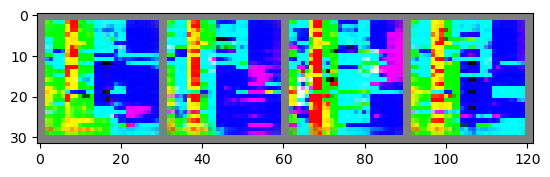

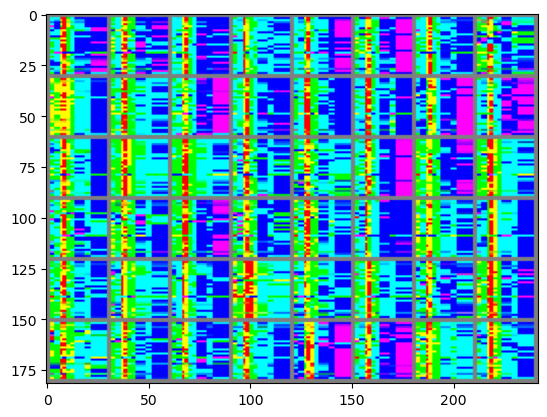

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 600/1000 Total Steps:3005	Loss_D : 0.192485	Loss_G : 1.575612	Loss_D_Mean : 0.181621	Loss_G_Mean : 2.215397	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 601/1000 Total Steps:3010	Loss_D : 0.155691	Loss_G : 2.791377	Loss_D_Mean : 0.204774	Loss_G_Mean : 2.596113	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 602/1000 Total Steps:3015	Loss_D : 0.201105	Loss_G : 1.945192	Loss_D_Mean : 0.168972	Loss_G_Mean : 2.351578	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 603/1000 Total Steps:3020	Loss_D : 0.144362	Loss_G : 2.306561	Loss_D_Mean : 0.159890	Loss_G_Mean : 2.439630	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 604/1000 Total Steps:3025	Loss_D : 0.315039	Loss_G : 1.348915	Loss_D_Mean : 0.222046	Loss_G_Mean : 2.279978	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 605/1000 Total Steps:3030	Loss_D : 0.307445	Loss_G : 1.773713	Loss_D_Mean : 0.287656	Loss_G_Mean : 2.507801	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 606/1000 Total Steps:3035	Loss_D : 0.297098	Loss_G : 3.086474	Loss_D_Mean : 0.236712	Loss_G_Mean : 2.458129	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 607/1000 Total Steps:3040	Loss_D : 0.199007	Loss_G : 1.566667	Loss_D_Mean : 0.188710	Loss_G_Mean : 2.357808	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 608/1000 Total Steps:3045	Loss_D : 0.111159	Loss_G : 3.514716	Loss_D_Mean : 0.179548	Loss_G_Mean : 2.790352	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 609/1000 Total Steps:3050	Loss_D : 0.230666	Loss_G : 3.608231	Loss_D_Mean : 0.205024	Loss_G_Mean : 2.564699	
Epoch: 610


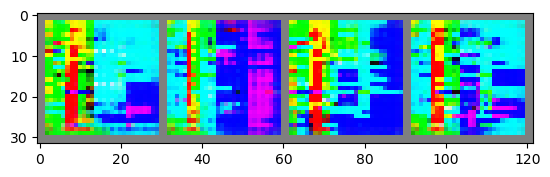

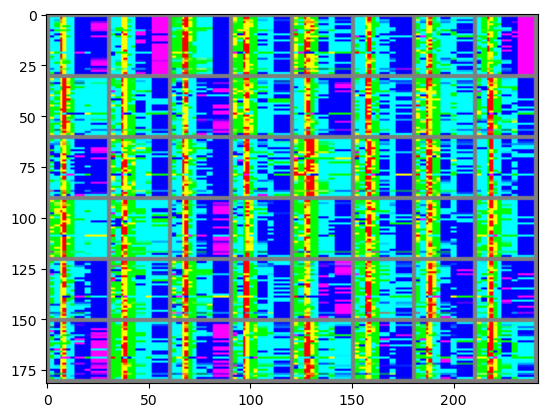

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 610/1000 Total Steps:3055	Loss_D : 0.221998	Loss_G : 2.142859	Loss_D_Mean : 0.333916	Loss_G_Mean : 2.410163	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 611/1000 Total Steps:3060	Loss_D : 0.233526	Loss_G : 2.131755	Loss_D_Mean : 0.156624	Loss_G_Mean : 2.640026	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 612/1000 Total Steps:3065	Loss_D : 0.262744	Loss_G : 1.946299	Loss_D_Mean : 0.200206	Loss_G_Mean : 2.369872	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 613/1000 Total Steps:3070	Loss_D : 0.229042	Loss_G : 2.637819	Loss_D_Mean : 0.277306	Loss_G_Mean : 2.281539	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 614/1000 Total Steps:3075	Loss_D : 0.296335	Loss_G : 2.677305	Loss_D_Mean : 0.249640	Loss_G_Mean : 2.312820	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 615/1000 Total Steps:3080	Loss_D : 0.348844	Loss_G : 3.153817	Loss_D_Mean : 0.309565	Loss_G_Mean : 2.310940	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 616/1000 Total Steps:3085	Loss_D : 0.303142	Loss_G : 3.359323	Loss_D_Mean : 0.315147	Loss_G_Mean : 2.272724	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 617/1000 Total Steps:3090	Loss_D : 0.886247	Loss_G : 3.792756	Loss_D_Mean : 0.639068	Loss_G_Mean : 2.523682	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 618/1000 Total Steps:3095	Loss_D : 0.243216	Loss_G : 2.596612	Loss_D_Mean : 0.329573	Loss_G_Mean : 2.585152	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 619/1000 Total Steps:3100	Loss_D : 0.322047	Loss_G : 2.873384	Loss_D_Mean : 0.304574	Loss_G_Mean : 2.304433	
Epoch: 620


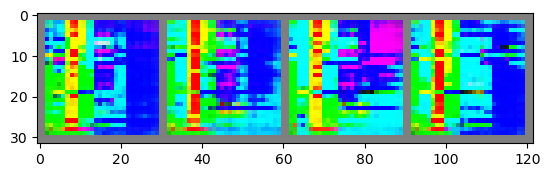

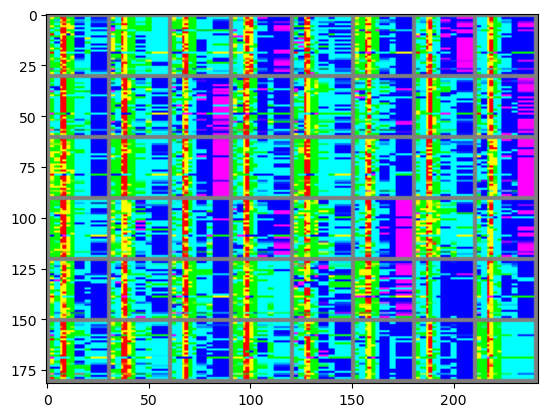

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 620/1000 Total Steps:3105	Loss_D : 0.270214	Loss_G : 1.688747	Loss_D_Mean : 0.308572	Loss_G_Mean : 2.196978	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 621/1000 Total Steps:3110	Loss_D : 0.398229	Loss_G : 3.126188	Loss_D_Mean : 0.364103	Loss_G_Mean : 2.739357	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 622/1000 Total Steps:3115	Loss_D : 0.249183	Loss_G : 1.851245	Loss_D_Mean : 0.242500	Loss_G_Mean : 2.197031	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 623/1000 Total Steps:3120	Loss_D : 0.160593	Loss_G : 2.573545	Loss_D_Mean : 0.180943	Loss_G_Mean : 2.481807	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 624/1000 Total Steps:3125	Loss_D : 0.619713	Loss_G : 1.373087	Loss_D_Mean : 0.409526	Loss_G_Mean : 2.406853	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 625/1000 Total Steps:3130	Loss_D : 0.179836	Loss_G : 2.972071	Loss_D_Mean : 0.307847	Loss_G_Mean : 3.019853	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 626/1000 Total Steps:3135	Loss_D : 0.306515	Loss_G : 2.860185	Loss_D_Mean : 0.237101	Loss_G_Mean : 2.441092	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 627/1000 Total Steps:3140	Loss_D : 0.140972	Loss_G : 2.563675	Loss_D_Mean : 0.160082	Loss_G_Mean : 2.776876	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 628/1000 Total Steps:3145	Loss_D : 0.166203	Loss_G : 2.915176	Loss_D_Mean : 0.159403	Loss_G_Mean : 2.700482	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 629/1000 Total Steps:3150	Loss_D : 0.203452	Loss_G : 2.812898	Loss_D_Mean : 0.233708	Loss_G_Mean : 2.626223	
Epoch: 630


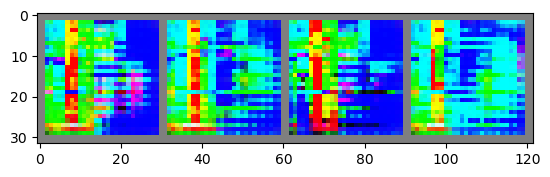

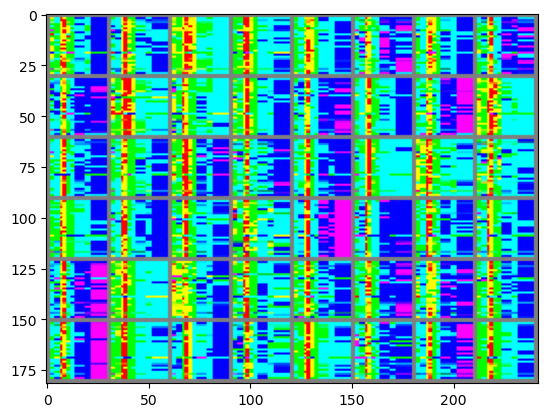

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 630/1000 Total Steps:3155	Loss_D : 0.423728	Loss_G : 1.723637	Loss_D_Mean : 0.334802	Loss_G_Mean : 2.550459	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 631/1000 Total Steps:3160	Loss_D : 0.362595	Loss_G : 2.757679	Loss_D_Mean : 0.290306	Loss_G_Mean : 2.505497	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 632/1000 Total Steps:3165	Loss_D : 0.247553	Loss_G : 3.411091	Loss_D_Mean : 0.251597	Loss_G_Mean : 2.520180	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 633/1000 Total Steps:3170	Loss_D : 0.142676	Loss_G : 2.710336	Loss_D_Mean : 0.207700	Loss_G_Mean : 2.518813	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 634/1000 Total Steps:3175	Loss_D : 0.255935	Loss_G : 2.886710	Loss_D_Mean : 0.218546	Loss_G_Mean : 2.324730	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 635/1000 Total Steps:3180	Loss_D : 0.264025	Loss_G : 3.679789	Loss_D_Mean : 0.269716	Loss_G_Mean : 2.538309	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 636/1000 Total Steps:3185	Loss_D : 0.149275	Loss_G : 2.614951	Loss_D_Mean : 0.193511	Loss_G_Mean : 2.668381	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 637/1000 Total Steps:3190	Loss_D : 0.197248	Loss_G : 2.033207	Loss_D_Mean : 0.155821	Loss_G_Mean : 2.546659	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 638/1000 Total Steps:3195	Loss_D : 0.173681	Loss_G : 2.256131	Loss_D_Mean : 0.143452	Loss_G_Mean : 2.628315	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 639/1000 Total Steps:3200	Loss_D : 0.208695	Loss_G : 2.198573	Loss_D_Mean : 0.168513	Loss_G_Mean : 2.565003	
Epoch: 640


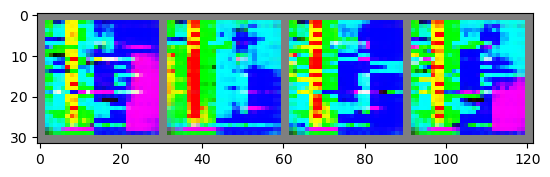

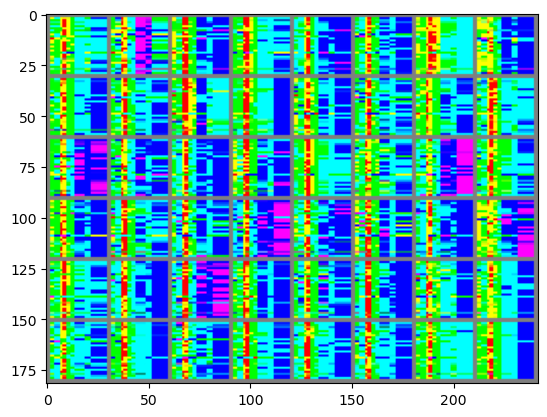

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 640/1000 Total Steps:3205	Loss_D : 0.230424	Loss_G : 3.122896	Loss_D_Mean : 0.339536	Loss_G_Mean : 3.109661	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 641/1000 Total Steps:3210	Loss_D : 0.251747	Loss_G : 1.772471	Loss_D_Mean : 0.239642	Loss_G_Mean : 2.854414	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 642/1000 Total Steps:3215	Loss_D : 0.250766	Loss_G : 4.614766	Loss_D_Mean : 0.369954	Loss_G_Mean : 3.428690	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 643/1000 Total Steps:3220	Loss_D : 0.198449	Loss_G : 2.734617	Loss_D_Mean : 0.265379	Loss_G_Mean : 2.704000	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 644/1000 Total Steps:3225	Loss_D : 0.164076	Loss_G : 2.192207	Loss_D_Mean : 0.187784	Loss_G_Mean : 2.470012	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 645/1000 Total Steps:3230	Loss_D : 0.283426	Loss_G : 2.302397	Loss_D_Mean : 0.207599	Loss_G_Mean : 2.490102	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 646/1000 Total Steps:3235	Loss_D : 0.436862	Loss_G : 4.754316	Loss_D_Mean : 0.325764	Loss_G_Mean : 2.684761	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 647/1000 Total Steps:3240	Loss_D : 0.257426	Loss_G : 2.321231	Loss_D_Mean : 0.252431	Loss_G_Mean : 2.595914	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 648/1000 Total Steps:3245	Loss_D : 0.359556	Loss_G : 3.642834	Loss_D_Mean : 0.294109	Loss_G_Mean : 2.753346	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 649/1000 Total Steps:3250	Loss_D : 0.129737	Loss_G : 2.750252	Loss_D_Mean : 0.254177	Loss_G_Mean : 2.371291	
Epoch: 650


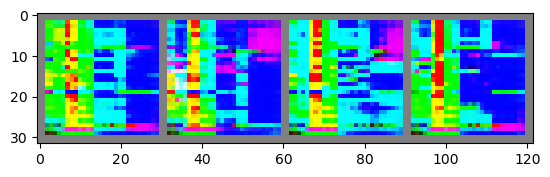

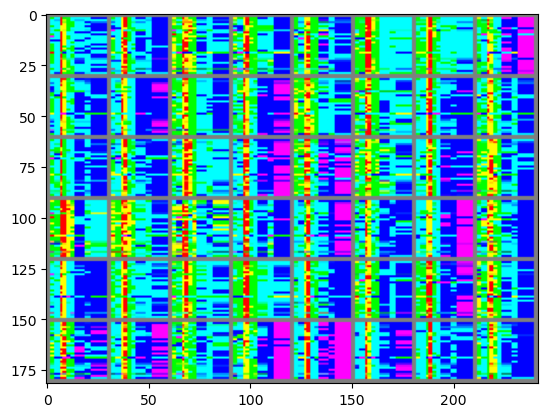

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 650/1000 Total Steps:3255	Loss_D : 0.240716	Loss_G : 2.163896	Loss_D_Mean : 0.197451	Loss_G_Mean : 2.350944	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 651/1000 Total Steps:3260	Loss_D : 0.165965	Loss_G : 2.333544	Loss_D_Mean : 0.202783	Loss_G_Mean : 2.307852	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 652/1000 Total Steps:3265	Loss_D : 0.226601	Loss_G : 2.368586	Loss_D_Mean : 0.147945	Loss_G_Mean : 2.740971	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 653/1000 Total Steps:3270	Loss_D : 0.180158	Loss_G : 4.383039	Loss_D_Mean : 0.400928	Loss_G_Mean : 3.015468	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 654/1000 Total Steps:3275	Loss_D : 0.217272	Loss_G : 2.123677	Loss_D_Mean : 0.197465	Loss_G_Mean : 2.424885	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 655/1000 Total Steps:3280	Loss_D : 0.212366	Loss_G : 1.773018	Loss_D_Mean : 0.209589	Loss_G_Mean : 2.243638	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 656/1000 Total Steps:3285	Loss_D : 0.244224	Loss_G : 1.405649	Loss_D_Mean : 0.241841	Loss_G_Mean : 2.562466	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 657/1000 Total Steps:3290	Loss_D : 0.113114	Loss_G : 2.660582	Loss_D_Mean : 0.137891	Loss_G_Mean : 2.709122	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 658/1000 Total Steps:3295	Loss_D : 0.126600	Loss_G : 2.755786	Loss_D_Mean : 0.130665	Loss_G_Mean : 2.564355	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 659/1000 Total Steps:3300	Loss_D : 0.143086	Loss_G : 2.595644	Loss_D_Mean : 0.147540	Loss_G_Mean : 2.605194	
Epoch: 660


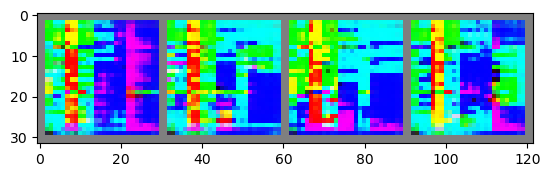

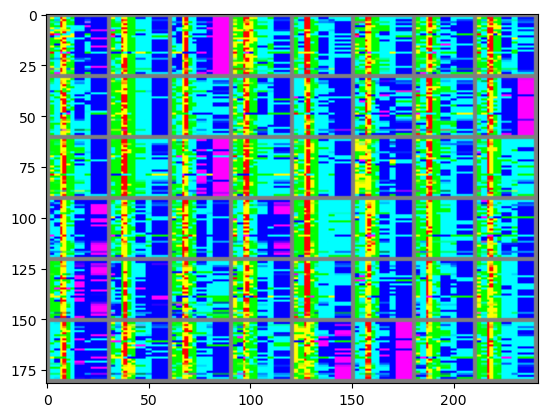

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 660/1000 Total Steps:3305	Loss_D : 0.191878	Loss_G : 2.677599	Loss_D_Mean : 0.193134	Loss_G_Mean : 2.386053	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 661/1000 Total Steps:3310	Loss_D : 0.169927	Loss_G : 2.747036	Loss_D_Mean : 0.166842	Loss_G_Mean : 2.574906	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 662/1000 Total Steps:3315	Loss_D : 0.325048	Loss_G : 4.944976	Loss_D_Mean : 0.228638	Loss_G_Mean : 2.859510	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 663/1000 Total Steps:3320	Loss_D : 0.179069	Loss_G : 4.162198	Loss_D_Mean : 0.210422	Loss_G_Mean : 2.822053	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 664/1000 Total Steps:3325	Loss_D : 0.239895	Loss_G : 2.947304	Loss_D_Mean : 0.261572	Loss_G_Mean : 2.794895	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 665/1000 Total Steps:3330	Loss_D : 0.245314	Loss_G : 2.625703	Loss_D_Mean : 0.333324	Loss_G_Mean : 2.532539	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 666/1000 Total Steps:3335	Loss_D : 0.483367	Loss_G : 0.478587	Loss_D_Mean : 0.304879	Loss_G_Mean : 2.054507	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 667/1000 Total Steps:3340	Loss_D : 0.292319	Loss_G : 3.858896	Loss_D_Mean : 0.393345	Loss_G_Mean : 3.146869	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 668/1000 Total Steps:3345	Loss_D : 0.201801	Loss_G : 2.351588	Loss_D_Mean : 0.272653	Loss_G_Mean : 2.473166	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 669/1000 Total Steps:3350	Loss_D : 0.545588	Loss_G : 1.761901	Loss_D_Mean : 0.429842	Loss_G_Mean : 2.467443	
Epoch: 670


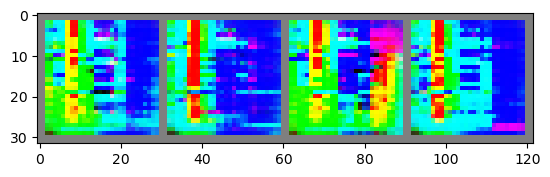

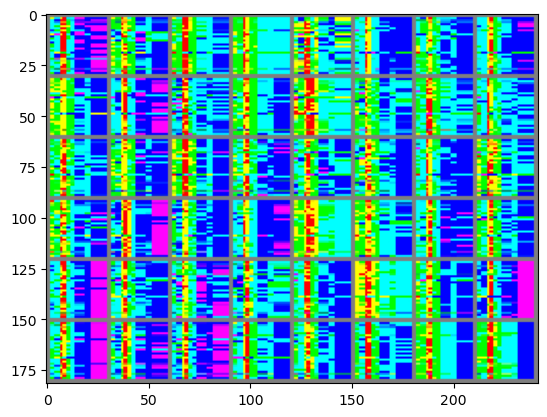

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 670/1000 Total Steps:3355	Loss_D : 0.269155	Loss_G : 3.064005	Loss_D_Mean : 0.239524	Loss_G_Mean : 2.514323	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 671/1000 Total Steps:3360	Loss_D : 0.336188	Loss_G : 3.808379	Loss_D_Mean : 0.207472	Loss_G_Mean : 2.733974	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 672/1000 Total Steps:3365	Loss_D : 0.198053	Loss_G : 2.566101	Loss_D_Mean : 0.305659	Loss_G_Mean : 2.525845	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 673/1000 Total Steps:3370	Loss_D : 0.229310	Loss_G : 2.126428	Loss_D_Mean : 0.277376	Loss_G_Mean : 2.435878	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 674/1000 Total Steps:3375	Loss_D : 0.218972	Loss_G : 2.854600	Loss_D_Mean : 0.216909	Loss_G_Mean : 2.712393	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 675/1000 Total Steps:3380	Loss_D : 0.184891	Loss_G : 2.111380	Loss_D_Mean : 0.204092	Loss_G_Mean : 2.395575	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 676/1000 Total Steps:3385	Loss_D : 0.194742	Loss_G : 1.829186	Loss_D_Mean : 0.148967	Loss_G_Mean : 2.420990	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 677/1000 Total Steps:3390	Loss_D : 0.125899	Loss_G : 3.209422	Loss_D_Mean : 0.140636	Loss_G_Mean : 2.755317	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 678/1000 Total Steps:3395	Loss_D : 0.139095	Loss_G : 2.575279	Loss_D_Mean : 0.127957	Loss_G_Mean : 2.694279	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 679/1000 Total Steps:3400	Loss_D : 0.124861	Loss_G : 2.129503	Loss_D_Mean : 0.137749	Loss_G_Mean : 2.442201	
Epoch: 680


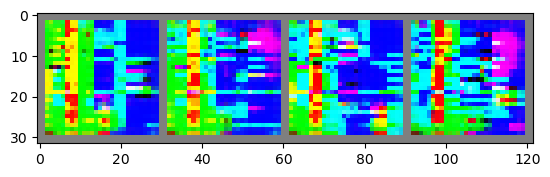

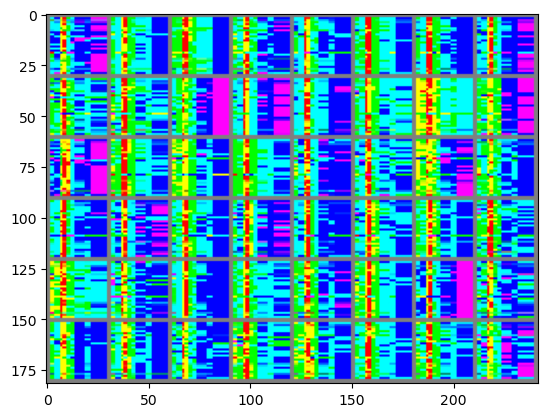

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 680/1000 Total Steps:3405	Loss_D : 0.137529	Loss_G : 1.978029	Loss_D_Mean : 0.121881	Loss_G_Mean : 2.543401	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 681/1000 Total Steps:3410	Loss_D : 0.150558	Loss_G : 3.144845	Loss_D_Mean : 0.132182	Loss_G_Mean : 2.733647	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 682/1000 Total Steps:3415	Loss_D : 0.153331	Loss_G : 2.353220	Loss_D_Mean : 0.137291	Loss_G_Mean : 2.502895	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 683/1000 Total Steps:3420	Loss_D : 0.119883	Loss_G : 3.128819	Loss_D_Mean : 0.162057	Loss_G_Mean : 2.579148	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 684/1000 Total Steps:3425	Loss_D : 0.135945	Loss_G : 2.150173	Loss_D_Mean : 0.128823	Loss_G_Mean : 2.514149	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 685/1000 Total Steps:3430	Loss_D : 0.162995	Loss_G : 2.266866	Loss_D_Mean : 0.138629	Loss_G_Mean : 2.588562	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 686/1000 Total Steps:3435	Loss_D : 0.162785	Loss_G : 2.466987	Loss_D_Mean : 0.157382	Loss_G_Mean : 2.355383	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 687/1000 Total Steps:3440	Loss_D : 0.223356	Loss_G : 3.010159	Loss_D_Mean : 0.149413	Loss_G_Mean : 2.639574	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 688/1000 Total Steps:3445	Loss_D : 0.265987	Loss_G : 1.685406	Loss_D_Mean : 0.174465	Loss_G_Mean : 2.418577	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 689/1000 Total Steps:3450	Loss_D : 0.110137	Loss_G : 3.239222	Loss_D_Mean : 0.166561	Loss_G_Mean : 2.696636	
Epoch: 690


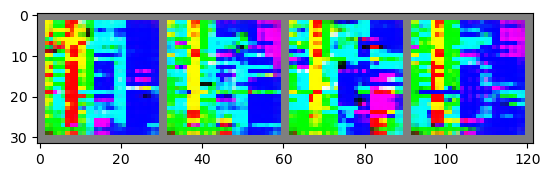

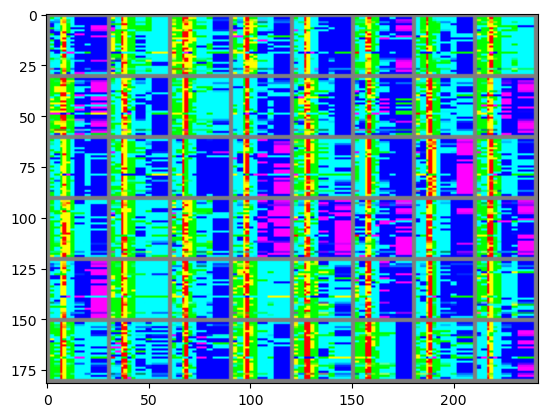

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 690/1000 Total Steps:3455	Loss_D : 0.282108	Loss_G : 3.215595	Loss_D_Mean : 0.221254	Loss_G_Mean : 2.452614	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 691/1000 Total Steps:3460	Loss_D : 0.267897	Loss_G : 4.093201	Loss_D_Mean : 0.254580	Loss_G_Mean : 2.665726	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 692/1000 Total Steps:3465	Loss_D : 0.138377	Loss_G : 3.324124	Loss_D_Mean : 0.178557	Loss_G_Mean : 2.611920	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 693/1000 Total Steps:3470	Loss_D : 0.113255	Loss_G : 2.691058	Loss_D_Mean : 0.136588	Loss_G_Mean : 2.498265	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 694/1000 Total Steps:3475	Loss_D : 0.164553	Loss_G : 2.377031	Loss_D_Mean : 0.167174	Loss_G_Mean : 2.815003	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 695/1000 Total Steps:3480	Loss_D : 0.138532	Loss_G : 2.491949	Loss_D_Mean : 0.125785	Loss_G_Mean : 2.525878	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 696/1000 Total Steps:3485	Loss_D : 0.201350	Loss_G : 2.308869	Loss_D_Mean : 0.170177	Loss_G_Mean : 2.698845	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 697/1000 Total Steps:3490	Loss_D : 0.156063	Loss_G : 3.895398	Loss_D_Mean : 0.375581	Loss_G_Mean : 2.902815	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 698/1000 Total Steps:3495	Loss_D : 0.257354	Loss_G : 2.289107	Loss_D_Mean : 0.242942	Loss_G_Mean : 2.603380	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 699/1000 Total Steps:3500	Loss_D : 0.625426	Loss_G : 0.527654	Loss_D_Mean : 0.307969	Loss_G_Mean : 2.280018	
Epoch: 700


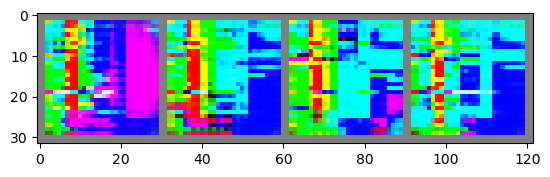

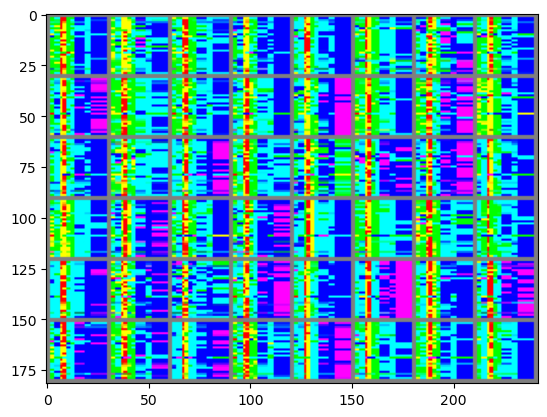

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 700/1000 Total Steps:3505	Loss_D : 0.541802	Loss_G : 1.894558	Loss_D_Mean : 0.422047	Loss_G_Mean : 2.895982	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 701/1000 Total Steps:3510	Loss_D : 0.244155	Loss_G : 3.311532	Loss_D_Mean : 0.298610	Loss_G_Mean : 2.778374	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 702/1000 Total Steps:3515	Loss_D : 0.238703	Loss_G : 1.632283	Loss_D_Mean : 0.215349	Loss_G_Mean : 2.499223	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 703/1000 Total Steps:3520	Loss_D : 0.272244	Loss_G : 2.186750	Loss_D_Mean : 0.245056	Loss_G_Mean : 2.506110	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 704/1000 Total Steps:3525	Loss_D : 0.342880	Loss_G : 3.345109	Loss_D_Mean : 0.484811	Loss_G_Mean : 2.993987	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 705/1000 Total Steps:3530	Loss_D : 0.266894	Loss_G : 1.324585	Loss_D_Mean : 0.214888	Loss_G_Mean : 2.316888	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 706/1000 Total Steps:3535	Loss_D : 0.177969	Loss_G : 2.679179	Loss_D_Mean : 0.238837	Loss_G_Mean : 2.773301	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 707/1000 Total Steps:3540	Loss_D : 0.312650	Loss_G : 4.614566	Loss_D_Mean : 0.252310	Loss_G_Mean : 2.662960	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 708/1000 Total Steps:3545	Loss_D : 0.114424	Loss_G : 2.765784	Loss_D_Mean : 0.210124	Loss_G_Mean : 2.615005	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 709/1000 Total Steps:3550	Loss_D : 0.115481	Loss_G : 2.194973	Loss_D_Mean : 0.158626	Loss_G_Mean : 2.655657	
Epoch: 710


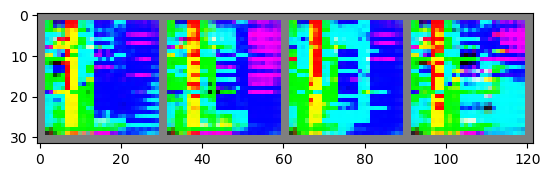

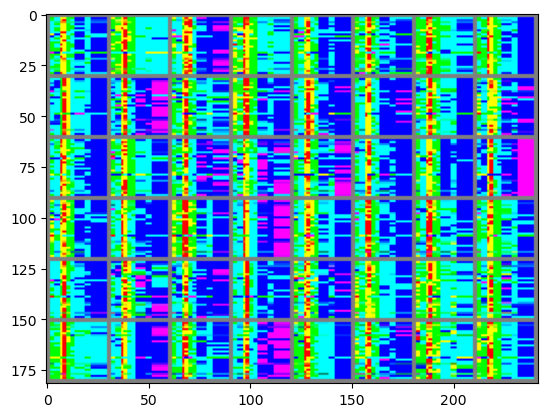

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 710/1000 Total Steps:3555	Loss_D : 0.092352	Loss_G : 3.292790	Loss_D_Mean : 0.132420	Loss_G_Mean : 3.017764	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 711/1000 Total Steps:3560	Loss_D : 0.544719	Loss_G : 2.184591	Loss_D_Mean : 0.285454	Loss_G_Mean : 3.036067	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 712/1000 Total Steps:3565	Loss_D : 0.154961	Loss_G : 2.754856	Loss_D_Mean : 0.215351	Loss_G_Mean : 2.844927	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 713/1000 Total Steps:3570	Loss_D : 0.153449	Loss_G : 2.890225	Loss_D_Mean : 0.146767	Loss_G_Mean : 2.687757	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 714/1000 Total Steps:3575	Loss_D : 0.129158	Loss_G : 2.919560	Loss_D_Mean : 0.164488	Loss_G_Mean : 2.705839	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 715/1000 Total Steps:3580	Loss_D : 0.110276	Loss_G : 3.073149	Loss_D_Mean : 0.131842	Loss_G_Mean : 2.819848	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 716/1000 Total Steps:3585	Loss_D : 0.144726	Loss_G : 3.252140	Loss_D_Mean : 0.141407	Loss_G_Mean : 2.861718	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 717/1000 Total Steps:3590	Loss_D : 0.094812	Loss_G : 3.049510	Loss_D_Mean : 0.116253	Loss_G_Mean : 2.721385	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 718/1000 Total Steps:3595	Loss_D : 0.121328	Loss_G : 2.768586	Loss_D_Mean : 0.135307	Loss_G_Mean : 2.691858	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 719/1000 Total Steps:3600	Loss_D : 0.151474	Loss_G : 2.339737	Loss_D_Mean : 0.123359	Loss_G_Mean : 2.645271	
Epoch: 720


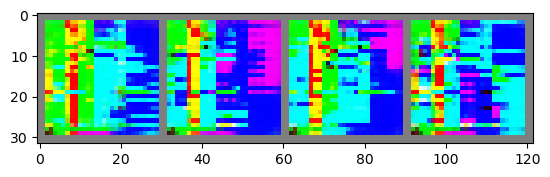

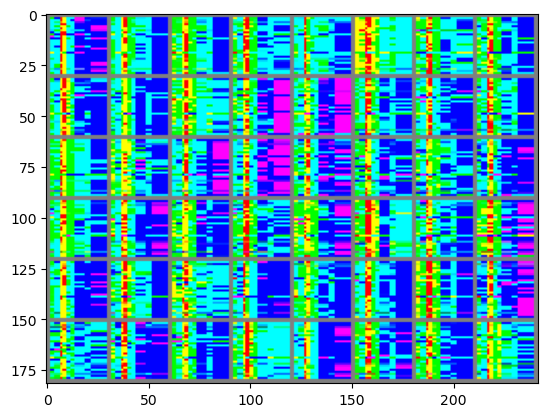

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 720/1000 Total Steps:3605	Loss_D : 0.309347	Loss_G : 3.529472	Loss_D_Mean : 0.250106	Loss_G_Mean : 2.951339	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 721/1000 Total Steps:3610	Loss_D : 0.131812	Loss_G : 2.247508	Loss_D_Mean : 0.150516	Loss_G_Mean : 2.702368	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 722/1000 Total Steps:3615	Loss_D : 0.105860	Loss_G : 2.358147	Loss_D_Mean : 0.101680	Loss_G_Mean : 2.844541	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 723/1000 Total Steps:3620	Loss_D : 0.083869	Loss_G : 2.755568	Loss_D_Mean : 0.093273	Loss_G_Mean : 2.859436	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 724/1000 Total Steps:3625	Loss_D : 0.122135	Loss_G : 2.898982	Loss_D_Mean : 0.110592	Loss_G_Mean : 2.790843	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 725/1000 Total Steps:3630	Loss_D : 0.474714	Loss_G : 4.813441	Loss_D_Mean : 0.290648	Loss_G_Mean : 2.951396	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 726/1000 Total Steps:3635	Loss_D : 0.313232	Loss_G : 1.334089	Loss_D_Mean : 0.274367	Loss_G_Mean : 2.407699	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 727/1000 Total Steps:3640	Loss_D : 0.184415	Loss_G : 3.904720	Loss_D_Mean : 0.214056	Loss_G_Mean : 3.006030	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 728/1000 Total Steps:3645	Loss_D : 0.552389	Loss_G : 5.436628	Loss_D_Mean : 0.321228	Loss_G_Mean : 2.803257	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 729/1000 Total Steps:3650	Loss_D : 0.378490	Loss_G : 1.433114	Loss_D_Mean : 0.342077	Loss_G_Mean : 2.414031	
Epoch: 730


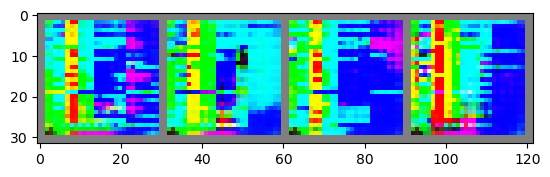

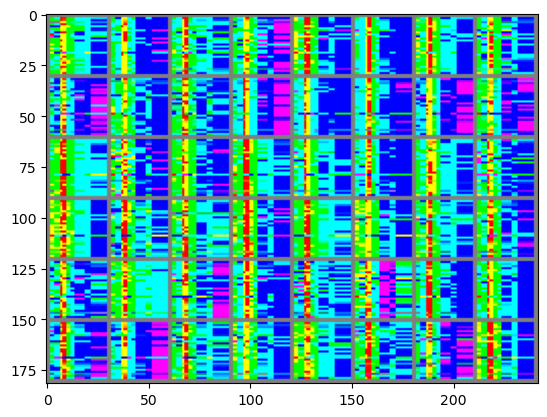

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 730/1000 Total Steps:3655	Loss_D : 0.257949	Loss_G : 2.555574	Loss_D_Mean : 0.337717	Loss_G_Mean : 2.565972	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 731/1000 Total Steps:3660	Loss_D : 0.123654	Loss_G : 2.406511	Loss_D_Mean : 0.234972	Loss_G_Mean : 2.381572	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 732/1000 Total Steps:3665	Loss_D : 0.199010	Loss_G : 2.389517	Loss_D_Mean : 0.236553	Loss_G_Mean : 2.555101	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 733/1000 Total Steps:3670	Loss_D : 0.293154	Loss_G : 1.143629	Loss_D_Mean : 0.208680	Loss_G_Mean : 2.390014	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 734/1000 Total Steps:3675	Loss_D : 0.170780	Loss_G : 3.260944	Loss_D_Mean : 0.232098	Loss_G_Mean : 3.058799	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 735/1000 Total Steps:3680	Loss_D : 0.223109	Loss_G : 1.854203	Loss_D_Mean : 0.163902	Loss_G_Mean : 2.689546	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 736/1000 Total Steps:3685	Loss_D : 0.181952	Loss_G : 2.303957	Loss_D_Mean : 0.192830	Loss_G_Mean : 2.583738	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 737/1000 Total Steps:3690	Loss_D : 0.198175	Loss_G : 2.416823	Loss_D_Mean : 0.190068	Loss_G_Mean : 2.407365	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 738/1000 Total Steps:3695	Loss_D : 0.225205	Loss_G : 1.840187	Loss_D_Mean : 0.179849	Loss_G_Mean : 2.344355	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 739/1000 Total Steps:3700	Loss_D : 0.134888	Loss_G : 4.058108	Loss_D_Mean : 0.221893	Loss_G_Mean : 3.172849	
Epoch: 740


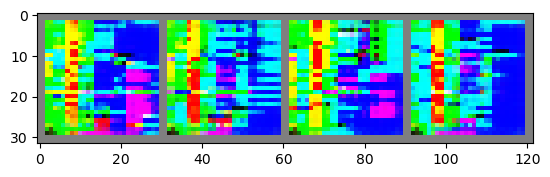

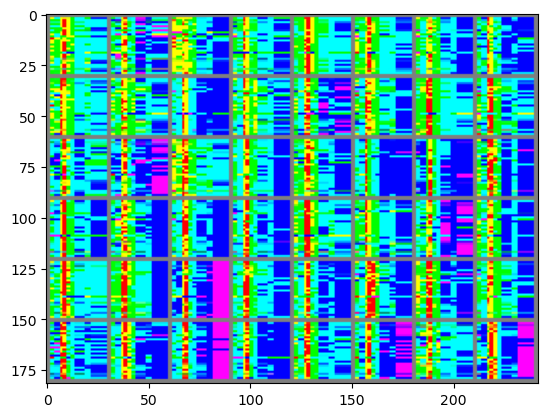

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 740/1000 Total Steps:3705	Loss_D : 0.233947	Loss_G : 2.934822	Loss_D_Mean : 0.268150	Loss_G_Mean : 2.705502	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 741/1000 Total Steps:3710	Loss_D : 0.278538	Loss_G : 3.488015	Loss_D_Mean : 0.187670	Loss_G_Mean : 2.904475	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 742/1000 Total Steps:3715	Loss_D : 0.161607	Loss_G : 2.623295	Loss_D_Mean : 0.334913	Loss_G_Mean : 2.742113	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 743/1000 Total Steps:3720	Loss_D : 0.227653	Loss_G : 2.294189	Loss_D_Mean : 0.184068	Loss_G_Mean : 2.616903	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 744/1000 Total Steps:3725	Loss_D : 1.080271	Loss_G : 5.979019	Loss_D_Mean : 0.487620	Loss_G_Mean : 3.010141	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 745/1000 Total Steps:3730	Loss_D : 0.207639	Loss_G : 2.281942	Loss_D_Mean : 0.305592	Loss_G_Mean : 2.635440	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 746/1000 Total Steps:3735	Loss_D : 0.296554	Loss_G : 2.992903	Loss_D_Mean : 0.214239	Loss_G_Mean : 2.744990	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 747/1000 Total Steps:3740	Loss_D : 0.152655	Loss_G : 2.879647	Loss_D_Mean : 0.185761	Loss_G_Mean : 2.650801	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 748/1000 Total Steps:3745	Loss_D : 0.257370	Loss_G : 1.264592	Loss_D_Mean : 0.191599	Loss_G_Mean : 2.418830	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 749/1000 Total Steps:3750	Loss_D : 0.187575	Loss_G : 2.589475	Loss_D_Mean : 0.183863	Loss_G_Mean : 3.058578	
Epoch: 750


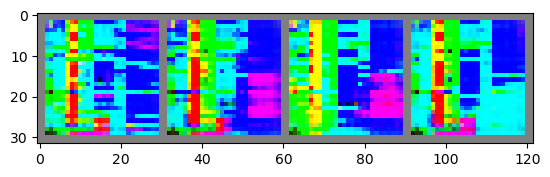

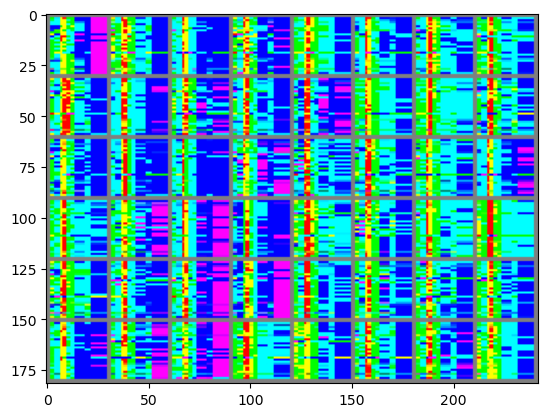

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 750/1000 Total Steps:3755	Loss_D : 0.243503	Loss_G : 1.762564	Loss_D_Mean : 0.199902	Loss_G_Mean : 2.618001	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 751/1000 Total Steps:3760	Loss_D : 0.233992	Loss_G : 2.649555	Loss_D_Mean : 0.252971	Loss_G_Mean : 2.755333	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 752/1000 Total Steps:3765	Loss_D : 0.182226	Loss_G : 1.922320	Loss_D_Mean : 0.225736	Loss_G_Mean : 2.455783	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 753/1000 Total Steps:3770	Loss_D : 0.455266	Loss_G : 3.170191	Loss_D_Mean : 0.302094	Loss_G_Mean : 3.560608	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 754/1000 Total Steps:3775	Loss_D : 0.397946	Loss_G : 1.495661	Loss_D_Mean : 0.455149	Loss_G_Mean : 2.779041	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 755/1000 Total Steps:3780	Loss_D : 0.499617	Loss_G : 3.367496	Loss_D_Mean : 0.664144	Loss_G_Mean : 2.894076	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 756/1000 Total Steps:3785	Loss_D : 0.661517	Loss_G : 3.830976	Loss_D_Mean : 0.687686	Loss_G_Mean : 2.555657	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 757/1000 Total Steps:3790	Loss_D : 0.445736	Loss_G : 1.503818	Loss_D_Mean : 0.518905	Loss_G_Mean : 1.691562	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 758/1000 Total Steps:3795	Loss_D : 0.482234	Loss_G : 2.380532	Loss_D_Mean : 0.729006	Loss_G_Mean : 2.208938	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 759/1000 Total Steps:3800	Loss_D : 0.428478	Loss_G : 1.502426	Loss_D_Mean : 0.558224	Loss_G_Mean : 1.612485	
Epoch: 760


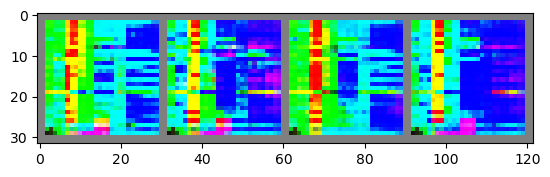

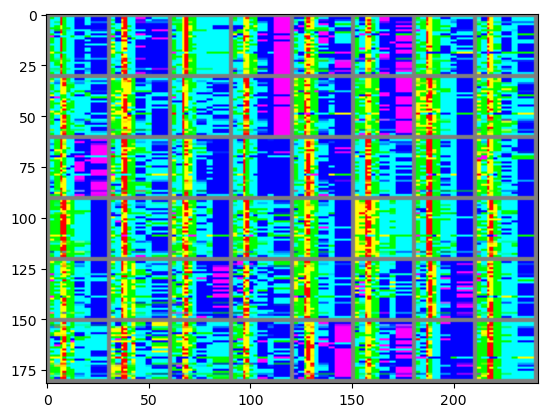

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 760/1000 Total Steps:3805	Loss_D : 0.669132	Loss_G : 3.188284	Loss_D_Mean : 0.494562	Loss_G_Mean : 1.839522	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 761/1000 Total Steps:3810	Loss_D : 0.427257	Loss_G : 2.832708	Loss_D_Mean : 0.470542	Loss_G_Mean : 1.813114	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 762/1000 Total Steps:3815	Loss_D : 0.695919	Loss_G : 4.405528	Loss_D_Mean : 0.616942	Loss_G_Mean : 2.139929	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 763/1000 Total Steps:3820	Loss_D : 0.492384	Loss_G : 1.407407	Loss_D_Mean : 0.731348	Loss_G_Mean : 1.665266	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 764/1000 Total Steps:3825	Loss_D : 0.475084	Loss_G : 1.724588	Loss_D_Mean : 0.511651	Loss_G_Mean : 2.017610	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 765/1000 Total Steps:3830	Loss_D : 0.797473	Loss_G : 1.527456	Loss_D_Mean : 0.573507	Loss_G_Mean : 2.158522	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 766/1000 Total Steps:3835	Loss_D : 0.348861	Loss_G : 2.194678	Loss_D_Mean : 0.429356	Loss_G_Mean : 1.751347	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 767/1000 Total Steps:3840	Loss_D : 0.665271	Loss_G : 1.062530	Loss_D_Mean : 0.736222	Loss_G_Mean : 1.876460	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 768/1000 Total Steps:3845	Loss_D : 0.500552	Loss_G : 1.687754	Loss_D_Mean : 0.456870	Loss_G_Mean : 1.829972	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 769/1000 Total Steps:3850	Loss_D : 0.535332	Loss_G : 1.605302	Loss_D_Mean : 0.537313	Loss_G_Mean : 2.313788	
Epoch: 770


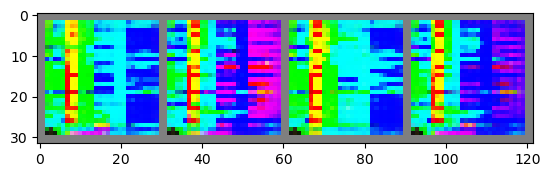

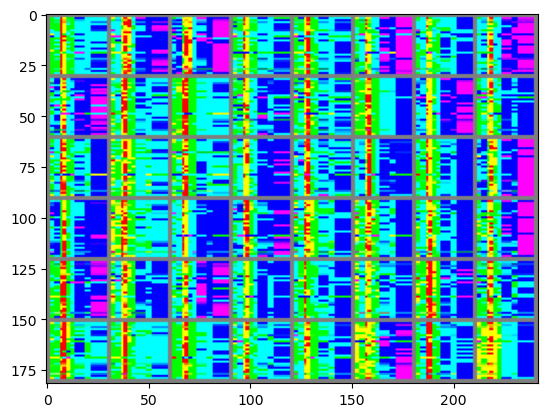

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 770/1000 Total Steps:3855	Loss_D : 0.378156	Loss_G : 1.724802	Loss_D_Mean : 0.333826	Loss_G_Mean : 2.032298	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 771/1000 Total Steps:3860	Loss_D : 0.335974	Loss_G : 2.861445	Loss_D_Mean : 0.485065	Loss_G_Mean : 2.224037	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 772/1000 Total Steps:3865	Loss_D : 0.664821	Loss_G : 4.073028	Loss_D_Mean : 0.581774	Loss_G_Mean : 1.997809	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 773/1000 Total Steps:3870	Loss_D : 0.401294	Loss_G : 1.718647	Loss_D_Mean : 0.560541	Loss_G_Mean : 1.729841	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 774/1000 Total Steps:3875	Loss_D : 0.361410	Loss_G : 1.672014	Loss_D_Mean : 0.379959	Loss_G_Mean : 1.844400	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 775/1000 Total Steps:3880	Loss_D : 0.399811	Loss_G : 1.264183	Loss_D_Mean : 0.325668	Loss_G_Mean : 2.018517	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 776/1000 Total Steps:3885	Loss_D : 0.264491	Loss_G : 1.758013	Loss_D_Mean : 0.258320	Loss_G_Mean : 1.978319	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 777/1000 Total Steps:3890	Loss_D : 0.228594	Loss_G : 2.375468	Loss_D_Mean : 0.207348	Loss_G_Mean : 2.210767	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 778/1000 Total Steps:3895	Loss_D : 0.352917	Loss_G : 2.293066	Loss_D_Mean : 0.412643	Loss_G_Mean : 2.633735	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 779/1000 Total Steps:3900	Loss_D : 0.794939	Loss_G : 3.538576	Loss_D_Mean : 0.492515	Loss_G_Mean : 2.301024	
Epoch: 780


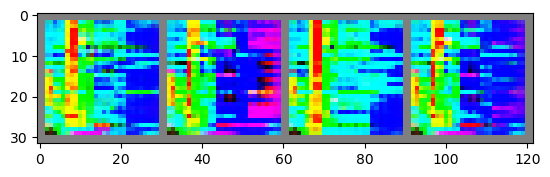

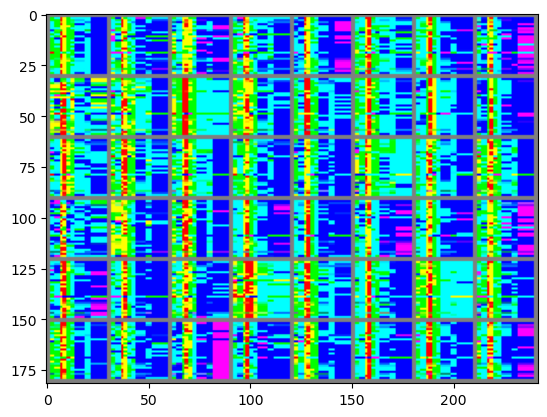

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 780/1000 Total Steps:3905	Loss_D : 0.376512	Loss_G : 2.464419	Loss_D_Mean : 0.605480	Loss_G_Mean : 1.845604	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 781/1000 Total Steps:3910	Loss_D : 0.787291	Loss_G : 3.352119	Loss_D_Mean : 0.540542	Loss_G_Mean : 2.048506	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 782/1000 Total Steps:3915	Loss_D : 0.549447	Loss_G : 1.362227	Loss_D_Mean : 0.423905	Loss_G_Mean : 2.301938	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 783/1000 Total Steps:3920	Loss_D : 0.462331	Loss_G : 3.776067	Loss_D_Mean : 0.491955	Loss_G_Mean : 2.539899	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 784/1000 Total Steps:3925	Loss_D : 0.349590	Loss_G : 2.193901	Loss_D_Mean : 0.395374	Loss_G_Mean : 2.096422	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 785/1000 Total Steps:3930	Loss_D : 0.449053	Loss_G : 2.460232	Loss_D_Mean : 0.458026	Loss_G_Mean : 2.617686	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 786/1000 Total Steps:3935	Loss_D : 0.529003	Loss_G : 3.792434	Loss_D_Mean : 0.575412	Loss_G_Mean : 2.519513	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 787/1000 Total Steps:3940	Loss_D : 0.846765	Loss_G : 3.508164	Loss_D_Mean : 0.774342	Loss_G_Mean : 2.180422	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 788/1000 Total Steps:3945	Loss_D : 0.251644	Loss_G : 1.861876	Loss_D_Mean : 0.339157	Loss_G_Mean : 2.218842	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 789/1000 Total Steps:3950	Loss_D : 0.338015	Loss_G : 2.607608	Loss_D_Mean : 0.271169	Loss_G_Mean : 2.194195	
Epoch: 790


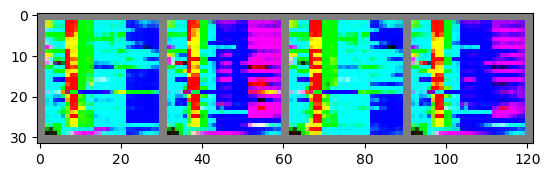

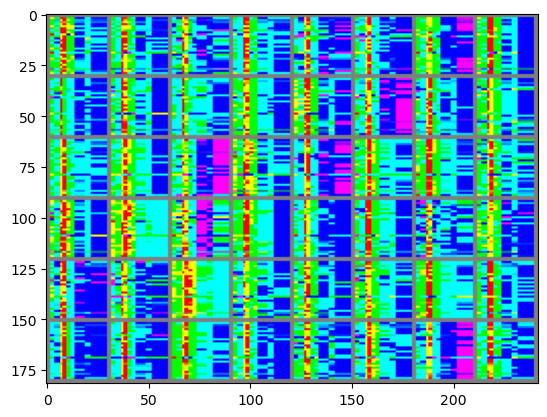

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 790/1000 Total Steps:3955	Loss_D : 0.306491	Loss_G : 2.449862	Loss_D_Mean : 0.310311	Loss_G_Mean : 2.098338	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 791/1000 Total Steps:3960	Loss_D : 0.378733	Loss_G : 0.985505	Loss_D_Mean : 0.314400	Loss_G_Mean : 1.847191	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 792/1000 Total Steps:3965	Loss_D : 0.288471	Loss_G : 1.490268	Loss_D_Mean : 0.470761	Loss_G_Mean : 2.248917	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 793/1000 Total Steps:3970	Loss_D : 0.451829	Loss_G : 2.763152	Loss_D_Mean : 0.391037	Loss_G_Mean : 2.220686	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 794/1000 Total Steps:3975	Loss_D : 0.243193	Loss_G : 2.401403	Loss_D_Mean : 0.312304	Loss_G_Mean : 2.155578	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 795/1000 Total Steps:3980	Loss_D : 0.332683	Loss_G : 4.259966	Loss_D_Mean : 0.356065	Loss_G_Mean : 2.731455	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 796/1000 Total Steps:3985	Loss_D : 0.291752	Loss_G : 2.024405	Loss_D_Mean : 0.474808	Loss_G_Mean : 1.970556	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 797/1000 Total Steps:3990	Loss_D : 0.555801	Loss_G : 3.726507	Loss_D_Mean : 0.350344	Loss_G_Mean : 2.278989	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 798/1000 Total Steps:3995	Loss_D : 0.374805	Loss_G : 1.217677	Loss_D_Mean : 0.419393	Loss_G_Mean : 1.858938	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 799/1000 Total Steps:4000	Loss_D : 0.322235	Loss_G : 1.916070	Loss_D_Mean : 0.291159	Loss_G_Mean : 2.144256	
Epoch: 800


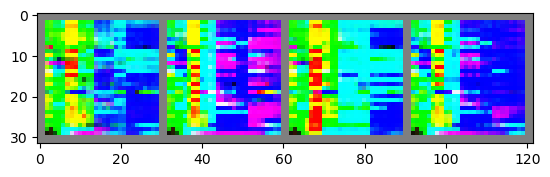

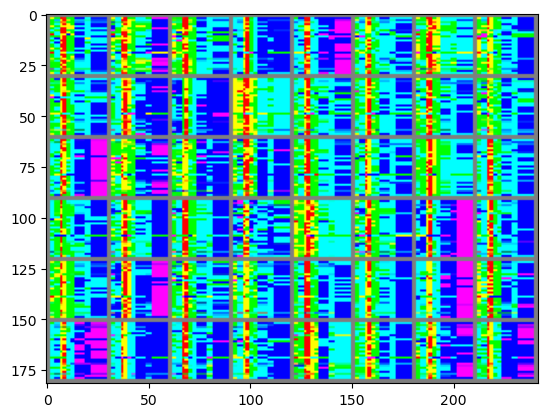

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 800/1000 Total Steps:4005	Loss_D : 0.419252	Loss_G : 3.542942	Loss_D_Mean : 0.337155	Loss_G_Mean : 2.434971	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 801/1000 Total Steps:4010	Loss_D : 0.607455	Loss_G : 3.951345	Loss_D_Mean : 0.701999	Loss_G_Mean : 2.160118	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 802/1000 Total Steps:4015	Loss_D : 0.252375	Loss_G : 0.849921	Loss_D_Mean : 0.574113	Loss_G_Mean : 2.136726	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 803/1000 Total Steps:4020	Loss_D : 0.385910	Loss_G : 2.641396	Loss_D_Mean : 0.477221	Loss_G_Mean : 2.761175	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 804/1000 Total Steps:4025	Loss_D : 0.414165	Loss_G : 3.563725	Loss_D_Mean : 0.340298	Loss_G_Mean : 2.372998	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 805/1000 Total Steps:4030	Loss_D : 0.954388	Loss_G : 3.491675	Loss_D_Mean : 0.538685	Loss_G_Mean : 2.371094	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 806/1000 Total Steps:4035	Loss_D : 0.364351	Loss_G : 1.782951	Loss_D_Mean : 0.603420	Loss_G_Mean : 2.062459	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 807/1000 Total Steps:4040	Loss_D : 0.419428	Loss_G : 1.784920	Loss_D_Mean : 0.361540	Loss_G_Mean : 2.228615	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 808/1000 Total Steps:4045	Loss_D : 0.259691	Loss_G : 1.423669	Loss_D_Mean : 0.527671	Loss_G_Mean : 2.583998	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 809/1000 Total Steps:4050	Loss_D : 0.590547	Loss_G : 2.280283	Loss_D_Mean : 0.665699	Loss_G_Mean : 2.727153	
Epoch: 810


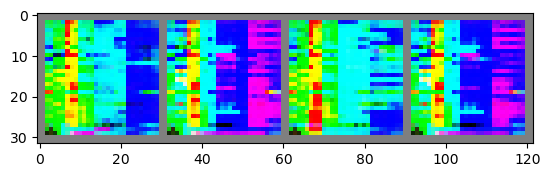

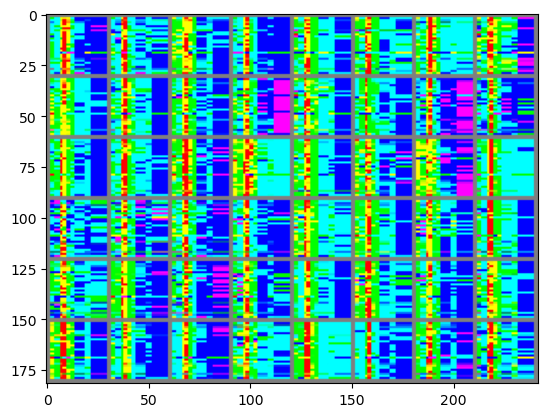

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 810/1000 Total Steps:4055	Loss_D : 0.300544	Loss_G : 2.529301	Loss_D_Mean : 0.302050	Loss_G_Mean : 2.330337	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 811/1000 Total Steps:4060	Loss_D : 0.509472	Loss_G : 0.721521	Loss_D_Mean : 0.478425	Loss_G_Mean : 2.372356	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 812/1000 Total Steps:4065	Loss_D : 0.248163	Loss_G : 2.284742	Loss_D_Mean : 0.294447	Loss_G_Mean : 2.386682	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 813/1000 Total Steps:4070	Loss_D : 0.281040	Loss_G : 2.543420	Loss_D_Mean : 0.264300	Loss_G_Mean : 2.466632	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 814/1000 Total Steps:4075	Loss_D : 0.446827	Loss_G : 4.724839	Loss_D_Mean : 0.397184	Loss_G_Mean : 2.584037	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 815/1000 Total Steps:4080	Loss_D : 0.555996	Loss_G : 1.219133	Loss_D_Mean : 0.482676	Loss_G_Mean : 1.750557	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 816/1000 Total Steps:4085	Loss_D : 0.662644	Loss_G : 4.009864	Loss_D_Mean : 0.626799	Loss_G_Mean : 2.849839	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 817/1000 Total Steps:4090	Loss_D : 0.331871	Loss_G : 2.022954	Loss_D_Mean : 0.260324	Loss_G_Mean : 2.704213	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 818/1000 Total Steps:4095	Loss_D : 0.409348	Loss_G : 2.033386	Loss_D_Mean : 0.411863	Loss_G_Mean : 2.289573	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 819/1000 Total Steps:4100	Loss_D : 0.308537	Loss_G : 1.389615	Loss_D_Mean : 0.288620	Loss_G_Mean : 1.826716	
Epoch: 820


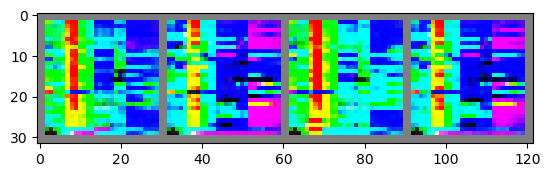

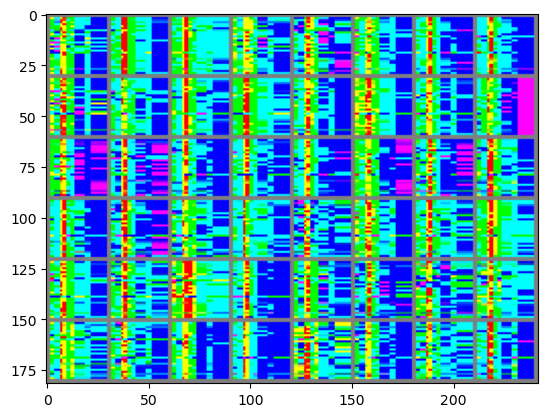

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 820/1000 Total Steps:4105	Loss_D : 0.647333	Loss_G : 0.947259	Loss_D_Mean : 0.411548	Loss_G_Mean : 2.165050	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 821/1000 Total Steps:4110	Loss_D : 0.737128	Loss_G : 3.597463	Loss_D_Mean : 0.480240	Loss_G_Mean : 2.338477	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 822/1000 Total Steps:4115	Loss_D : 0.676571	Loss_G : 3.262008	Loss_D_Mean : 0.515893	Loss_G_Mean : 2.145683	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 823/1000 Total Steps:4120	Loss_D : 0.322263	Loss_G : 2.006031	Loss_D_Mean : 0.375992	Loss_G_Mean : 1.839228	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 824/1000 Total Steps:4125	Loss_D : 0.954872	Loss_G : 3.398015	Loss_D_Mean : 0.532397	Loss_G_Mean : 2.226484	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 825/1000 Total Steps:4130	Loss_D : 0.225127	Loss_G : 1.857615	Loss_D_Mean : 0.333466	Loss_G_Mean : 2.131415	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 826/1000 Total Steps:4135	Loss_D : 0.339933	Loss_G : 1.969626	Loss_D_Mean : 0.409297	Loss_G_Mean : 2.338525	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 827/1000 Total Steps:4140	Loss_D : 0.889658	Loss_G : 0.926319	Loss_D_Mean : 0.528502	Loss_G_Mean : 2.011419	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 828/1000 Total Steps:4145	Loss_D : 0.543168	Loss_G : 2.075006	Loss_D_Mean : 0.528009	Loss_G_Mean : 2.050096	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 829/1000 Total Steps:4150	Loss_D : 0.378490	Loss_G : 1.302416	Loss_D_Mean : 0.320142	Loss_G_Mean : 1.779379	
Epoch: 830


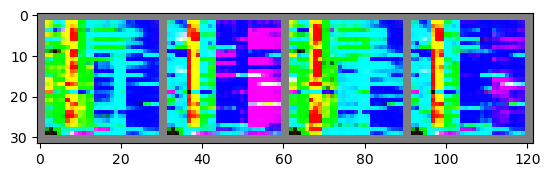

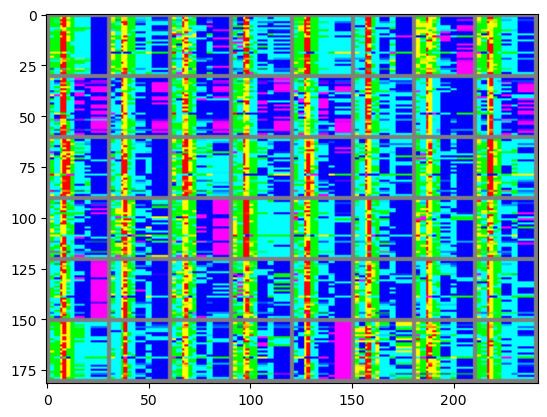

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 830/1000 Total Steps:4155	Loss_D : 0.418550	Loss_G : 1.126370	Loss_D_Mean : 0.342508	Loss_G_Mean : 1.826964	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 831/1000 Total Steps:4160	Loss_D : 0.438123	Loss_G : 1.708750	Loss_D_Mean : 0.395067	Loss_G_Mean : 2.313717	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 832/1000 Total Steps:4165	Loss_D : 0.430391	Loss_G : 1.632256	Loss_D_Mean : 0.373931	Loss_G_Mean : 1.986129	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 833/1000 Total Steps:4170	Loss_D : 0.345229	Loss_G : 1.145772	Loss_D_Mean : 0.544518	Loss_G_Mean : 1.970621	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 834/1000 Total Steps:4175	Loss_D : 0.828883	Loss_G : 1.162350	Loss_D_Mean : 0.454684	Loss_G_Mean : 2.279223	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 835/1000 Total Steps:4180	Loss_D : 0.308675	Loss_G : 2.123736	Loss_D_Mean : 0.326255	Loss_G_Mean : 2.048663	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 836/1000 Total Steps:4185	Loss_D : 0.422416	Loss_G : 1.296513	Loss_D_Mean : 0.425089	Loss_G_Mean : 1.797750	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 837/1000 Total Steps:4190	Loss_D : 0.743642	Loss_G : 3.794033	Loss_D_Mean : 0.519498	Loss_G_Mean : 2.163449	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 838/1000 Total Steps:4195	Loss_D : 0.313440	Loss_G : 1.717862	Loss_D_Mean : 0.609190	Loss_G_Mean : 1.786601	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 839/1000 Total Steps:4200	Loss_D : 0.290992	Loss_G : 1.901555	Loss_D_Mean : 0.390616	Loss_G_Mean : 2.000551	
Epoch: 840


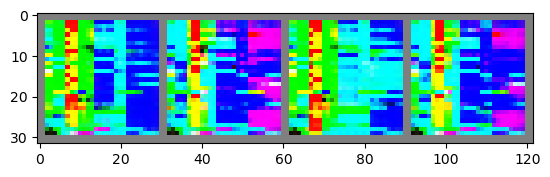

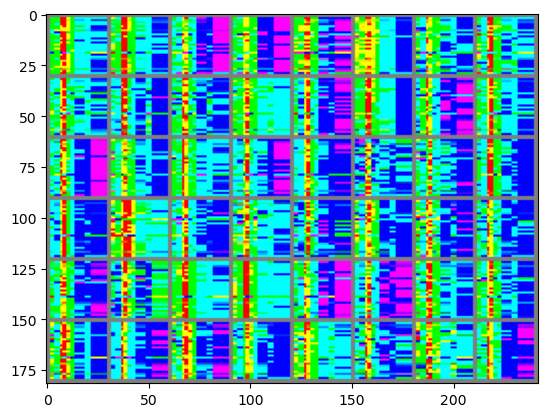

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 840/1000 Total Steps:4205	Loss_D : 0.361829	Loss_G : 1.499841	Loss_D_Mean : 0.366588	Loss_G_Mean : 1.704035	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 841/1000 Total Steps:4210	Loss_D : 0.410120	Loss_G : 1.357542	Loss_D_Mean : 0.377487	Loss_G_Mean : 1.747113	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 842/1000 Total Steps:4215	Loss_D : 0.238399	Loss_G : 3.208146	Loss_D_Mean : 0.434138	Loss_G_Mean : 2.353579	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 843/1000 Total Steps:4220	Loss_D : 0.270856	Loss_G : 1.909224	Loss_D_Mean : 0.306848	Loss_G_Mean : 1.856535	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 844/1000 Total Steps:4225	Loss_D : 0.411765	Loss_G : 1.389875	Loss_D_Mean : 0.378269	Loss_G_Mean : 1.851462	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 845/1000 Total Steps:4230	Loss_D : 0.304388	Loss_G : 2.598472	Loss_D_Mean : 0.380896	Loss_G_Mean : 2.121572	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 846/1000 Total Steps:4235	Loss_D : 0.344961	Loss_G : 1.355122	Loss_D_Mean : 0.400203	Loss_G_Mean : 1.924677	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 847/1000 Total Steps:4240	Loss_D : 0.665794	Loss_G : 1.290079	Loss_D_Mean : 0.549981	Loss_G_Mean : 1.973443	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 848/1000 Total Steps:4245	Loss_D : 0.465785	Loss_G : 1.489484	Loss_D_Mean : 0.497323	Loss_G_Mean : 2.036619	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 849/1000 Total Steps:4250	Loss_D : 0.999645	Loss_G : 1.635968	Loss_D_Mean : 0.496022	Loss_G_Mean : 2.440770	
Epoch: 850


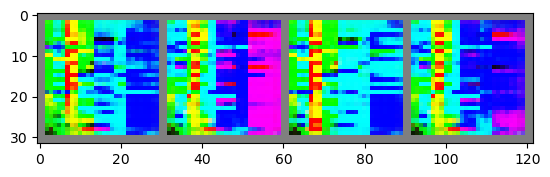

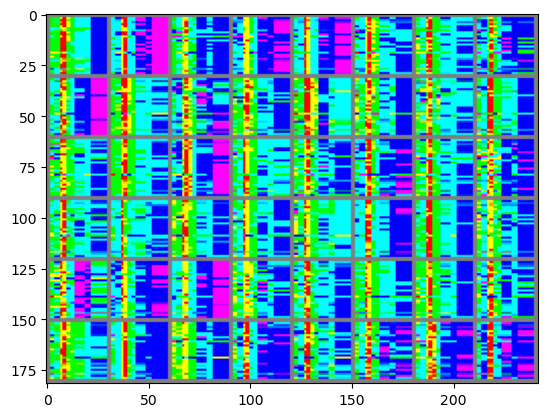

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 850/1000 Total Steps:4255	Loss_D : 0.758876	Loss_G : 3.401597	Loss_D_Mean : 0.660659	Loss_G_Mean : 2.823423	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 851/1000 Total Steps:4260	Loss_D : 0.309769	Loss_G : 2.161278	Loss_D_Mean : 0.257157	Loss_G_Mean : 2.570625	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 852/1000 Total Steps:4265	Loss_D : 0.454526	Loss_G : 1.138345	Loss_D_Mean : 0.435141	Loss_G_Mean : 1.871451	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 853/1000 Total Steps:4270	Loss_D : 0.403124	Loss_G : 1.456892	Loss_D_Mean : 0.353333	Loss_G_Mean : 2.259401	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 854/1000 Total Steps:4275	Loss_D : 0.501837	Loss_G : 1.077760	Loss_D_Mean : 0.344788	Loss_G_Mean : 2.047873	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 855/1000 Total Steps:4280	Loss_D : 0.287726	Loss_G : 2.782206	Loss_D_Mean : 0.345402	Loss_G_Mean : 2.124066	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 856/1000 Total Steps:4285	Loss_D : 0.707022	Loss_G : 1.237902	Loss_D_Mean : 0.572314	Loss_G_Mean : 1.952968	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 857/1000 Total Steps:4290	Loss_D : 0.348102	Loss_G : 2.198648	Loss_D_Mean : 0.375930	Loss_G_Mean : 2.004617	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 858/1000 Total Steps:4295	Loss_D : 0.414276	Loss_G : 1.375723	Loss_D_Mean : 0.386388	Loss_G_Mean : 1.696156	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 859/1000 Total Steps:4300	Loss_D : 0.579123	Loss_G : 3.913177	Loss_D_Mean : 0.421467	Loss_G_Mean : 2.282110	
Epoch: 860


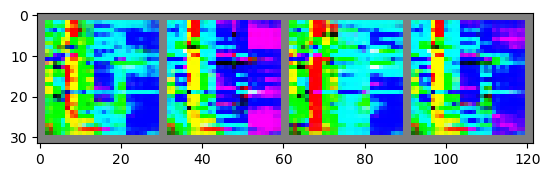

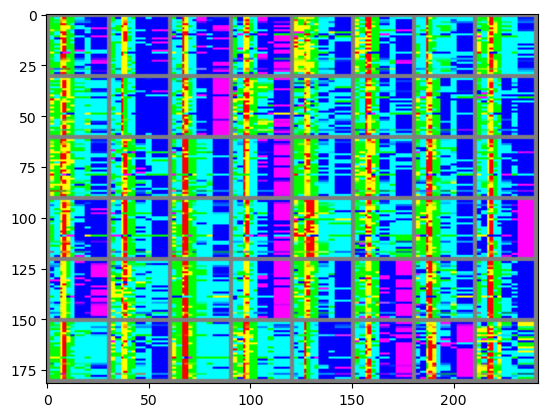

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 860/1000 Total Steps:4305	Loss_D : 0.359042	Loss_G : 1.380061	Loss_D_Mean : 0.665446	Loss_G_Mean : 1.789727	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 861/1000 Total Steps:4310	Loss_D : 0.413423	Loss_G : 1.730261	Loss_D_Mean : 0.355789	Loss_G_Mean : 1.980867	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 862/1000 Total Steps:4315	Loss_D : 0.443518	Loss_G : 3.625173	Loss_D_Mean : 0.408768	Loss_G_Mean : 2.319281	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 863/1000 Total Steps:4320	Loss_D : 0.379103	Loss_G : 1.807069	Loss_D_Mean : 0.526547	Loss_G_Mean : 1.639419	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 864/1000 Total Steps:4325	Loss_D : 0.427136	Loss_G : 0.962477	Loss_D_Mean : 0.402199	Loss_G_Mean : 1.817660	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 865/1000 Total Steps:4330	Loss_D : 0.368228	Loss_G : 1.476771	Loss_D_Mean : 0.541583	Loss_G_Mean : 1.953642	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 866/1000 Total Steps:4335	Loss_D : 0.859355	Loss_G : 3.881000	Loss_D_Mean : 0.473961	Loss_G_Mean : 2.193717	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 867/1000 Total Steps:4340	Loss_D : 0.333752	Loss_G : 1.069278	Loss_D_Mean : 0.422053	Loss_G_Mean : 1.669188	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 868/1000 Total Steps:4345	Loss_D : 0.329929	Loss_G : 1.579720	Loss_D_Mean : 0.323977	Loss_G_Mean : 2.014549	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 869/1000 Total Steps:4350	Loss_D : 0.330290	Loss_G : 2.721034	Loss_D_Mean : 0.306882	Loss_G_Mean : 2.193698	
Epoch: 870


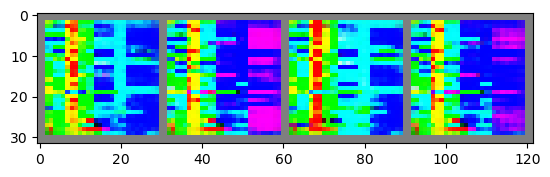

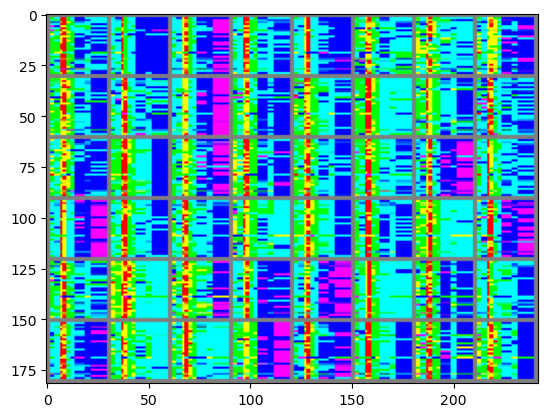

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 870/1000 Total Steps:4355	Loss_D : 0.803430	Loss_G : 4.978302	Loss_D_Mean : 0.468035	Loss_G_Mean : 2.323543	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 871/1000 Total Steps:4360	Loss_D : 0.321245	Loss_G : 2.188235	Loss_D_Mean : 0.507021	Loss_G_Mean : 2.378423	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 872/1000 Total Steps:4365	Loss_D : 0.243483	Loss_G : 2.639237	Loss_D_Mean : 0.243573	Loss_G_Mean : 2.115581	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 873/1000 Total Steps:4370	Loss_D : 0.292128	Loss_G : 1.347504	Loss_D_Mean : 0.271888	Loss_G_Mean : 1.874000	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 874/1000 Total Steps:4375	Loss_D : 0.297371	Loss_G : 2.039718	Loss_D_Mean : 0.364166	Loss_G_Mean : 2.319973	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 875/1000 Total Steps:4380	Loss_D : 0.420507	Loss_G : 2.694600	Loss_D_Mean : 0.366257	Loss_G_Mean : 2.079602	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 876/1000 Total Steps:4385	Loss_D : 0.371125	Loss_G : 1.520456	Loss_D_Mean : 0.436457	Loss_G_Mean : 1.911930	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 877/1000 Total Steps:4390	Loss_D : 0.653616	Loss_G : 1.128569	Loss_D_Mean : 0.544981	Loss_G_Mean : 1.979910	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 878/1000 Total Steps:4395	Loss_D : 0.547299	Loss_G : 2.015717	Loss_D_Mean : 0.487962	Loss_G_Mean : 2.189739	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 879/1000 Total Steps:4400	Loss_D : 0.318080	Loss_G : 1.761844	Loss_D_Mean : 0.271893	Loss_G_Mean : 2.059461	
Epoch: 880


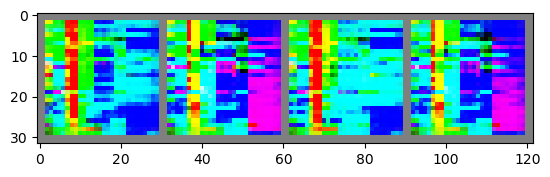

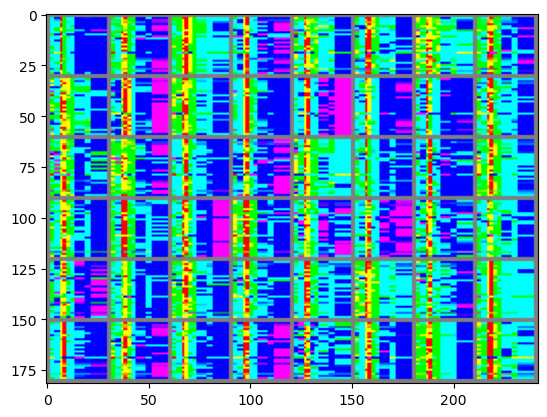

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 880/1000 Total Steps:4405	Loss_D : 0.434435	Loss_G : 2.711605	Loss_D_Mean : 0.354918	Loss_G_Mean : 2.258398	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 881/1000 Total Steps:4410	Loss_D : 0.444256	Loss_G : 3.018968	Loss_D_Mean : 0.415806	Loss_G_Mean : 2.108330	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 882/1000 Total Steps:4415	Loss_D : 0.443503	Loss_G : 2.593048	Loss_D_Mean : 0.386521	Loss_G_Mean : 2.249751	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 883/1000 Total Steps:4420	Loss_D : 0.264839	Loss_G : 2.815490	Loss_D_Mean : 0.483287	Loss_G_Mean : 2.234913	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 884/1000 Total Steps:4425	Loss_D : 0.411456	Loss_G : 2.109041	Loss_D_Mean : 0.377585	Loss_G_Mean : 1.949610	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 885/1000 Total Steps:4430	Loss_D : 0.556176	Loss_G : 1.772474	Loss_D_Mean : 0.512814	Loss_G_Mean : 2.173513	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 886/1000 Total Steps:4435	Loss_D : 0.363089	Loss_G : 3.365997	Loss_D_Mean : 0.289820	Loss_G_Mean : 2.288566	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 887/1000 Total Steps:4440	Loss_D : 0.621656	Loss_G : 4.327214	Loss_D_Mean : 0.506617	Loss_G_Mean : 2.249709	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 888/1000 Total Steps:4445	Loss_D : 0.340964	Loss_G : 3.085546	Loss_D_Mean : 0.415082	Loss_G_Mean : 2.216097	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 889/1000 Total Steps:4450	Loss_D : 0.493269	Loss_G : 1.699988	Loss_D_Mean : 0.471384	Loss_G_Mean : 2.077628	
Epoch: 890


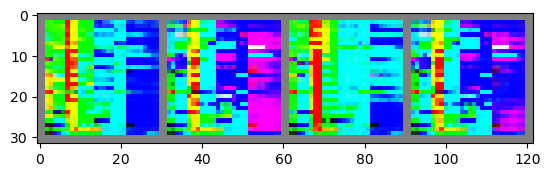

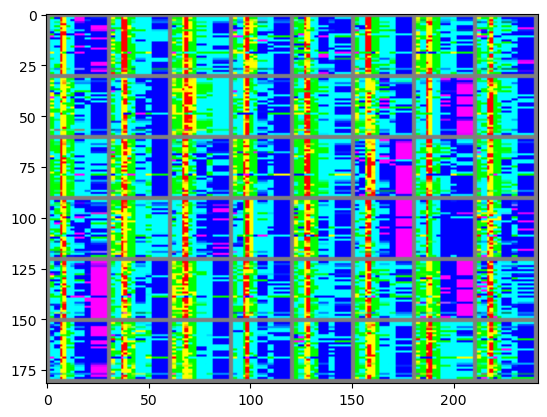

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 890/1000 Total Steps:4455	Loss_D : 0.314062	Loss_G : 2.601370	Loss_D_Mean : 0.285252	Loss_G_Mean : 1.990132	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 891/1000 Total Steps:4460	Loss_D : 0.402211	Loss_G : 1.887318	Loss_D_Mean : 0.626659	Loss_G_Mean : 2.267396	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 892/1000 Total Steps:4465	Loss_D : 0.806852	Loss_G : 1.042526	Loss_D_Mean : 0.462811	Loss_G_Mean : 2.067460	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 893/1000 Total Steps:4470	Loss_D : 0.579280	Loss_G : 1.455179	Loss_D_Mean : 0.573726	Loss_G_Mean : 1.999430	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 894/1000 Total Steps:4475	Loss_D : 0.832284	Loss_G : 3.810956	Loss_D_Mean : 0.505822	Loss_G_Mean : 2.097759	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 895/1000 Total Steps:4480	Loss_D : 0.482012	Loss_G : 0.805520	Loss_D_Mean : 0.589309	Loss_G_Mean : 1.528709	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 896/1000 Total Steps:4485	Loss_D : 0.368467	Loss_G : 2.017267	Loss_D_Mean : 0.438533	Loss_G_Mean : 1.982457	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 897/1000 Total Steps:4490	Loss_D : 0.430820	Loss_G : 1.068593	Loss_D_Mean : 0.368757	Loss_G_Mean : 1.657180	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 898/1000 Total Steps:4495	Loss_D : 0.352872	Loss_G : 2.654660	Loss_D_Mean : 0.352186	Loss_G_Mean : 2.087139	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 899/1000 Total Steps:4500	Loss_D : 0.623574	Loss_G : 2.951122	Loss_D_Mean : 0.487821	Loss_G_Mean : 1.925373	
Epoch: 900


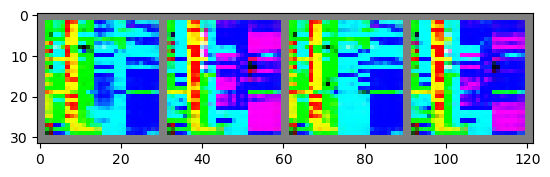

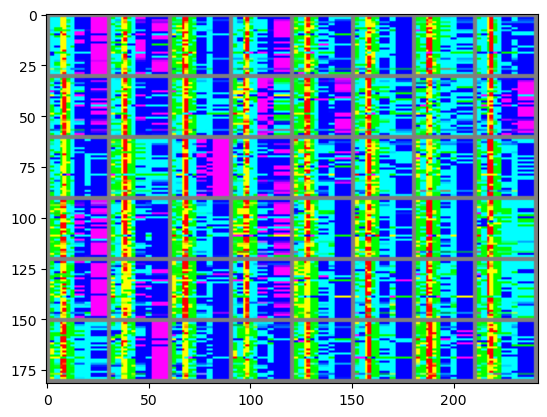

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 900/1000 Total Steps:4505	Loss_D : 0.372195	Loss_G : 1.216981	Loss_D_Mean : 0.337113	Loss_G_Mean : 1.929529	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 901/1000 Total Steps:4510	Loss_D : 0.333655	Loss_G : 1.801296	Loss_D_Mean : 0.308509	Loss_G_Mean : 2.168894	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 902/1000 Total Steps:4515	Loss_D : 0.336781	Loss_G : 2.250057	Loss_D_Mean : 0.310343	Loss_G_Mean : 1.998396	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 903/1000 Total Steps:4520	Loss_D : 0.520857	Loss_G : 3.070979	Loss_D_Mean : 0.431362	Loss_G_Mean : 2.153070	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 904/1000 Total Steps:4525	Loss_D : 0.256380	Loss_G : 1.364937	Loss_D_Mean : 0.258412	Loss_G_Mean : 2.106711	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 905/1000 Total Steps:4530	Loss_D : 0.332592	Loss_G : 3.114597	Loss_D_Mean : 0.478636	Loss_G_Mean : 2.317883	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 906/1000 Total Steps:4535	Loss_D : 0.267578	Loss_G : 2.123288	Loss_D_Mean : 0.490257	Loss_G_Mean : 2.188883	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 907/1000 Total Steps:4540	Loss_D : 0.318883	Loss_G : 1.528365	Loss_D_Mean : 0.314571	Loss_G_Mean : 1.862426	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 908/1000 Total Steps:4545	Loss_D : 0.388257	Loss_G : 1.588031	Loss_D_Mean : 0.429432	Loss_G_Mean : 2.198014	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 909/1000 Total Steps:4550	Loss_D : 1.016081	Loss_G : 4.240490	Loss_D_Mean : 0.594549	Loss_G_Mean : 2.323073	
Epoch: 910


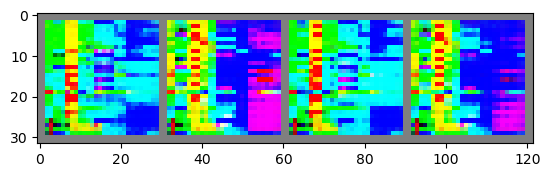

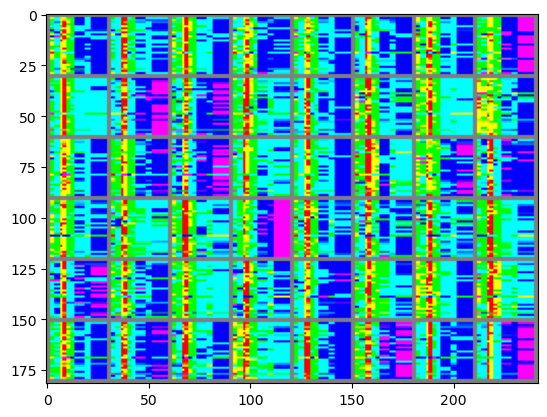

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 910/1000 Total Steps:4555	Loss_D : 0.317275	Loss_G : 1.274770	Loss_D_Mean : 0.529688	Loss_G_Mean : 2.139225	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 911/1000 Total Steps:4560	Loss_D : 0.334262	Loss_G : 1.859643	Loss_D_Mean : 0.471080	Loss_G_Mean : 2.105356	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 912/1000 Total Steps:4565	Loss_D : 0.186480	Loss_G : 3.123336	Loss_D_Mean : 0.217213	Loss_G_Mean : 2.582188	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 913/1000 Total Steps:4570	Loss_D : 0.242310	Loss_G : 3.862761	Loss_D_Mean : 0.164299	Loss_G_Mean : 2.874839	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 914/1000 Total Steps:4575	Loss_D : 0.199749	Loss_G : 1.520215	Loss_D_Mean : 0.341917	Loss_G_Mean : 2.257217	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 915/1000 Total Steps:4580	Loss_D : 0.393686	Loss_G : 1.904414	Loss_D_Mean : 0.319031	Loss_G_Mean : 2.749692	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 916/1000 Total Steps:4585	Loss_D : 0.587036	Loss_G : 3.044356	Loss_D_Mean : 0.453155	Loss_G_Mean : 2.264074	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 917/1000 Total Steps:4590	Loss_D : 0.321135	Loss_G : 1.859712	Loss_D_Mean : 0.335641	Loss_G_Mean : 1.914716	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 918/1000 Total Steps:4595	Loss_D : 0.261198	Loss_G : 2.180589	Loss_D_Mean : 0.402057	Loss_G_Mean : 2.258916	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 919/1000 Total Steps:4600	Loss_D : 0.296319	Loss_G : 1.965634	Loss_D_Mean : 0.296550	Loss_G_Mean : 2.105384	
Epoch: 920


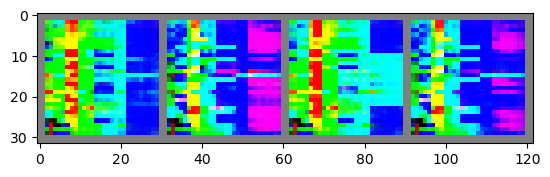

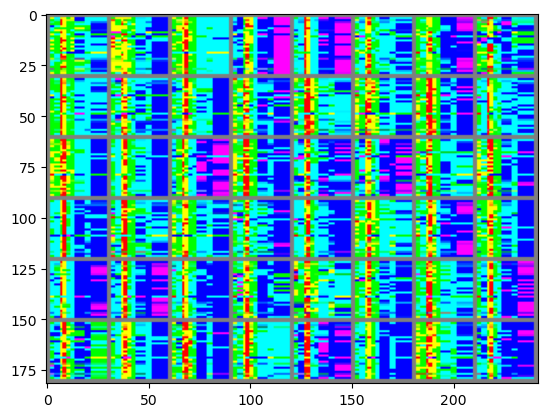

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 920/1000 Total Steps:4605	Loss_D : 0.369108	Loss_G : 1.723682	Loss_D_Mean : 0.361710	Loss_G_Mean : 1.848338	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 921/1000 Total Steps:4610	Loss_D : 0.294790	Loss_G : 0.856446	Loss_D_Mean : 0.627658	Loss_G_Mean : 1.849407	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 922/1000 Total Steps:4615	Loss_D : 0.265338	Loss_G : 3.592994	Loss_D_Mean : 0.355614	Loss_G_Mean : 2.600376	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 923/1000 Total Steps:4620	Loss_D : 0.447377	Loss_G : 2.700807	Loss_D_Mean : 0.479018	Loss_G_Mean : 1.844827	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 924/1000 Total Steps:4625	Loss_D : 0.588443	Loss_G : 0.867553	Loss_D_Mean : 0.495315	Loss_G_Mean : 1.630991	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 925/1000 Total Steps:4630	Loss_D : 0.350705	Loss_G : 2.044132	Loss_D_Mean : 0.483736	Loss_G_Mean : 2.086767	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 926/1000 Total Steps:4635	Loss_D : 0.326928	Loss_G : 2.257197	Loss_D_Mean : 0.505891	Loss_G_Mean : 2.120535	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 927/1000 Total Steps:4640	Loss_D : 0.305860	Loss_G : 2.909933	Loss_D_Mean : 0.332115	Loss_G_Mean : 2.187393	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 928/1000 Total Steps:4645	Loss_D : 0.509189	Loss_G : 3.297891	Loss_D_Mean : 0.518148	Loss_G_Mean : 1.971024	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 929/1000 Total Steps:4650	Loss_D : 0.288976	Loss_G : 1.486606	Loss_D_Mean : 0.296670	Loss_G_Mean : 1.922613	
Epoch: 930


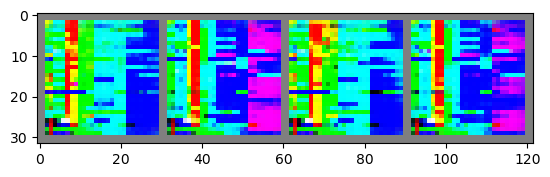

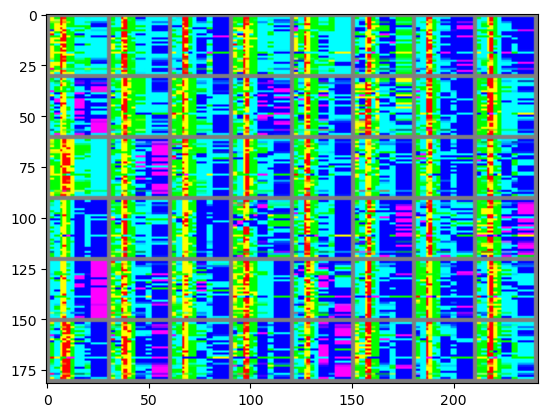

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 930/1000 Total Steps:4655	Loss_D : 0.302712	Loss_G : 2.399451	Loss_D_Mean : 0.310495	Loss_G_Mean : 2.002394	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 931/1000 Total Steps:4660	Loss_D : 0.285890	Loss_G : 1.189184	Loss_D_Mean : 0.295468	Loss_G_Mean : 1.949957	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 932/1000 Total Steps:4665	Loss_D : 0.758787	Loss_G : 3.773530	Loss_D_Mean : 0.398186	Loss_G_Mean : 2.327027	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 933/1000 Total Steps:4670	Loss_D : 0.216129	Loss_G : 1.963996	Loss_D_Mean : 0.317611	Loss_G_Mean : 2.155927	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 934/1000 Total Steps:4675	Loss_D : 0.316137	Loss_G : 1.963665	Loss_D_Mean : 0.312845	Loss_G_Mean : 2.087415	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 935/1000 Total Steps:4680	Loss_D : 0.345802	Loss_G : 0.808411	Loss_D_Mean : 0.304935	Loss_G_Mean : 1.929531	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 936/1000 Total Steps:4685	Loss_D : 0.258511	Loss_G : 2.620802	Loss_D_Mean : 0.321009	Loss_G_Mean : 2.294770	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 937/1000 Total Steps:4690	Loss_D : 0.369960	Loss_G : 1.028085	Loss_D_Mean : 0.303025	Loss_G_Mean : 1.745968	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 938/1000 Total Steps:4695	Loss_D : 0.374344	Loss_G : 1.233454	Loss_D_Mean : 0.380471	Loss_G_Mean : 2.231254	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 939/1000 Total Steps:4700	Loss_D : 0.261577	Loss_G : 2.861532	Loss_D_Mean : 0.338285	Loss_G_Mean : 2.176621	
Epoch: 940


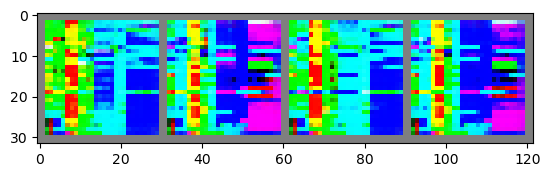

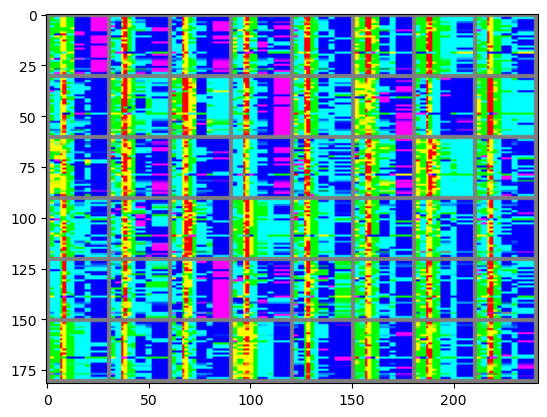

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 940/1000 Total Steps:4705	Loss_D : 0.278851	Loss_G : 2.010573	Loss_D_Mean : 0.311308	Loss_G_Mean : 1.881431	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 941/1000 Total Steps:4710	Loss_D : 0.243061	Loss_G : 2.123451	Loss_D_Mean : 0.447724	Loss_G_Mean : 2.065190	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 942/1000 Total Steps:4715	Loss_D : 0.311194	Loss_G : 2.325697	Loss_D_Mean : 0.279685	Loss_G_Mean : 1.949376	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 943/1000 Total Steps:4720	Loss_D : 0.305490	Loss_G : 2.525994	Loss_D_Mean : 0.464825	Loss_G_Mean : 2.008925	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 944/1000 Total Steps:4725	Loss_D : 0.403873	Loss_G : 2.585421	Loss_D_Mean : 0.373631	Loss_G_Mean : 2.006094	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 945/1000 Total Steps:4730	Loss_D : 0.361206	Loss_G : 2.543796	Loss_D_Mean : 0.512820	Loss_G_Mean : 2.331252	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 946/1000 Total Steps:4735	Loss_D : 0.313880	Loss_G : 1.663667	Loss_D_Mean : 0.319220	Loss_G_Mean : 1.856072	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 947/1000 Total Steps:4740	Loss_D : 0.426236	Loss_G : 1.197247	Loss_D_Mean : 0.395691	Loss_G_Mean : 1.891540	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 948/1000 Total Steps:4745	Loss_D : 0.349980	Loss_G : 1.700698	Loss_D_Mean : 0.318037	Loss_G_Mean : 2.139391	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 949/1000 Total Steps:4750	Loss_D : 0.403307	Loss_G : 1.492644	Loss_D_Mean : 0.407343	Loss_G_Mean : 1.786628	
Epoch: 950


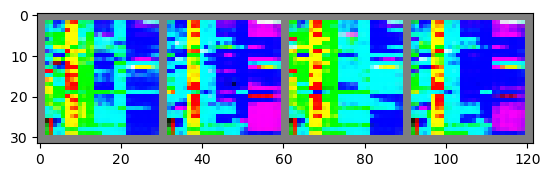

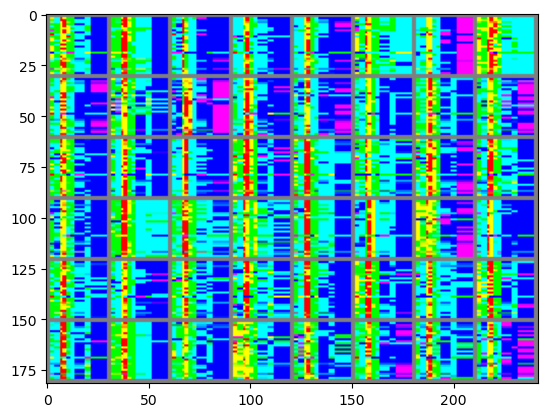

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 950/1000 Total Steps:4755	Loss_D : 0.373740	Loss_G : 2.492680	Loss_D_Mean : 0.405254	Loss_G_Mean : 2.032994	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 951/1000 Total Steps:4760	Loss_D : 1.397100	Loss_G : 2.511622	Loss_D_Mean : 0.605722	Loss_G_Mean : 1.793330	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 952/1000 Total Steps:4765	Loss_D : 0.453015	Loss_G : 2.312653	Loss_D_Mean : 0.605727	Loss_G_Mean : 1.699251	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 953/1000 Total Steps:4770	Loss_D : 0.813356	Loss_G : 0.714335	Loss_D_Mean : 0.493602	Loss_G_Mean : 1.772985	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 954/1000 Total Steps:4775	Loss_D : 0.340313	Loss_G : 3.486748	Loss_D_Mean : 0.443211	Loss_G_Mean : 2.308647	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 955/1000 Total Steps:4780	Loss_D : 0.545821	Loss_G : 2.470167	Loss_D_Mean : 0.593260	Loss_G_Mean : 1.773969	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 956/1000 Total Steps:4785	Loss_D : 0.388028	Loss_G : 1.286849	Loss_D_Mean : 0.441566	Loss_G_Mean : 1.918943	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 957/1000 Total Steps:4790	Loss_D : 0.292572	Loss_G : 2.390431	Loss_D_Mean : 0.325973	Loss_G_Mean : 1.910603	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 958/1000 Total Steps:4795	Loss_D : 0.887257	Loss_G : 3.683228	Loss_D_Mean : 0.477301	Loss_G_Mean : 1.867614	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 959/1000 Total Steps:4800	Loss_D : 0.258573	Loss_G : 1.453820	Loss_D_Mean : 0.544550	Loss_G_Mean : 1.578799	
Epoch: 960


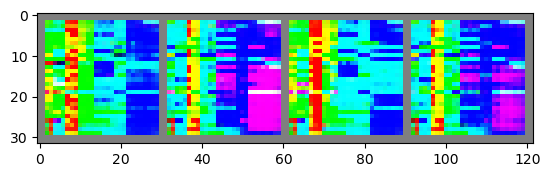

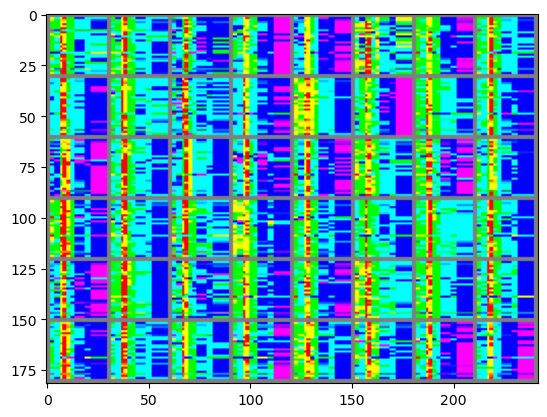

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 960/1000 Total Steps:4805	Loss_D : 0.332779	Loss_G : 1.732931	Loss_D_Mean : 0.327053	Loss_G_Mean : 1.883209	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 961/1000 Total Steps:4810	Loss_D : 0.297526	Loss_G : 1.971800	Loss_D_Mean : 0.310223	Loss_G_Mean : 1.769732	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 962/1000 Total Steps:4815	Loss_D : 0.655158	Loss_G : 3.824400	Loss_D_Mean : 0.410460	Loss_G_Mean : 2.303256	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 963/1000 Total Steps:4820	Loss_D : 0.560675	Loss_G : 2.775064	Loss_D_Mean : 0.596168	Loss_G_Mean : 1.930832	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 964/1000 Total Steps:4825	Loss_D : 0.356374	Loss_G : 2.012609	Loss_D_Mean : 0.369106	Loss_G_Mean : 1.785079	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 965/1000 Total Steps:4830	Loss_D : 0.640561	Loss_G : 3.142011	Loss_D_Mean : 0.793898	Loss_G_Mean : 2.554078	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 966/1000 Total Steps:4835	Loss_D : 0.299221	Loss_G : 2.037271	Loss_D_Mean : 0.361344	Loss_G_Mean : 1.811720	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 967/1000 Total Steps:4840	Loss_D : 0.422354	Loss_G : 1.849529	Loss_D_Mean : 0.372013	Loss_G_Mean : 1.735102	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 968/1000 Total Steps:4845	Loss_D : 0.433806	Loss_G : 2.664757	Loss_D_Mean : 0.427644	Loss_G_Mean : 1.727922	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 969/1000 Total Steps:4850	Loss_D : 0.322748	Loss_G : 1.575820	Loss_D_Mean : 0.314587	Loss_G_Mean : 1.811497	
Epoch: 970


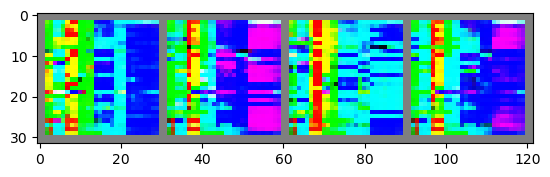

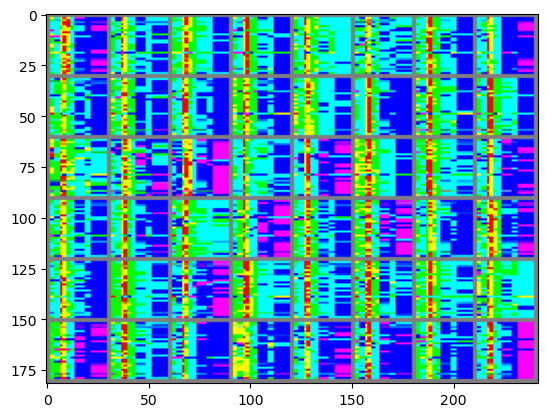

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 970/1000 Total Steps:4855	Loss_D : 0.314497	Loss_G : 2.309679	Loss_D_Mean : 0.326091	Loss_G_Mean : 1.834699	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 971/1000 Total Steps:4860	Loss_D : 0.346051	Loss_G : 1.221828	Loss_D_Mean : 0.308928	Loss_G_Mean : 1.829745	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 972/1000 Total Steps:4865	Loss_D : 0.376030	Loss_G : 2.452784	Loss_D_Mean : 0.313227	Loss_G_Mean : 1.905275	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 973/1000 Total Steps:4870	Loss_D : 0.323691	Loss_G : 1.718731	Loss_D_Mean : 0.374296	Loss_G_Mean : 1.951896	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 974/1000 Total Steps:4875	Loss_D : 0.265599	Loss_G : 3.385340	Loss_D_Mean : 0.266578	Loss_G_Mean : 2.106650	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 975/1000 Total Steps:4880	Loss_D : 0.288016	Loss_G : 2.536047	Loss_D_Mean : 0.326754	Loss_G_Mean : 1.988774	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 976/1000 Total Steps:4885	Loss_D : 0.495528	Loss_G : 2.455698	Loss_D_Mean : 0.489665	Loss_G_Mean : 2.146423	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 977/1000 Total Steps:4890	Loss_D : 0.289411	Loss_G : 3.033523	Loss_D_Mean : 0.285894	Loss_G_Mean : 2.272589	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 978/1000 Total Steps:4895	Loss_D : 0.302176	Loss_G : 2.360255	Loss_D_Mean : 0.416301	Loss_G_Mean : 1.838254	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 979/1000 Total Steps:4900	Loss_D : 0.271907	Loss_G : 1.408927	Loss_D_Mean : 0.318518	Loss_G_Mean : 1.909731	
Epoch: 980


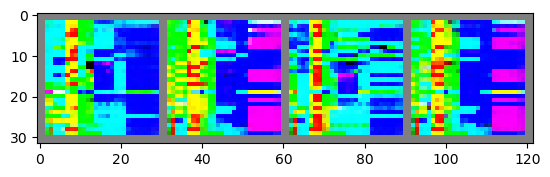

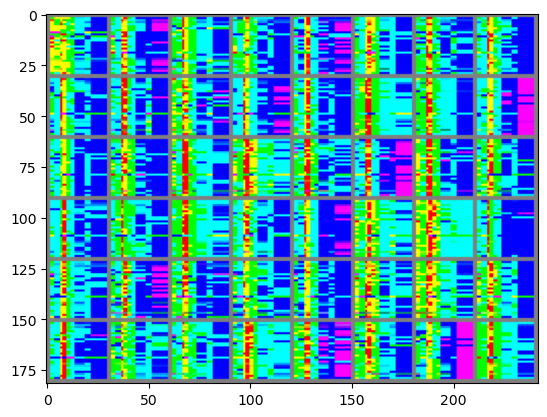

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 980/1000 Total Steps:4905	Loss_D : 0.397284	Loss_G : 1.400786	Loss_D_Mean : 0.330735	Loss_G_Mean : 2.009584	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 981/1000 Total Steps:4910	Loss_D : 0.518265	Loss_G : 2.818915	Loss_D_Mean : 0.326816	Loss_G_Mean : 2.133653	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 982/1000 Total Steps:4915	Loss_D : 0.450644	Loss_G : 2.524373	Loss_D_Mean : 0.426846	Loss_G_Mean : 1.901199	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 983/1000 Total Steps:4920	Loss_D : 0.284807	Loss_G : 1.613453	Loss_D_Mean : 0.356785	Loss_G_Mean : 2.002412	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 984/1000 Total Steps:4925	Loss_D : 0.350033	Loss_G : 1.426194	Loss_D_Mean : 0.299425	Loss_G_Mean : 2.048003	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 985/1000 Total Steps:4930	Loss_D : 0.604729	Loss_G : 1.455988	Loss_D_Mean : 0.447690	Loss_G_Mean : 2.144241	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 986/1000 Total Steps:4935	Loss_D : 0.309901	Loss_G : 2.235662	Loss_D_Mean : 0.399118	Loss_G_Mean : 2.121081	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 987/1000 Total Steps:4940	Loss_D : 0.417242	Loss_G : 2.021374	Loss_D_Mean : 0.436224	Loss_G_Mean : 2.121842	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 988/1000 Total Steps:4945	Loss_D : 0.839340	Loss_G : 1.099192	Loss_D_Mean : 0.562388	Loss_G_Mean : 1.958435	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 989/1000 Total Steps:4950	Loss_D : 0.284381	Loss_G : 2.003991	Loss_D_Mean : 0.334379	Loss_G_Mean : 1.986742	
Epoch: 990


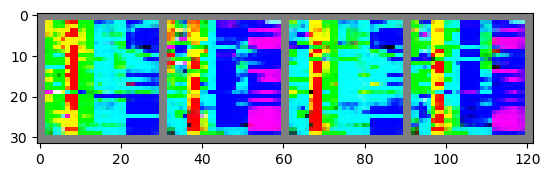

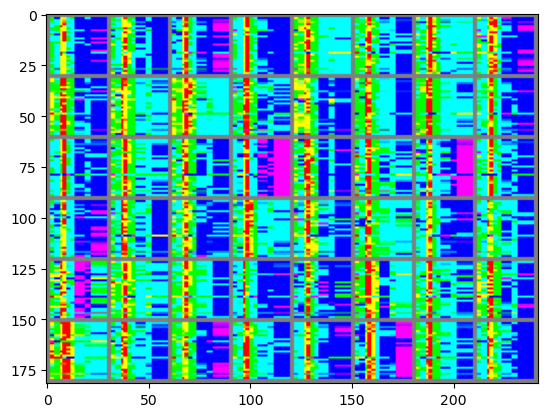

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 990/1000 Total Steps:4955	Loss_D : 0.330639	Loss_G : 3.220876	Loss_D_Mean : 0.422794	Loss_G_Mean : 2.090141	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 991/1000 Total Steps:4960	Loss_D : 0.423149	Loss_G : 1.850945	Loss_D_Mean : 0.436286	Loss_G_Mean : 1.763178	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 992/1000 Total Steps:4965	Loss_D : 1.042427	Loss_G : 0.951795	Loss_D_Mean : 0.520802	Loss_G_Mean : 2.021656	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 993/1000 Total Steps:4970	Loss_D : 0.422382	Loss_G : 1.493421	Loss_D_Mean : 0.456417	Loss_G_Mean : 1.752906	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 994/1000 Total Steps:4975	Loss_D : 0.331786	Loss_G : 1.587970	Loss_D_Mean : 0.326833	Loss_G_Mean : 1.668758	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 995/1000 Total Steps:4980	Loss_D : 0.384407	Loss_G : 1.011179	Loss_D_Mean : 0.334972	Loss_G_Mean : 1.773125	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 996/1000 Total Steps:4985	Loss_D : 0.544497	Loss_G : 2.738620	Loss_D_Mean : 0.371215	Loss_G_Mean : 2.017961	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 997/1000 Total Steps:4990	Loss_D : 0.386093	Loss_G : 1.789152	Loss_D_Mean : 0.371713	Loss_G_Mean : 1.644464	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 998/1000 Total Steps:4995	Loss_D : 0.864748	Loss_G : 0.836496	Loss_D_Mean : 0.520842	Loss_G_Mean : 1.756494	


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 999/1000 Total Steps:5000	Loss_D : 0.915621	Loss_G : 0.966036	Loss_D_Mean : 0.541501	Loss_G_Mean : 1.903368	
Epoch: 1000


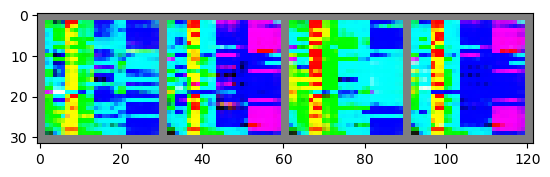

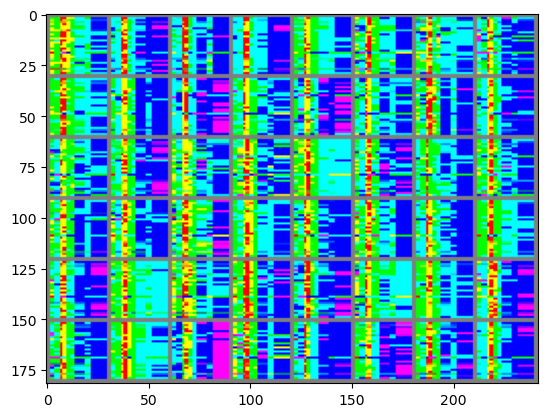

In [26]:
for epoch in range(n_epochs):

    cur_step = 0

    for real, labels in tqdm(train_loader):

        cur_batch_size = len(real)
        z_dim= 4

        real = real.to(device)



        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)

        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])
        ## discriminator train step
        disc_opt.zero_grad()
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        #print(one_hot_labels)

        noise_and_labels =  combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))

        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step()


        discriminator_losses += [disc_loss.item()]

        ## generator train step
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)

        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()

        gen_opt.step()

        generator_losses += [gen_loss.item()]

        cur_step += 1
        total_steps += 1

        print_val = f"Epoch: {epoch}/{n_epochs} Steps:{cur_step}/{len(train_loader)}\t"
        print_val += f"Loss_D : {disc_loss.item():.6f}\t"
        print_val += f"Loss_G : {gen_loss.item():.6f}\t"
        print(print_val, end='\r',flush = True)
    gen_mean = sum(generator_losses[-cur_step:]) / cur_step
    disc_mean = sum(discriminator_losses[-cur_step:]) / cur_step

    D_mean_losses.append(disc_mean)
    G_mean_losses.append(gen_mean)

    print_val = f"Epoch: {epoch}/{n_epochs} Total Steps:{total_steps}\t"
    print_val += f"Loss_D : {disc_loss.item():.6f}\t"
    print_val += f"Loss_G : {gen_loss.item():.6f}\t"
    print_val += f"Loss_D_Mean : {disc_mean:.6f}\t"
    print_val += f"Loss_G_Mean : {gen_mean:.6f}\t"
    print(print_val)


    fake = gen(fixed_noise_and_labels)

    if (epoch+1) %10 == 0:
        print(f"Epoch: {epoch+1}")
        imshow_grid(fake, show_fig=True, epoch=epoch)
        imshow_grid(real, show_fig=True, epoch=epoch)
    cur_step = 0

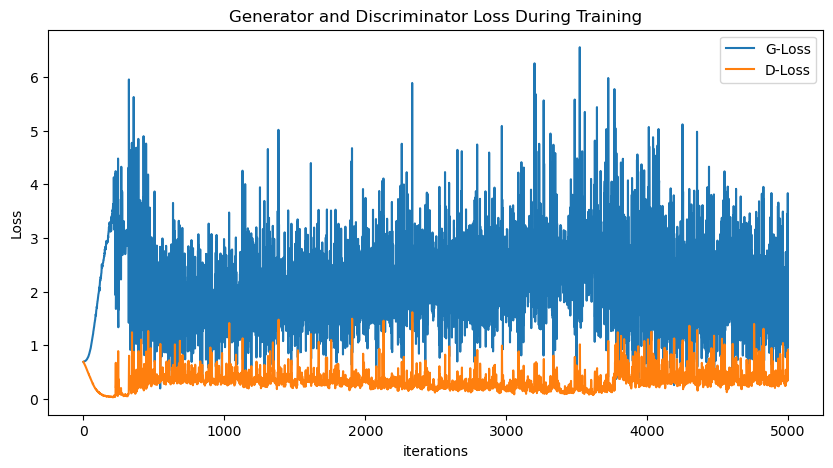

In [27]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(generator_losses,label="G-Loss")
plt.plot(discriminator_losses,label="D-Loss")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

## 4. Generate fake samples

In [28]:
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

torch.manual_seed(random_seed)

### Healty controls

In [29]:
with torch.no_grad():
    fixed_noise = torch.randn(50, 50, device=device)
    #label = torch.randint(0,2,(100,), device=device)
    label = [0 for _ in range(50)]
    label = torch.as_tensor(label)
    one_hot_labels = get_one_hot_labels(label.to(device), n_classes)
    #label = torch.as_tensor(one_hot_labels).to(device)


        ## discriminator train step
    disc_opt.zero_grad()
    fake_noise = get_noise(50,4, device=device)

    noise_and_labels =  combine_vectors(fake_noise, one_hot_labels)
    #print(one_hot_labels)
    fake = gen(noise_and_labels)



In [30]:
dir_name_01='C:/Users/232STG21/Documents/EEG/cDCGAN_50/raw+gan건강우울/train/0.Healthy controls'
dir_name_02='C:/Users/232STG21/Documents/EEG/cDCGAN_50/raw+gan건강조울/train/0.Healthy controls'
dir_name_03='C:/Users/232STG21/Documents/EEG/cDCGAN_50/raw+gan건강조현/train/0.Healthy controls'
for ii in range(50):
    #plt.subplot(10,10,ii+1)
    #plt.imshow(to_pil_image(0.5*fake[ii]+0.5))
    img=to_pil_image(0.5*fake[ii]+0.5)
    img.save(os.path.join(dir_name_01, 'CGAN_fake_samples{}.png').format(ii))#.format(ii+1))
    img.save(os.path.join(dir_name_02, 'CGAN_fake_samples{}.png').format(ii))#.format(ii+1))
    img.save(os.path.join(dir_name_03, 'CGAN_fake_samples{}.png').format(ii))#.format(ii+1))

### Bipolar disorder

In [31]:
with torch.no_grad():
    fixed_noise = torch.randn(50, 50, device=device)
    #label = torch.randint(0,2,(100,), device=device)
    label = [1 for _ in range(50)]
    label = torch.as_tensor(label)
    one_hot_labels = get_one_hot_labels(label.to(device), n_classes)
    #label = torch.as_tensor(one_hot_labels).to(device)


        ## discriminator train step
    disc_opt.zero_grad()
    fake_noise = get_noise(50,4, device=device)

    noise_and_labels =  combine_vectors(fake_noise, one_hot_labels)
    #print(one_hot_labels)
    fake = gen(noise_and_labels)


In [32]:
dir_name_1='C:/Users/232STG21/Documents/EEG/cDCGAN_50/raw+gan건강조울/train/1.Bipolar disorder'
for ii in range(50):
    #plt.subplot(10,10,ii+1)
    #plt.imshow(to_pil_image(0.5*fake[ii]+0.5)) #이미지 정규화 시 적용해야함.
    img=to_pil_image(0.5*fake[ii]+0.5)
    img.save(os.path.join(dir_name_1, 'CGAN_fake_samples{}.png').format(ii))#.format(ii+1))

### Major depressive disorder

In [33]:
with torch.no_grad():
    fixed_noise = torch.randn(50, 50, device=device)
    #label = torch.randint(0,2,(100,), device=device)
    label = [2 for _ in range(50)]
    label = torch.as_tensor(label)
    one_hot_labels = get_one_hot_labels(label.to(device), n_classes)
    #label = torch.as_tensor(one_hot_labels).to(device)


        ## discriminator train step
    disc_opt.zero_grad()
    fake_noise = get_noise(50,4, device=device)

    noise_and_labels =  combine_vectors(fake_noise, one_hot_labels)
    #print(one_hot_labels)
    fake = gen(noise_and_labels)


In [34]:
dir_name_2='C:/Users/232STG21/Documents/EEG/cDCGAN_50/raw+gan건강우울/train/1.Major depressive disorder'
for ii in range(50):
    #plt.subplot(10,10,ii+1)
    #plt.imshow(to_pil_image(0.5*fake[ii]+0.5))
    img=to_pil_image(0.5*fake[ii]+0.5)
    img.save(os.path.join(dir_name_2, 'CGAN_fake_samples{}.png').format(ii))#.format(ii+1))

### Schizophrenia

In [35]:
with torch.no_grad():
    fixed_noise = torch.randn(50, 50, device=device)
    #label = torch.randint(0,2,(100,), device=device)
    label = [3 for _ in range(50)]
    label = torch.as_tensor(label)
    one_hot_labels = get_one_hot_labels(label.to(device), n_classes)
    #label = torch.as_tensor(one_hot_labels).to(device)


        ## discriminator train step
    disc_opt.zero_grad()
    fake_noise = get_noise(50,4, device=device)

    noise_and_labels =  combine_vectors(fake_noise, one_hot_labels)
    #print(one_hot_labels)
    fake = gen(noise_and_labels)


In [36]:
dir_name_3='C:/Users/232STG21/Documents/EEG/cDCGAN_50/raw+gan건강조현/train/1.Schizophrenia'
for ii in range(50):
    #plt.subplot(10,10,ii+1)
    #plt.imshow(to_pil_image(0.5*fake[ii]+0.5))
    img=to_pil_image(0.5*fake[ii]+0.5)
    img.save(os.path.join(dir_name_3, 'CGAN_fake_samples{}.png').format(ii))#.format(ii+1))